In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torchvision import datasets
from scipy.stats import gaussian_kde

## Generator

#### Original VAE

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class VAE(nn.Module):
    def __init__(self, z_dim=256, im_chan=2):
        super(VAE, self).__init__()
        self.z_dim = z_dim
        self.hidden_dim = int(z_dim // 8)

        # Encoder
        self.encoder = nn.Sequential(
            self.make_encoder_block(im_chan, self.hidden_dim * 2, kernel_size=4, stride=2, padding=1),  # (2, 8, 32) -> (hidden * 2, 4, 16)
            self.make_encoder_block(self.hidden_dim * 2, self.hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # (hidden * 2, 4, 16) -> (hidden * 4, 2, 8)
            self.make_encoder_block(self.hidden_dim * 4, self.hidden_dim * 8, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 2, 8) -> (hidden * 4, 1, 4)
            self.make_encoder_block(self.hidden_dim * 8, self.hidden_dim * 8, kernel_size=4, stride=2, padding=0),  # (hidden * 4, 1, 4) -> (hidden * 4, 1, 1)
        )
        self.fc_mu = nn.Linear(self.hidden_dim * 8, z_dim)
        self.fc_logvar = nn.Linear(self.hidden_dim * 8, z_dim)

        # Decoder
        self.decoder = nn.Sequential(
            self.make_decoder_block(self.hidden_dim * 8, self.hidden_dim * 8, kernel_size=4, stride=2, padding=0),  # (hidden * 4, 1, 1) -> (hidden * 4, 1, 4)
            self.make_decoder_block(self.hidden_dim * 8, self.hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 1, 4) -> (hidden * 4, 2, 8)
            self.make_decoder_block(self.hidden_dim * 4, self.hidden_dim * 2, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 2, 8) -> (hidden * 2, 4, 16)
            self.make_decoder_block(self.hidden_dim * 2, im_chan, kernel_size=4, stride=2, padding=1, final_layer=True),  # (hidden * 2, 4, 16) -> (2, 8, 32)
        )

    def make_encoder_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def make_decoder_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding),
                nn.Tanh(),  # Output in the range [-1, 1]
            )

    def encode(self, x):
        output_encoder = self.encoder(x)
        output_encoder = output_encoder.view(output_encoder.size(0), -1)
        return self.fc_mu(output_encoder), self.fc_logvar(output_encoder), output_encoder

    def reparameterize(self, mu, logvar):

        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)

        z_latent = mu + eps * std

        return z_latent

    def decode(self, z):
        h = z.view(z.size(0), -1, 1, 1)
        return self.decoder(h)

    def forward(self, x, *args):
        mu, logvar, output_encoder = self.encode(x)

        z = self.reparameterize(mu, logvar)

        return self.decode(z), mu, logvar, (z, output_encoder)


In [3]:
from torchsummary import summary

vae = VAE(z_dim=256).cuda()

summary(vae, (2, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           2,112
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4            [-1, 128, 8, 8]         131,200
       BatchNorm2d-5            [-1, 128, 8, 8]             256
         LeakyReLU-6            [-1, 128, 8, 8]               0
            Conv2d-7            [-1, 256, 4, 4]         524,544
       BatchNorm2d-8            [-1, 256, 4, 4]             512
         LeakyReLU-9            [-1, 256, 4, 4]               0
           Conv2d-10            [-1, 256, 1, 1]       1,048,832
      BatchNorm2d-11            [-1, 256, 1, 1]             512
        LeakyReLU-12            [-1, 256, 1, 1]               0
           Linear-13                  [-1, 256]          65,792
           Linear-14                  [

## Discriminator

In [4]:
import torch
import torch.nn as nn

class Critic(nn.Module):
    def __init__(self, im_chan=2, hidden_dim=64):
        super(Critic, self).__init__()
        self.critic = nn.Sequential(
            self.make_critic_block(im_chan, hidden_dim, kernel_size=4, stride=2, padding=1),     # 2x32x32 -> 64x16x16
            self.make_critic_block(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1), # 64x16x16 -> 128x8x8
            self.make_critic_block(hidden_dim * 2, hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # 128x8x8 -> 256x4x4
        )
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(hidden_dim * 4, 1)

    def make_critic_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1):
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, image):
        critic_pred = self.critic(image)
        critic_pred = self.avg_pool(critic_pred)
        critic_pred = critic_pred.view(critic_pred.size(0), -1)
        critic_pred = self.fc(critic_pred)
        return critic_pred

In [5]:
from torchsummary import summary

d_1 = Critic().cuda()
summary(d_1, (2, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           2,112
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4            [-1, 128, 8, 8]         131,200
       BatchNorm2d-5            [-1, 128, 8, 8]             256
         LeakyReLU-6            [-1, 128, 8, 8]               0
            Conv2d-7            [-1, 256, 4, 4]         524,544
       BatchNorm2d-8            [-1, 256, 4, 4]             512
         LeakyReLU-9            [-1, 256, 4, 4]               0
AdaptiveAvgPool2d-10            [-1, 256, 1, 1]               0
           Linear-11                    [-1, 1]             257
Total params: 659,009
Trainable params: 659,009
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.01
Forward/

## Loss function


In [6]:
def l2_loss(fake, real):
    return torch.norm(fake - real, p=2)

In [7]:
# Assuming the VAE loss function is defined as follows:
def vae_loss(recon_x, x, mu, logvar, *args):
    recon_loss = l2_loss(recon_x, x)
    kl_div = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return recon_loss + 0.1 * kl_div, recon_loss, kl_div

## Initial Process

### Hyperarameters

In [8]:
n_epochs = 100
z_dim = 256
batch_size = 256
lr = 0.002
betas = (0.5, 0.999)
c_lambda = 10
critic_repeats = 3
device = 'cuda'
n_workers = 4

### Dataset

In [9]:
import gdown
import pickle

def download_and_load_pkl(url, output='output.pkl'):
    # Download the pickle file from Google Drive
    gdown.download(url, output, quiet=False)

    # Load the pickle file
    with open(output, 'rb') as f:
        data = pickle.load(f)

    return data

In [11]:
# channel sionna, pilot sionna 20000 samples with the same topology 4 ant
channels = download_and_load_pkl('https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv', output='channels_res.pkl')
responses = download_and_load_pkl('https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x', output='y_res.pkl')

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv
From (redirected): https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv&confirm=t&uuid=7f62f7cb-2186-4b06-9b83-3874e419d4c9
To: /content/channels_res.pkl
100%|██████████| 328M/328M [00:03<00:00, 90.5MB/s]
Downloading...
From (original): https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x
From (redirected): https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x&confirm=t&uuid=165db036-ce98-43b4-9b99-8cf1204b0066
To: /content/y_res.pkl
100%|██████████| 328M/328M [00:04<00:00, 81.3MB/s]


In [14]:
channels.shape

(20000, 4, 8, 32, 2)

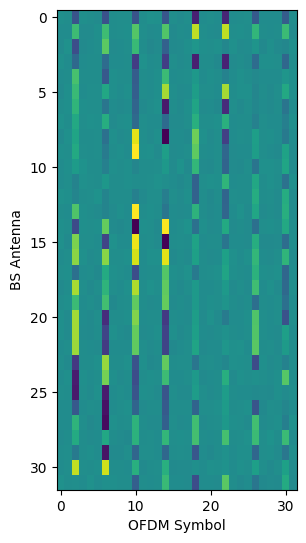

In [15]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 6))  # Adjust the figsize to make the plot height much greater than the width

# Assuming x_signal is a 2D array
# Display the array as an image
plt.imshow(responses[0].reshape(-1, 32, 2).transpose(1,0,2)[:,:,0], cmap='viridis', aspect='auto')
# Set labels for the axes
plt.xlabel('OFDM Symbol')
plt.ylabel('BS Antenna')
# Adjust subplot parameters to fit the figure area
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Show the plot
plt.show()

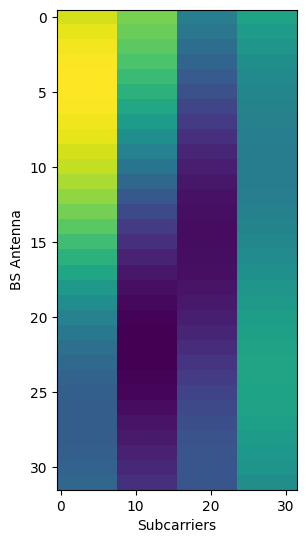

In [16]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 6))  # Adjust the figsize to make the plot height much greater than the width

# Assuming x_signal is a 2D array
# Display the array as an image
plt.imshow(channels[1].reshape(-1, 32, 2).transpose(1,0,2)[:,:,0], cmap='viridis', aspect='auto')
# Set labels for the axes
plt.xlabel('Subcarriers')
plt.ylabel('BS Antenna')
# Adjust subplot parameters to fit the figure area
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Show the plot
plt.show()

In [17]:
import torch
import torchvision.transforms as transforms
from torch.utils.data.dataloader import DataLoader
import numpy as np


def sign(x: np.ndarray):
    x[x < 0] = -1
    x[x > 0] = 1
    return x

class ChannelsData(torch.utils.data.Dataset):
    def __init__(
        self, channels_res: np.ndarray, y_res: np.ndarray, type_data: str = "train"
    ):
        self.len_dataset = channels_res.shape[0]

        self.transform_channel = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        self.transform_y_signal = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        ratio = 4/5  # Using 0.8 instead of 4/5 for better readability
        eval_ratio = 0.5  # Ratio for splitting the remaining data between eval and test

        if type_data == "train":
            # Get first 80% of data for training
            self.channels_res = channels_res[:int(self.len_dataset * ratio)]
            self.y_res = y_res[:int(self.len_dataset * ratio)]
        elif type_data == "eval":
            # Get first half of remaining 20% for evaluation
            start_idx = int(self.len_dataset * ratio)
            end_idx = start_idx + int(self.len_dataset * (1 - ratio) * eval_ratio)
            self.channels_res = channels_res[start_idx:end_idx]
            self.y_res = y_res[start_idx:end_idx]
        else:  # test data
            # Get second half of remaining 20% for testing
            start_idx = int(self.len_dataset * ratio) + int(self.len_dataset * (1 - ratio) * eval_ratio)
            self.channels_res = channels_res[start_idx:]
            self.y_res = y_res[start_idx:]

    def preprocess_response(self, y_res):
        normalized_y_res = np.zeros_like(y_res)
        for i in range(len(y_res)):
            y_res_i = y_res[i]
            y_res_i = (y_res_i - y_res_i.min()) / (y_res_i.max() - y_res_i.min())
            y_res_i = 2 * y_res_i - 1
            normalized_y_res[i] = y_res_i


        normalized_y_res = normalized_y_res.reshape(32, 32, 2).transpose(1,0,2)
        return normalized_y_res

    def preprocess_chanel(self, channel_res):
        normalized_channel_res = np.zeros_like(channel_res)
        for i in range(len(channel_res)):
            channel_res_i = channel_res[i]
            channel_res_i = (channel_res_i - channel_res_i.min()) / (channel_res_i.max() - channel_res_i.min())
            channel_res_i = 2 * channel_res_i - 1
            normalized_channel_res[i] = channel_res_i

        normalized_channel_res = normalized_channel_res.reshape(32, 32, 2).transpose(1,0,2)
        return normalized_channel_res

    def __getitem__(self, item):
        channel_res = self.channels_res[item]
        y_res = self.y_res[item]

        channel_res = self.preprocess_chanel(channel_res)
        y_res = self.preprocess_response(y_res)

        item_channel_res = torch.FloatTensor(channel_res).permute(2, 0, 1)
        item_y_res = torch.FloatTensor(y_res).permute(2, 0, 1)

        return item_channel_res, item_y_res

    def __len__(self):
        return len(self.channels_res)


class ChannelDataloader:
    def __init__(
        self,
        channels_res: np.ndarray,
        y_res: np.ndarray,
        batch_size: int = 64,
        pin_memory: bool = False,
        num_worker: int = 1,
    ):
        self.channels_res = channels_res
        self.y_res = y_res
        self.batch_size = batch_size
        self.pin_memory = pin_memory
        self.num_worker = num_worker

    def train_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="train",
            ),
            batch_size=self.batch_size,
            pin_memory=self.pin_memory,
            shuffle=True,
            num_workers=self.num_worker,
        )

    def test_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="test",
            ),
            batch_size=1,
            pin_memory=self.pin_memory,
            num_workers=self.num_worker,
            shuffle=False,
        )

    def eval_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="eval",
            ),
            batch_size=1,
            pin_memory=self.pin_memory,
            num_workers=self.num_worker,
            shuffle=True,
        )


In [18]:
dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=batch_size, num_worker=n_workers
)
train_dataset = dataloader.train_dataloader()
eval_dataset = dataloader.eval_dataloader()

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


### Model

Each model, we need to initialize weighs which help model converge faster, and prevent the vanishing and exploding gradient at eh first time .

In [19]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

### Visualization

In [20]:
def show_tensor_images(image_tensor):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_grid = image_tensor.detach().cpu()
    plt.imshow(image_grid.squeeze())
    plt.show()
    plt.close()

def show_loss_images(c_losses = None, g_losses = None):
    plt.figure(figsize=(10, 5))
    if c_losses:
      plt.plot(c_losses, label="Discriminator Loss", linestyle='-', linewidth=2)
    if g_losses:
      plt.plot(g_losses, label="Generator Loss", linestyle='-', linewidth=2)
    plt.title("GAN Training Losses")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()


def show_nmse(nmse_scores):
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(nmse_scores)), nmse_scores, marker='o', linestyle='-', color='b', label='NMSE')
    plt.title('Normalized Mean Squared Error (NMSE) vs Prediction Set', fontsize=14)
    plt.xlabel('Prediction Set', fontsize=12)
    plt.ylabel('NMSE', fontsize=12)
    plt.grid(True)
    plt.legend()
    plt.show()
    plt.close()

In [21]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde


def plot_distribution(
    c_real,
    c_fake,
    g_fake,
    c_real_threshold=None,
    c_fake_threshold=None,
    g_fake_threshold=None,
    save_path=None,
):
    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))

    # Histogram plot
    ax1.hist(c_real, bins=30, alpha=0.5, label="Real Critic")
    ax1.hist(c_fake, bins=30, alpha=0.5, label="Fake Critic")
    ax1.hist(g_fake, bins=30, alpha=0.5, label="Fake Generator")
    if c_real_threshold:
        ax1.axvline(
            c_real_threshold,
            color="r",
            linestyle="--",
            label="Threshold for Real Critic",
        )
    if c_fake_threshold:
        ax1.axvline(
            c_fake_threshold,
            color="g",
            linestyle="--",
            label="Threshold for Fake Critic",
        )
    if g_fake_threshold:
        ax1.axvline(
            g_fake_threshold,
            color="b",
            linestyle="--",
            label="Threshold for Fake Generator",
        )
    ax1.set_title("Histogram of Distributions with Thresholds")
    ax1.set_xlabel("Value")
    ax1.set_ylabel("Frequency")
    ax1.legend()

    # KDE plot
    kde_c_real = gaussian_kde(c_real)
    kde_c_fake = gaussian_kde(c_fake)
    kde_g_fake = gaussian_kde(g_fake)

    x_range = np.linspace(
        min(c_real.min(), c_fake.min(), g_fake.min()),
        max(c_real.max(), c_fake.max(), g_fake.max()),
        200,
    )

    ax2.plot(x_range, kde_c_real(x_range), label="Real Critic")
    ax2.plot(x_range, kde_c_fake(x_range), label="Fake Critic")
    ax2.plot(x_range, kde_g_fake(x_range), label="Fake Generator")
    if c_real_threshold:
        ax1.axvline(
            c_real_threshold,
            color="r",
            linestyle="--",
            label="Threshold for Real Critic",
        )
    if c_fake_threshold:
        ax1.axvline(
            c_fake_threshold,
            color="g",
            linestyle="--",
            label="Threshold for Fake Critic",
        )
    if g_fake_threshold:
        ax1.axvline(
            g_fake_threshold,
            color="b",
            linestyle="--",
            label="Threshold for Fake Generator",
        )
    ax2.set_title("Kernel Density Estimation of Distributions with Thresholds")
    ax2.set_xlabel("Value")
    ax2.set_ylabel("Density")
    ax2.legend()

    plt.tight_layout()

    # save file
    if save_path:
        if not os.path.exists(save_path):
            os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path)

    plt.show()
    plt.close()

In [22]:
def plot_vae_in_out(input_tensor, output, z, encoder_output, true_output):
    # Convert to numpy arrays
    encoder_input_np = input_tensor.detach().cpu().numpy().flatten()
    encoder_output_np = encoder_output.detach().cpu().numpy().flatten()
    decoder_input_np = z.detach().cpu().numpy().flatten()
    decoder_output_np = output.detach().cpu().numpy().flatten()
    true_output_np = true_output.detach().cpu().numpy().flatten()

    # Create a figure with five subplots in a single row
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(20, 4))
    fig.patch.set_facecolor('#2F2F2F')

    # Define the data and labels for each subplot
    data = [encoder_input_np, encoder_output_np, decoder_input_np, decoder_output_np, true_output_np]
    titles = ["Encoder Input", "Encoder Output", "Decoder Input (Latent Space)", "Decoder Output", "True Output"]
    shapes = [input_tensor.shape, encoder_output.shape, z.shape, output.shape, true_output.shape]
    colors = ['cyan', 'magenta', 'yellow', 'green', 'red']
    axes = [ax1, ax2, ax3, ax4, ax5]

    for ax, d, title, shape, color in zip(axes, data, titles, shapes, colors):
        kde = gaussian_kde(d)
        x_range = np.linspace(d.min(), d.max(), 200)

        ax.plot(x_range, kde(x_range), color=color)
        ax.fill_between(x_range, kde(x_range), alpha=0.5, color=color)

        ax.set_title(f"{title}\nShape: {shape}", color='white', fontsize=16)
        ax.set_xlabel("Value", color='white', fontsize=12)
        ax.set_ylabel("Density", color='white', fontsize=12)

        ax.grid(color='gray', linestyle='--', alpha=0.3)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_color('white')
        ax.spines['left'].set_color('white')
        ax.tick_params(colors='white')

    plt.tight_layout()
    plt.show()
    plt.close()


In [23]:
import os

import matplotlib.pyplot as plt
import numpy as np


def plot_generated_image(prediction, test_input, tar, t=0, prefix: str = "wgan"):

    test_input = test_input.cpu().detach().numpy().squeeze()
    prediction = prediction.cpu().detach().numpy().squeeze()
    tar = tar.cpu().detach().numpy().squeeze()

    display_list = [
        np.squeeze(test_input),
        np.squeeze(tar),
        np.squeeze(prediction),
    ]
    title = ["Input Y", "Target H", "Prediction H"]

    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis("off")

    img_path = os.path.join("results/generated_img", prefix, "img_" + str(t) + ".png")

    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()


def plot_skewness_func(skewness_scores, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, skewness_scores, label="Target")
    plt.xlabel("Epoch")
    plt.ylabel("Skewness distances")
    plt.title("Skewness Loss")
    plt.legend()
    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()

def plot_nmse_func(mse_scores, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, mse_scores, label="Target")
    plt.xlabel("Epoch")
    plt.ylabel("MSE")
    plt.title("MSE Scores")
    plt.legend()
    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()


def plot_loss_func(losses_d = None, losses_g = None, epochs = None, img_path = None):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    if losses_d:
      plt.plot(epochs, losses_d, label="Discriminator Loss")
    if losses_g:
      plt.plot(epochs, losses_g, label="Generator Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Loss Curves")
    plt.legend()

    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()

#### Discriminator Activation Mapping

In [24]:
import os
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable


class Hook:
    def __init__(self, module):
        self.stored = None
        module.register_forward_hook(self.hook_fn)

    def hook_fn(self, module, input, output):
        # Store the forward activations
        self.stored = output.detach()


class HookBwd:
    def __init__(self, module):
        self.stored = None
        module.register_full_backward_hook(self.hook_fn)

    def hook_fn(self, module, grad_input, grad_output):
        # Store the gradients during the backward pass
        self.stored = grad_output[0].detach()


class GradCam:
    def __init__(self, model, conv_layer):
        self.model = model

        self.hook_activation = Hook(conv_layer)
        self.hook_gradient = HookBwd(conv_layer)

    def compute_activation_map(self, image):

        output = self.model(image)

        # because in our case ciritic is a single value so it is not possible to get the target class
        output.backward()

        # Retrieve stored activations and gradients
        activations = self.hook_activation.stored
        gradients = self.hook_gradient.stored

        # get importance weights of the gradients
        importance_weights = gradients.mean(dim=[2, 3], keepdim=True)

        # Multiply the importance weights with the activations
        weighted_activations = (
            importance_weights * activations
        )  # Element-wise multiplication

        # Get activation map by summing the weighted activations
        activation_map = weighted_activations.sum(dim=1)

        # Apply ReLU to remove negative values
        activation_map = F.relu(activation_map)

        # normalize the activation map
        activation_map = activation_map.cpu().detach().numpy()  # Convert to numpy
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min()
        )  # Normalize

        return activation_map

    def visualize_cam(self, image, save_path=None):
        # Compute the activation map
        activation_map = self.compute_activation_map(image)

        # Get the first image and activation map
        activation_map = activation_map.squeeze(0)
        image = image.squeeze(0)

        # Normalize the image
        image = (
            image.cpu().numpy().transpose(1, 2, 0)
        )  # Shape: [height, width, channels]
        image = (image - image.min()) / (image.max() - image.min())

        real_image = image[:, :, 0]


        # Plot the images side by side
        fig, axs = plt.subplots(1, 3, figsize=(12, 6))

        # Plot the original image
        axs[0].imshow(real_image, alpha=0.9,)
        axs[0].axis("off")
        axs[0].set_title("Input Image")

        # Plot heatmap
        im = axs[1].imshow(
            activation_map,
            alpha=0.4,
            cmap="jet",
            extent=(0, image.shape[1], image.shape[0], 0),
            interpolation="bilinear",
        )
        axs[1].axis("off")
        axs[1].set_title("Activation Map")

        # Plot the overlay image
        axs[2].imshow(
            real_image, aspect="auto", alpha=0.9
        )  # Set higher alpha for real_image
        axs[2].imshow(
            activation_map,
            alpha=0.6,
            cmap="jet",
            extent=(0, image.shape[1], image.shape[0], 0),
            interpolation="bilinear",
        )
        axs[2].axis("off")
        axs[2].set_title("Activation Map Overlay")

        # set color bar
        divider = make_axes_locatable(axs[1])
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

        # save file
        if save_path:
            if not os.path.exists(save_path):
                os.makedirs(os.path.dirname(save_path), exist_ok=True)
            plt.savefig(save_path)
            np.save(save_path.replace(".png", ".npy"), activation_map)

        plt.show()
        plt.close()


class ScoreCam(GradCam):
    def __init__(self, model, conv_layer):
        super(ScoreCam, self).__init__(model, conv_layer)

    def compute_activation_map(self, image):
        # Forward pass to get activation maps
        _ = self.model(image)
        activations = self.hook_activation.stored

        # Upsample activations to match input size
        upsampled = F.interpolate(
            activations, size=image.shape[2:], mode="bilinear", align_corners=False
        )

        # Normalize each activation map
        normalized = torch.zeros_like(upsampled)
        for i in range(upsampled.shape[1]):
            normalized[:, i, :, :] = (
                upsampled[:, i, :, :] - upsampled[:, i, :, :].min()
            ) / (upsampled[:, i, :, :].max() - upsampled[:, i, :, :].min() + 1e-8)

        # Compute scores for each activation map
        scores = []
        for i in range(normalized.shape[1]):
            masked_input = image * normalized[:, i, :, :].unsqueeze(1)
            output = self.model(masked_input)
            scores.append(output.detach().cpu().numpy())

        scores = np.array(scores)

        # Weight the activation maps by their scores
        weighted_activations = (
            torch.tensor(scores, device=activations.device).unsqueeze(0) * activations
        ).sum(dim=1)

        # Apply ReLU and normalize
        activation_map = F.relu(weighted_activations)
        activation_map = activation_map.cpu().detach().numpy()
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min() + 1e-8
        )

        return activation_map

    def visualize_cam(self, image, save_path=None):
        return super().visualize_cam(image, save_path)


class EigenCam(GradCam):
    def __init__(self, model, conv_layer):
        super(EigenCam, self).__init__(model, conv_layer)

    def compute_activation_map(self, image):
        """
        Computes EigenCAM activation map using the eigenvector from the activations' covariance matrix.
        """
        # Step 1: Forward pass to get activation maps
        _ = self.model(image)
        activations = (
            self.hook_activation.stored
        )  # [batch_size, channels, height, width]

        # Step 2: Reshape activations to 2D (batch, channels, width*height)
        activations = activations.view(
            activations.size(0), activations.size(1), -1
        )  # [batch_size, channels, width*height]

        # Step 3: Compute the covariance matrix for each activation map (batch-wise)
        # Using torch.bmm for batch-wise matrix multiplication of activations and their transpose
        cov_matrix = torch.bmm(
            activations, activations.transpose(1, 2)
        )  # [batch_size, channels, channels]

        # Step 4: Move to CPU for eigenvalue computation (or stay on GPU if desired)
        cov_matrix = cov_matrix.cpu().detach().numpy()

        # Step 5: Compute eigenvalues and eigenvectors (using NumPy as PyTorch doesn't have batch-wise eigenvalue decomposition)
        eigenvalues, eigenvectors = np.linalg.eigh(
            cov_matrix
        )  # Eigenvalue decomposition for each sample in batch

        # Step 6: Use the eigenvector corresponding to the largest eigenvalue
        # The last eigenvector corresponds to the largest eigenvalue because they are sorted in ascending order
        largest_eigenvector = eigenvectors[..., -1]  # [batch_size, channels]

        # Convert eigenvector back to PyTorch and move to same device as the input image
        largest_eigenvector = torch.from_numpy(largest_eigenvector).to(
            image.device
        )  # [batch_size, channels]
        largest_eigenvector = torch.abs(largest_eigenvector)  # Take the absolute value

        # Step 7: Weight the activations by the largest eigenvector
        # Unsqueeze to match the activation dimensions, then apply weighting
        weighted_activations = activations * largest_eigenvector.unsqueeze(
            -1
        )  # [batch_size, channels, width*height]

        # Step 8: Sum across channels to get a single activation map
        activation_map = weighted_activations.sum(dim=1)  # [batch_size, width*height]

        # Step 9: Reshape back to original spatial dimensions (height, width)
        activation_map = activation_map.view(
            activations.size(0),
            self.hook_activation.stored.size(2),
            self.hook_activation.stored.size(3),
        )  # [batch_size, height, width]

        # Step 10: Apply ReLU and normalize the activation map
        activation_map = F.relu(activation_map)
        activation_map = activation_map.cpu().detach().numpy()

        # Normalize the heatmap to be between 0 and 1
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min() + 1e-8
        )

        return activation_map

    def visualize_cam(self, image, save_path=None):
        return super().visualize_cam(image, save_path)

### Evaluate

In [25]:
def nmse_func(pred, target):
    """
    Compute the Normalized Mean Squared Error (NMSE) between two tensors.

    Args:
        pred (torch.Tensor): Predicted tensor.
        target (torch.Tensor): Ground truth tensor (target).

    Returns:
        float: The NMSE value.
    """
    # Compute the Mean Squared Error (MSE)
    mse = torch.mean((pred - target) ** 2)

    # Compute the norm of the target tensor
    norm = torch.mean(target ** 2)

    # NMSE is the ratio of MSE to the norm of the target
    nmse_value = mse / norm

    return nmse_value.item()

In [26]:
def save_checkpoint(model, file_name):
    model_to_save = {
        "state_dict": model.state_dict(),
    }
    if not os.path.exists(file_name):
        os.makedirs(os.path.dirname(file_name), exist_ok=True)
    torch.save(model_to_save, file_name)


def save_npy(file_name, np_array):
    if not os.path.exists(file_name):
        os.makedirs(os.path.dirname(file_name), exist_ok=True)
    np.save(file_name, np_array)

### Training Steps

In [27]:
# before compute the gradient penalty, we need compute the gradient of interpolated image
def get_gradient(critic, real, fake, epsilon, *args):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        critic: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = critic(mixed_images, *args)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


# then we compute the gradient penalty
def gradient_penalty_loss(critic, real, fake, *args):

    # get epsilon value
    epsilon = torch.rand(len(real), 1, 1, 1, device=real.device, requires_grad=True)

    # Compute the gradient
    gradient = get_gradient(critic, real, fake, epsilon, *args)

    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)

    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm - 1)**2)
    return penalty

In [28]:
import torch
from scipy import stats
import numpy as np

class SkewCalculator:
    def __init__(self, device=None):
        self.device = device if device is not None else torch.device("cuda" if torch.cuda.is_available() else "cpu")

    def __call__(self, tensor):
        """
        Compute skewness of a PyTorch tensor with flexible shape.
        If the tensor is multi-dimensional, computes skewness along the first dimension.

        :param tensor: PyTorch tensor of any shape
        :return: PyTorch tensor containing skewness value(s)
        """
        # Ensure input is a PyTorch tensor
        if not isinstance(tensor, torch.Tensor):
            tensor = torch.tensor(tensor, dtype=torch.float32, device=self.device)

        # Move tensor to CPU and convert to numpy for scipy
        numpy_array = tensor.detach().cpu().numpy()

        # Compute skewness along the first dimension
        if numpy_array.ndim == 1:
            skewness = stats.skew(numpy_array, axis=0, bias=False)

            if np.isnan(skewness):
                skewness = 0.0
        else:
            skewness = stats.skew(numpy_array, axis=1, bias=False)


        # Convert back to PyTorch tensor and move to original device
        return torch.tensor(skewness, dtype=torch.float32, device=self.device)

## VAE

In [29]:
vae = VAE(z_dim=z_dim).to(device)

# Initialize weights
vae = vae.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
vae_opt = torch.optim.Adam(vae.parameters(), lr=lr, betas=betas)

In [30]:
def channel_est_vae_multi_antenna():
    save_results = "channel_est_based_vae_multi_antenna"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        g_skewness = 0
        nmse_scores = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_generator_fakes = []

        vae.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]

            vae_opt.zero_grad()

            # get noise
            # Forward pass
            fake, *values = vae(label)

            # Compute loss
            v_loss, *values = vae_loss(fake, real, *values)


            g_loss = v_loss


            # Update gradients
            g_loss.backward()

            # Update the weights
            vae_opt.step()

            g_losses += g_loss.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - vae loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse_func(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))


        print(f"\tEpoch {epoch} - vae loss: {total_g_losses[-1]}")

        vae.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake, *values = vae(label)
                _, _, (input_decoder, output_encoder) = values
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:].T)
            show_tensor_images(real[0,0,:,:].T)
            show_loss_images(total_c_losses, total_g_losses)

            plot_vae_in_out(label, fake, input_decoder, output_encoder, real)



        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            save_checkpoint(vae, f"results/checkpoint/{save_results}/g_model.pt")
            plot_generated_image(
                fake[0,0,:,:].T,
                test_input=label[0,0,:,:].T,
                tar=real[0,0,:,:].T,
                prefix=save_results,
            )
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            None,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] - vae loss:  495.8969421386719
Batch [21/63] - vae loss:  489.6164620139382
Batch [42/63] - vae loss:  488.56364121547966
	Epoch 0 - vae loss: 486.6785830543155


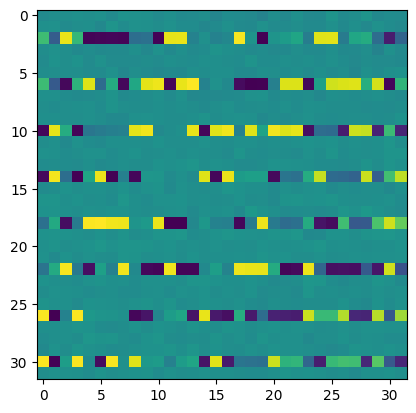

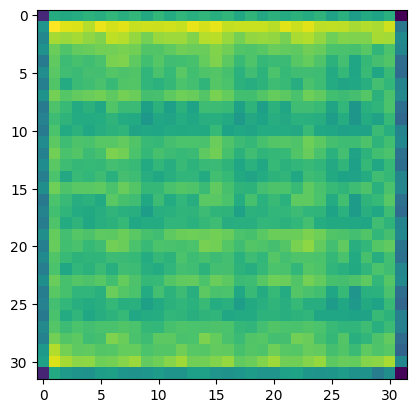

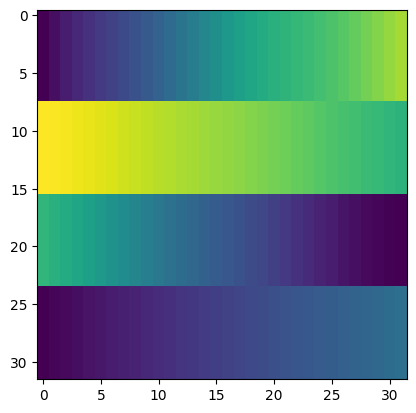

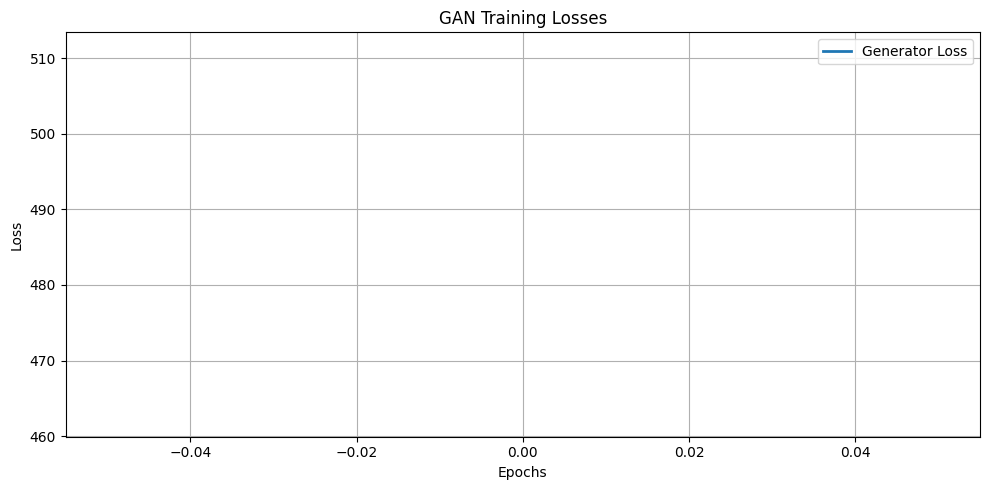

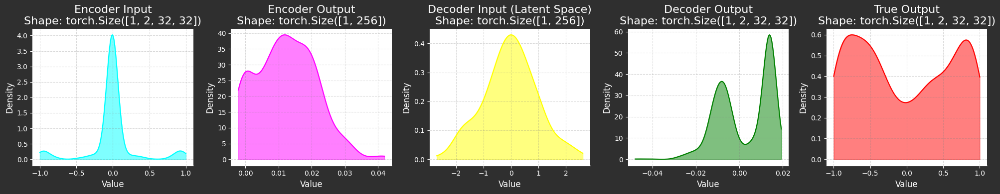

	MNSE Score: 1.0014936734759619
Batch [0/63] - vae loss:  488.1634521484375
Batch [21/63] - vae loss:  488.171049638228
Batch [42/63] - vae loss:  488.7883825967478
	Epoch 1 - vae loss: 486.05506388346356
	MNSE Score: 1.0002419409297763
Batch [0/63] - vae loss:  484.0854797363281
Batch [21/63] - vae loss:  487.7217296253551
Batch [42/63] - vae loss:  487.82290294558504
	Epoch 2 - vae loss: 486.05611649770583
Batch [0/63] - vae loss:  491.7979431152344
Batch [21/63] - vae loss:  489.0720700350675
Batch [42/63] - vae loss:  488.6923423589662
	Epoch 3 - vae loss: 486.0645979623946
Batch [0/63] - vae loss:  492.1584167480469
Batch [21/63] - vae loss:  488.7298778187145
Batch [42/63] - vae loss:  488.3816790913427
	Epoch 4 - vae loss: 486.0309070405506
	MNSE Score: 1.000179424172356
Batch [0/63] - vae loss:  486.2898864746094
Batch [21/63] - vae loss:  487.85831798206675
Batch [42/63] - vae loss:  488.0624744503997
	Epoch 5 - vae loss: 486.01290602911087
	MNSE Score: 1.0001393376834808
Batc

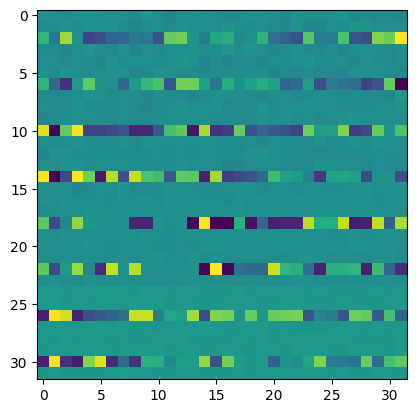

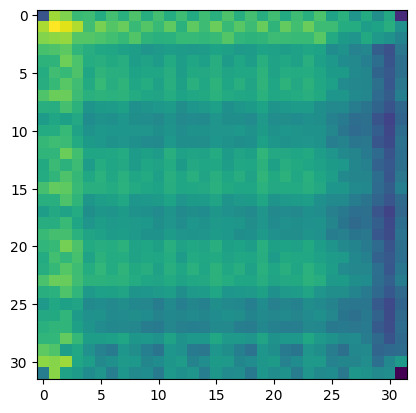

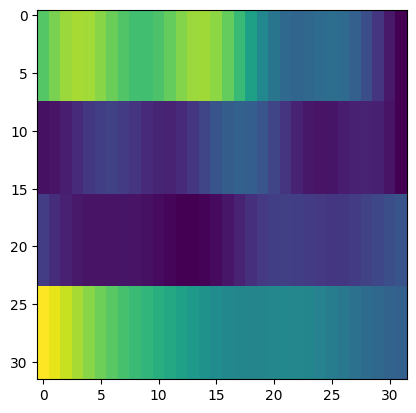

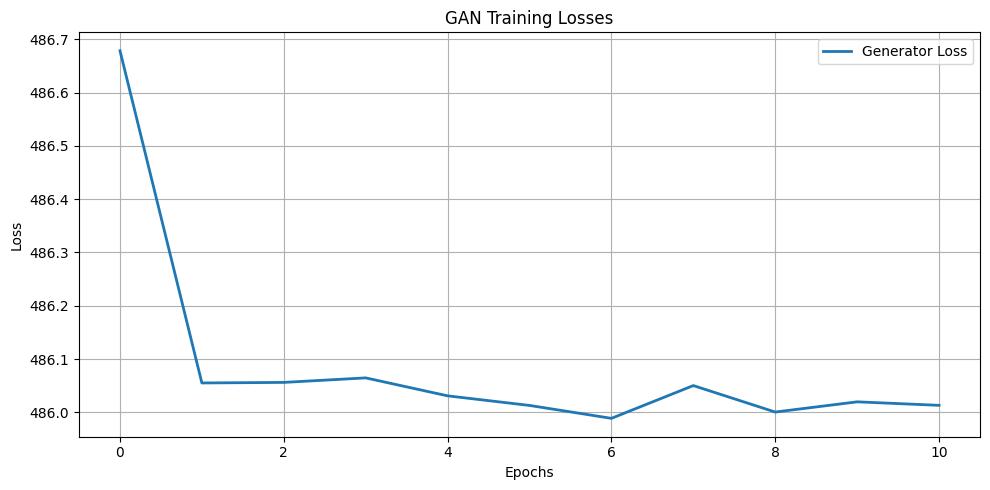

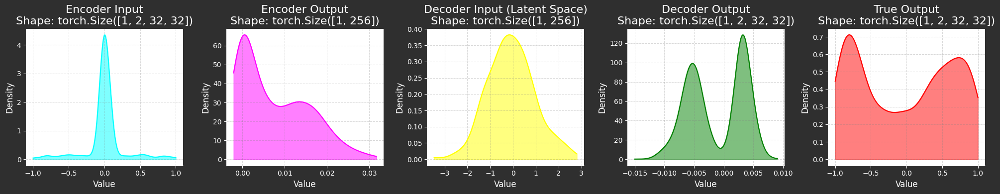

Batch [0/63] - vae loss:  489.7969055175781
Batch [21/63] - vae loss:  487.7631003639915
Batch [42/63] - vae loss:  488.3158242868823
	Epoch 11 - vae loss: 486.0406445700025
	MNSE Score: 1.0000825060738459
Batch [0/63] - vae loss:  491.10528564453125
Batch [21/63] - vae loss:  488.7275959361683
Batch [42/63] - vae loss:  488.2524598587391
	Epoch 12 - vae loss: 486.03277878534226
	MNSE Score: 1.0000702880677723
Batch [0/63] - vae loss:  488.69012451171875
Batch [21/63] - vae loss:  489.2633972167969
Batch [42/63] - vae loss:  488.7495862384175
	Epoch 13 - vae loss: 486.00011044456846
Batch [0/63] - vae loss:  491.2064514160156
Batch [21/63] - vae loss:  488.5020779696378
Batch [42/63] - vae loss:  487.8660037018532
	Epoch 14 - vae loss: 485.9937022375682
	MNSE Score: 1.000058268743848
Batch [0/63] - vae loss:  488.8951721191406
Batch [21/63] - vae loss:  487.2641310258345
Batch [42/63] - vae loss:  488.33742008652797
	Epoch 15 - vae loss: 486.02391948397195
Batch [0/63] - vae loss:  485

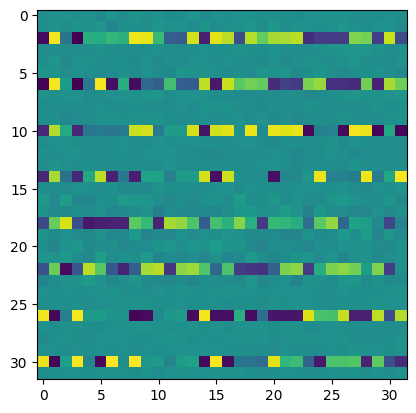

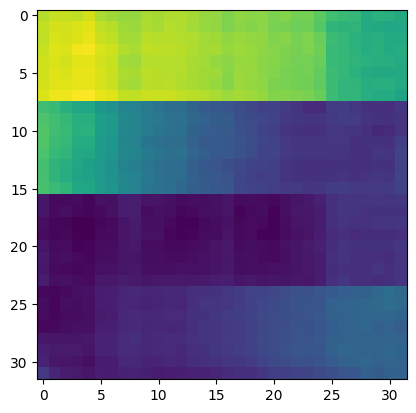

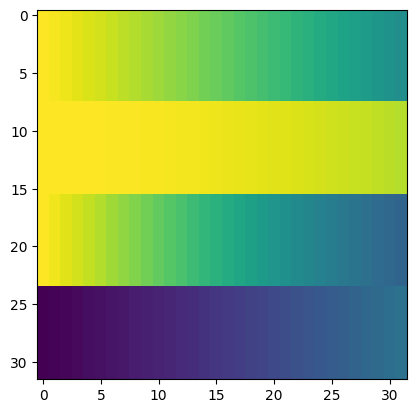

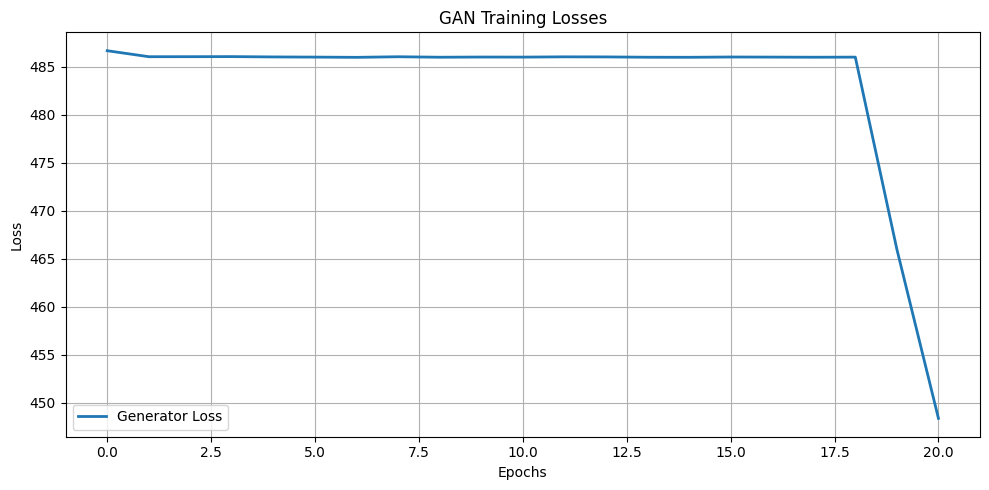

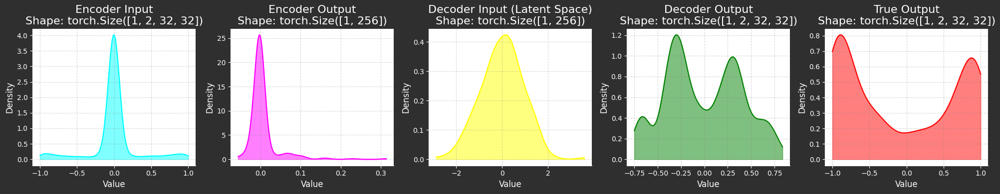

	MNSE Score: 0.6739184260368347
Batch [0/63] - vae loss:  453.75909423828125
Batch [21/63] - vae loss:  449.4417252974077
Batch [42/63] - vae loss:  449.1166317961937
	Epoch 21 - vae loss: 446.14246816483757
	MNSE Score: 0.6600630728025285
Batch [0/63] - vae loss:  452.4844055175781
Batch [21/63] - vae loss:  446.08636474609375
Batch [42/63] - vae loss:  446.89031485624093
	Epoch 22 - vae loss: 444.2118404327877
	MNSE Score: 0.651708650210547
Batch [0/63] - vae loss:  451.2751770019531
Batch [21/63] - vae loss:  447.2135217840021
Batch [42/63] - vae loss:  446.9567431072856
	Epoch 23 - vae loss: 444.69784158373636
	MNSE Score: 0.6505364359371246
Batch [0/63] - vae loss:  452.80694580078125
Batch [21/63] - vae loss:  446.4914828213778
Batch [42/63] - vae loss:  446.25654921420784
	Epoch 24 - vae loss: 443.5235518198165
	MNSE Score: 0.6459289827044048
Batch [0/63] - vae loss:  447.6490478515625
Batch [21/63] - vae loss:  447.0324304754084
Batch [42/63] - vae loss:  445.82278158498366
	Ep

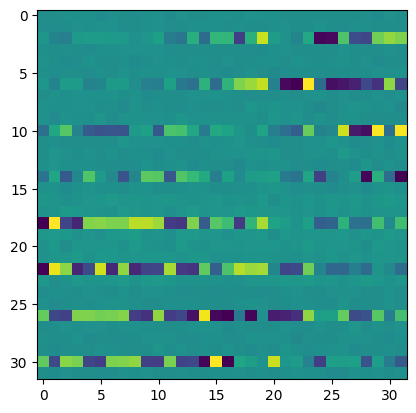

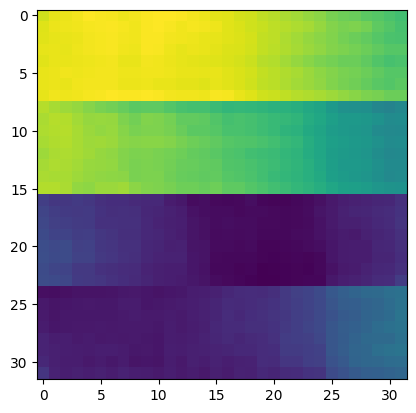

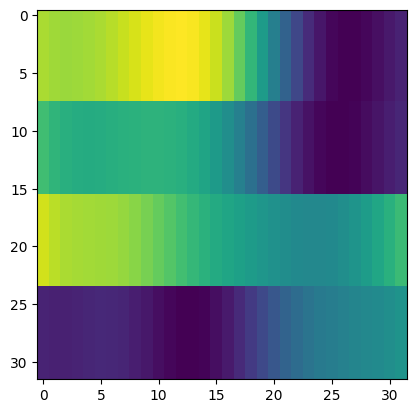

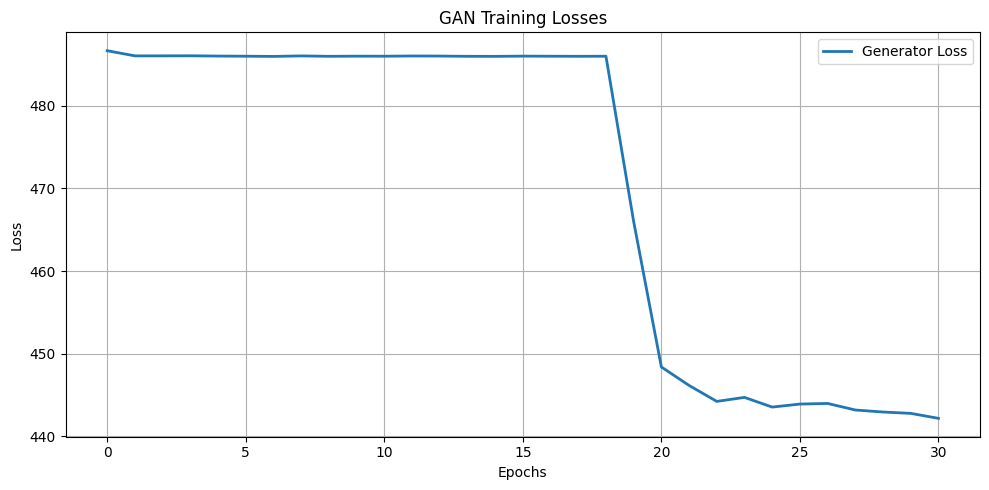

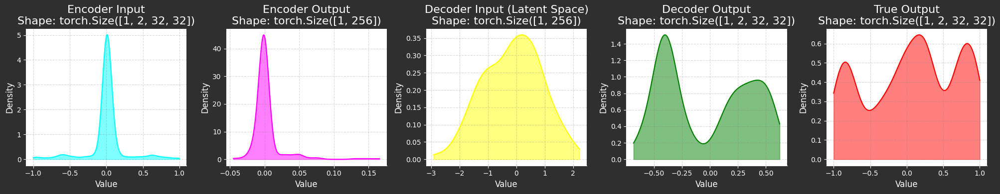

	MNSE Score: 0.6354422834184434
Batch [0/63] - vae loss:  453.22991943359375
Batch [21/63] - vae loss:  445.5765810879794
Batch [42/63] - vae loss:  445.17180899686593
	Epoch 31 - vae loss: 442.0009286063058
	MNSE Score: 0.6349995486320011
Batch [0/63] - vae loss:  442.0536804199219
Batch [21/63] - vae loss:  444.51882379705256
Batch [42/63] - vae loss:  444.3020466649255
	Epoch 32 - vae loss: 442.1931946769593
	MNSE Score: 0.6334938615087479
Batch [0/63] - vae loss:  440.82275390625
Batch [21/63] - vae loss:  443.25555142489344
Batch [42/63] - vae loss:  443.7304545557776
	Epoch 33 - vae loss: 441.26502433655753
	MNSE Score: 0.6298245626782614
Batch [0/63] - vae loss:  440.424072265625
Batch [21/63] - vae loss:  442.1804032759233
Batch [42/63] - vae loss:  442.9857710017714
	Epoch 34 - vae loss: 441.10855296301463
	MNSE Score: 0.629782583978441
Batch [0/63] - vae loss:  441.2319030761719
Batch [21/63] - vae loss:  443.7869345925071
Batch [42/63] - vae loss:  442.8281349359557
	Epoch 3

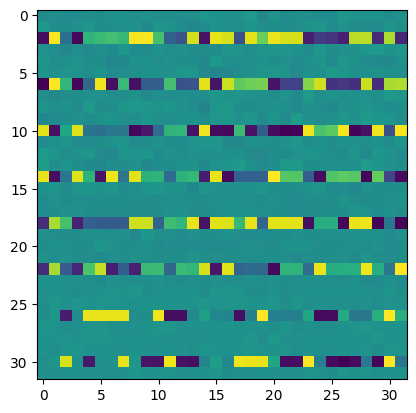

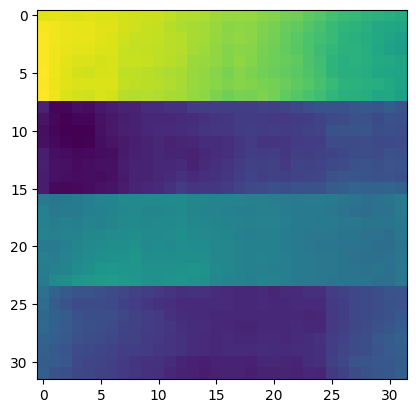

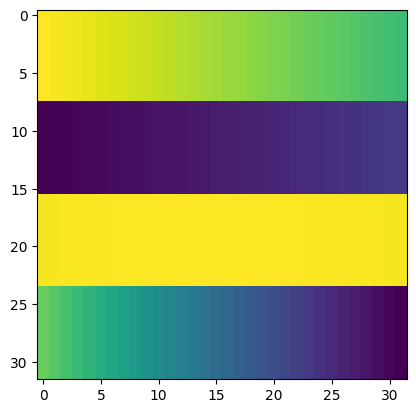

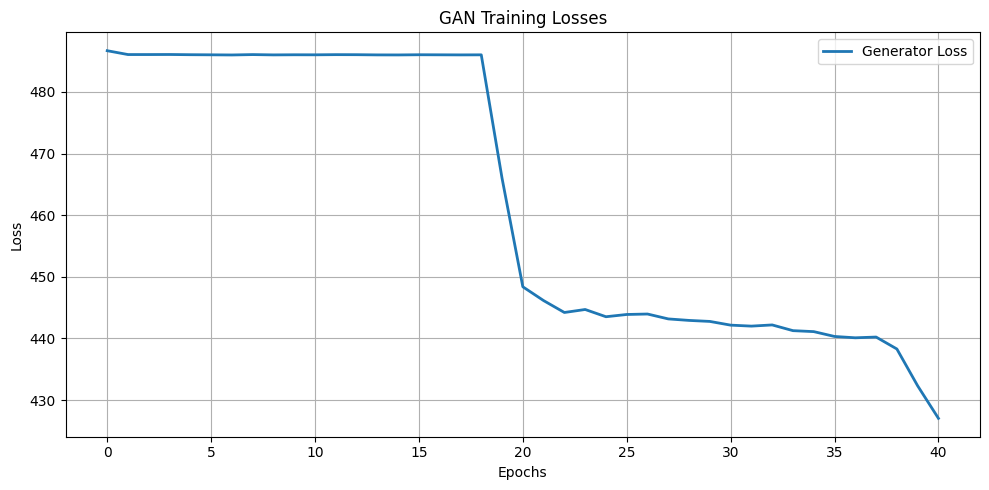

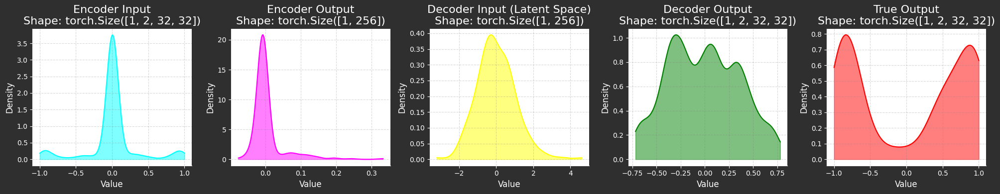

	MNSE Score: 0.547380544836559
Batch [0/63] - vae loss:  428.48724365234375
Batch [21/63] - vae loss:  428.1450694691051
Batch [42/63] - vae loss:  426.0830610408339
	Epoch 41 - vae loss: 423.5083312988281
	MNSE Score: 0.5328611211171226
Batch [0/63] - vae loss:  426.4332275390625
Batch [21/63] - vae loss:  423.62244068492544
Batch [42/63] - vae loss:  423.71319651049237
	Epoch 42 - vae loss: 421.2133619520399
	MNSE Score: 0.5218575516390422
Batch [0/63] - vae loss:  429.2184143066406
Batch [21/63] - vae loss:  423.5721893310547
Batch [42/63] - vae loss:  422.8334180255269
	Epoch 43 - vae loss: 420.4481268988715
	MNSE Score: 0.5183977806378924
Batch [0/63] - vae loss:  424.62164306640625
Batch [21/63] - vae loss:  422.88604042746806
Batch [42/63] - vae loss:  422.3148491438045
	Epoch 44 - vae loss: 419.6927998860677
	MNSE Score: 0.5115821919743977
Batch [0/63] - vae loss:  426.6924743652344
Batch [21/63] - vae loss:  421.4615880792791
Batch [42/63] - vae loss:  421.16022722111194
	Epoc

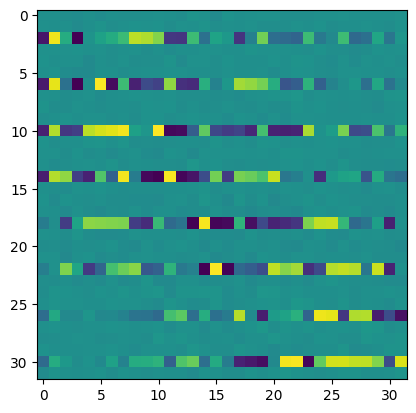

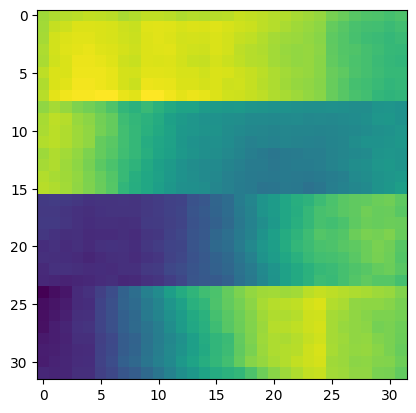

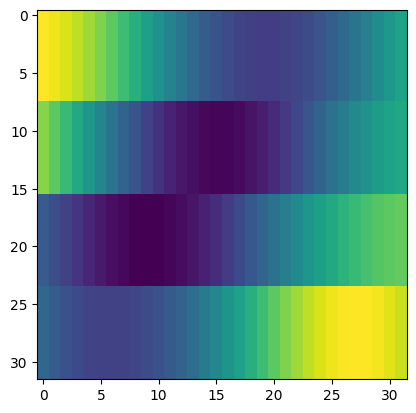

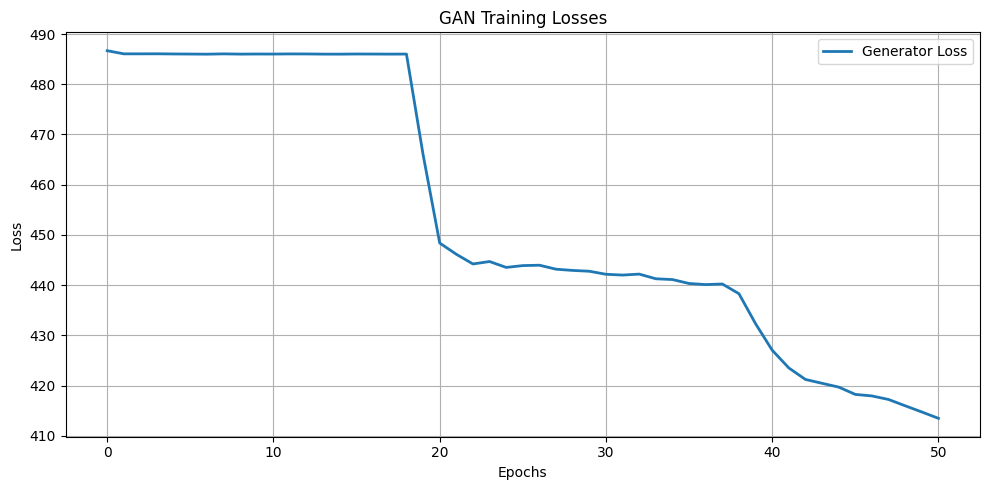

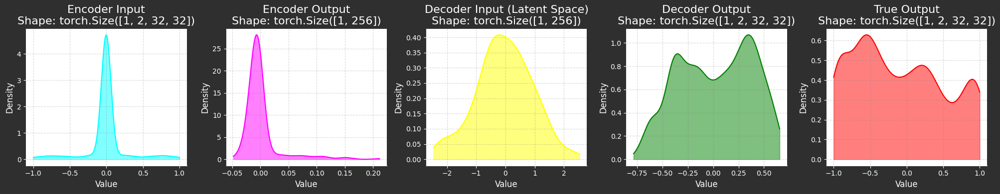

	MNSE Score: 0.4822115647414374
Batch [0/63] - vae loss:  409.14013671875
Batch [21/63] - vae loss:  413.9768094149503
Batch [42/63] - vae loss:  414.686583053234
	Epoch 51 - vae loss: 412.39307900080604
	MNSE Score: 0.4776147523569682
Batch [0/63] - vae loss:  409.6238098144531
Batch [21/63] - vae loss:  412.830078125
Batch [42/63] - vae loss:  414.1021323980287
	Epoch 52 - vae loss: 411.5573231530568
	MNSE Score: 0.47170447499033
Batch [0/63] - vae loss:  412.3821716308594
Batch [21/63] - vae loss:  413.525146484375
Batch [42/63] - vae loss:  413.36223371638806
	Epoch 53 - vae loss: 411.08131142268104
	MNSE Score: 0.4691079008200812
Batch [0/63] - vae loss:  417.1587829589844
Batch [21/63] - vae loss:  411.68502530184657
Batch [42/63] - vae loss:  412.473876953125
	Epoch 54 - vae loss: 409.62183876643104
	MNSE Score: 0.463438886498648
Batch [0/63] - vae loss:  413.83135986328125
Batch [21/63] - vae loss:  412.58304249156606
Batch [42/63] - vae loss:  412.06983770326127
	Epoch 55 - va

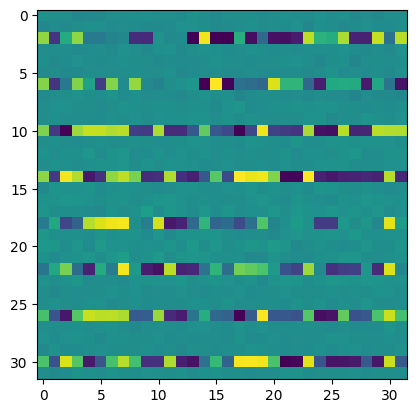

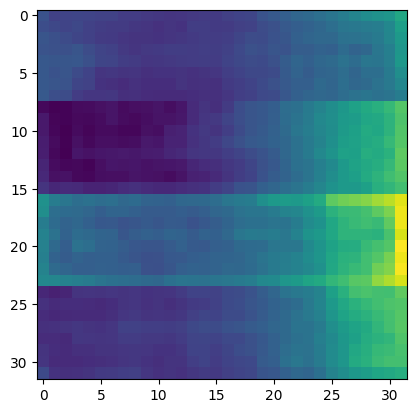

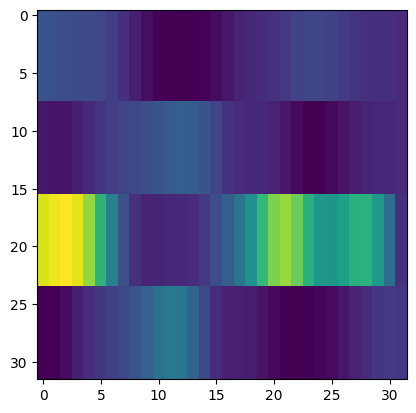

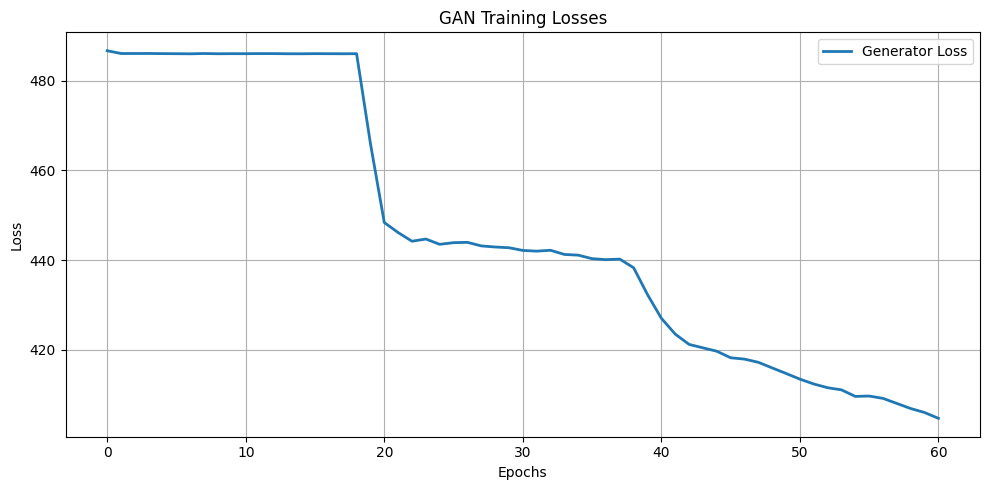

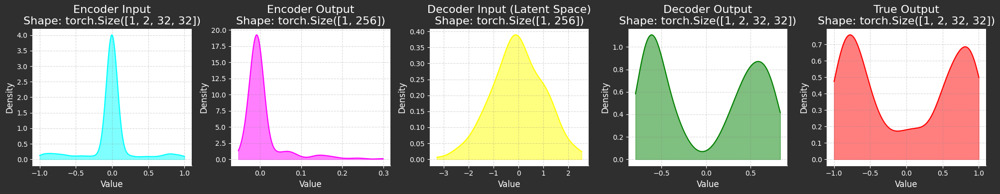

	MNSE Score: 0.43705311086442733
Batch [0/63] - vae loss:  413.33740234375
Batch [21/63] - vae loss:  407.7069452459162
Batch [42/63] - vae loss:  407.8507044592569
	Epoch 61 - vae loss: 405.3153236025856
	MNSE Score: 0.43440473741955227
Batch [0/63] - vae loss:  413.3294677734375
Batch [21/63] - vae loss:  405.49162847345525
Batch [42/63] - vae loss:  406.45640031681506
	Epoch 62 - vae loss: 404.25482759021577
	MNSE Score: 0.43382550846962703
Batch [0/63] - vae loss:  408.39837646484375
Batch [21/63] - vae loss:  407.3665757612749
Batch [42/63] - vae loss:  406.5908401844113
	Epoch 63 - vae loss: 404.2250540597098
	MNSE Score: 0.43361777776763555
Batch [0/63] - vae loss:  404.067138671875
Batch [21/63] - vae loss:  404.9072196266868
Batch [42/63] - vae loss:  406.2319484976835
	Epoch 64 - vae loss: 404.0561106848338
	MNSE Score: 0.43198919769317384
Batch [0/63] - vae loss:  413.17169189453125
Batch [21/63] - vae loss:  405.1778176047585
Batch [42/63] - vae loss:  405.6011565452398
	Ep

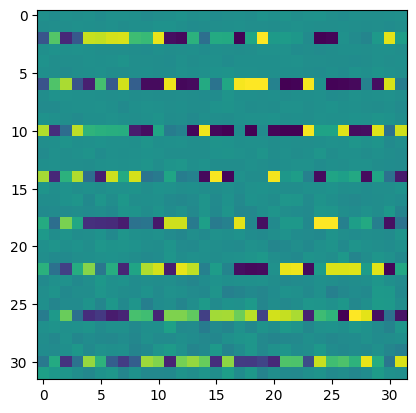

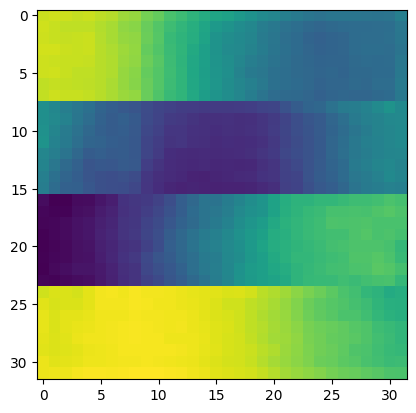

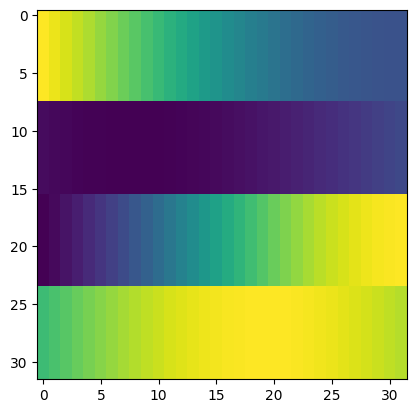

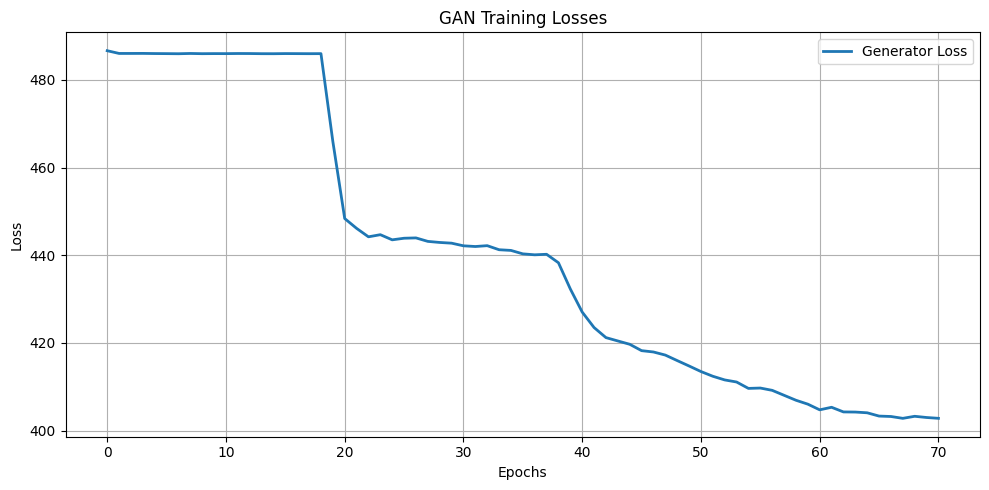

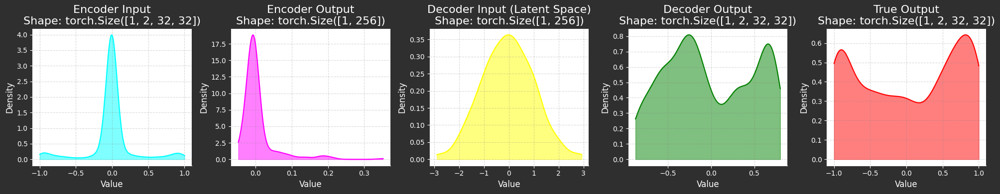

	MNSE Score: 0.426174652481836
Batch [0/63] - vae loss:  397.8821105957031
Batch [21/63] - vae loss:  404.8557142777876
Batch [42/63] - vae loss:  405.5040680641352
	Epoch 71 - vae loss: 402.9510081457713
Batch [0/63] - vae loss:  402.549560546875
Batch [21/63] - vae loss:  405.21305431019175
Batch [42/63] - vae loss:  405.86778578647346
	Epoch 72 - vae loss: 402.9383515857515
	MNSE Score: 0.425022492333064
Batch [0/63] - vae loss:  397.7140808105469
Batch [21/63] - vae loss:  404.11008522727275
Batch [42/63] - vae loss:  404.00834194449493
	Epoch 73 - vae loss: 402.0367155529204
Batch [0/63] - vae loss:  409.27880859375
Batch [21/63] - vae loss:  405.170146595348
Batch [42/63] - vae loss:  404.8434135969295
	Epoch 74 - vae loss: 402.0048997667101
	MNSE Score: 0.42339901791678536
Batch [0/63] - vae loss:  402.75
Batch [21/63] - vae loss:  403.05403553355825
Batch [42/63] - vae loss:  404.1930180039517
	Epoch 75 - vae loss: 401.4636775425502
Batch [0/63] - vae loss:  403.5030212402344
B

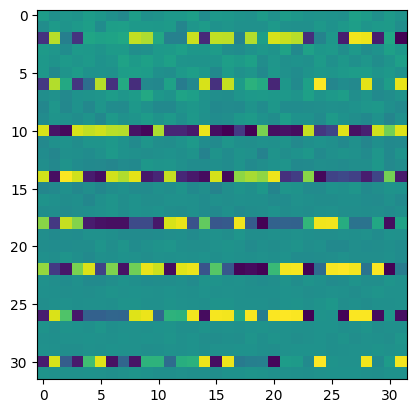

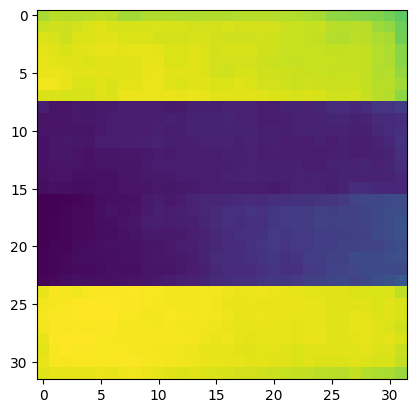

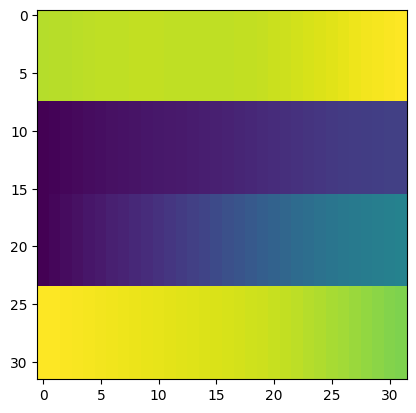

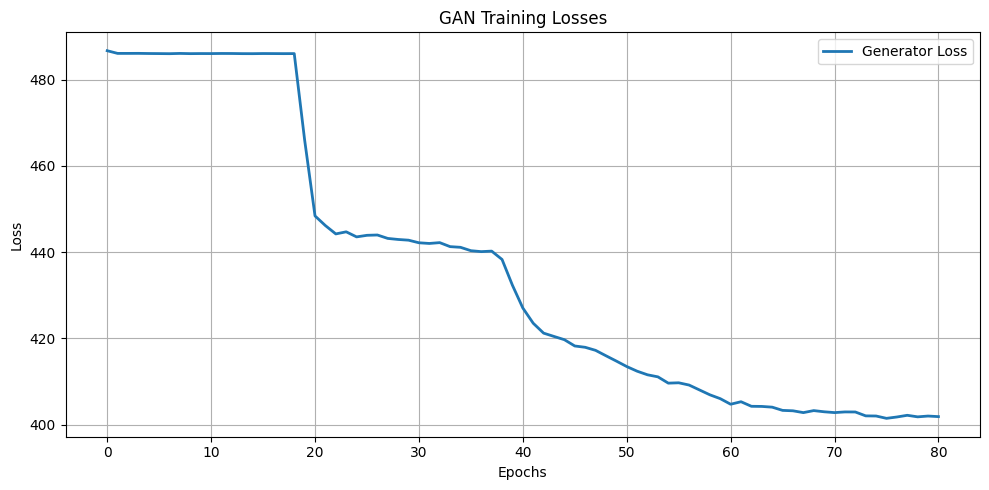

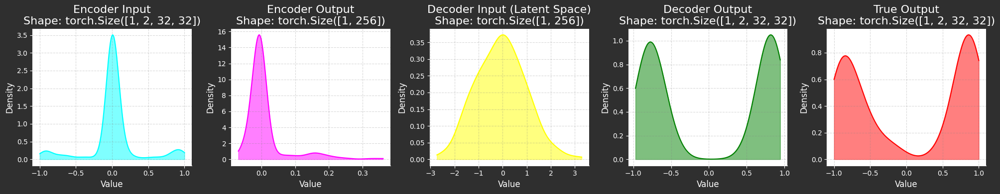

Batch [0/63] - vae loss:  404.27276611328125
Batch [21/63] - vae loss:  403.9308582652699
Batch [42/63] - vae loss:  404.55281386264534
	Epoch 81 - vae loss: 402.01485915411087
Batch [0/63] - vae loss:  401.08282470703125
Batch [21/63] - vae loss:  402.50902765447444
Batch [42/63] - vae loss:  403.9107524073401
	Epoch 82 - vae loss: 401.7691064259363
	MNSE Score: 0.4219357026001764
Batch [0/63] - vae loss:  398.2845153808594
Batch [21/63] - vae loss:  404.88846102627843
Batch [42/63] - vae loss:  404.6264875545058
	Epoch 83 - vae loss: 401.88450113932294
	MNSE Score: 0.4216461247868008
Batch [0/63] - vae loss:  397.3779296875
Batch [21/63] - vae loss:  402.1560044722124
Batch [42/63] - vae loss:  403.8531501237736
	Epoch 84 - vae loss: 401.34530155242436
	MNSE Score: 0.42125720873711603
Batch [0/63] - vae loss:  406.4446716308594
Batch [21/63] - vae loss:  402.9781702215021
Batch [42/63] - vae loss:  402.9559858455214
	Epoch 85 - vae loss: 401.3885749937996
	MNSE Score: 0.4195475275554

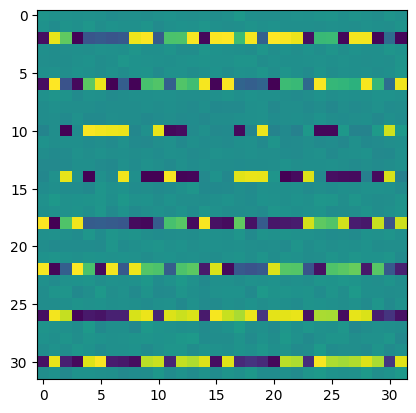

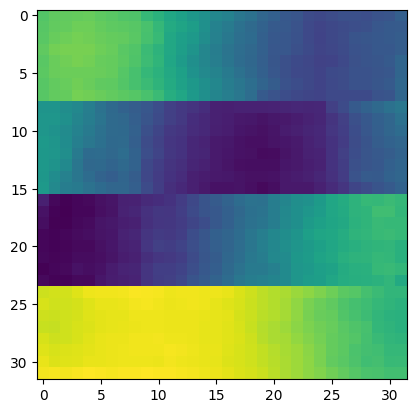

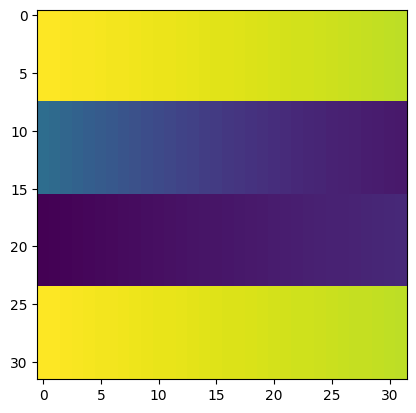

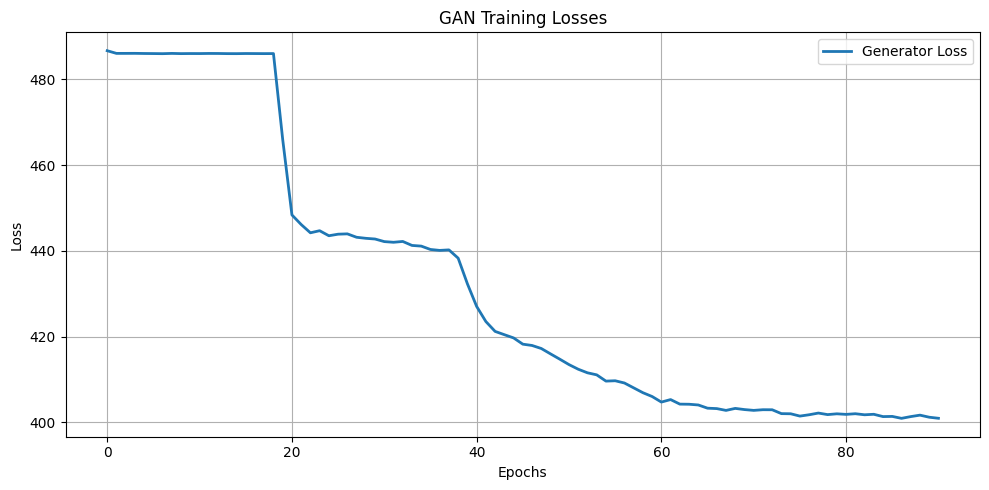

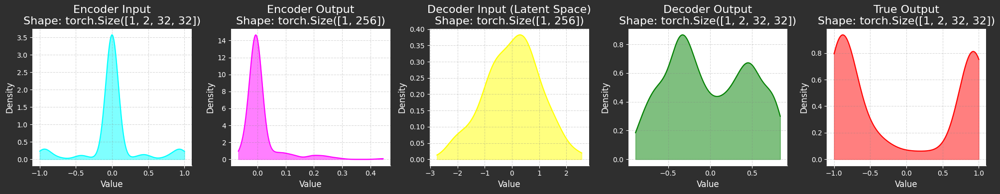

	MNSE Score: 0.4186847772863176
Batch [0/63] - vae loss:  394.4786071777344
Batch [21/63] - vae loss:  403.26161887428975
Batch [42/63] - vae loss:  403.2199856070585
	Epoch 91 - vae loss: 401.1155279250372
Batch [0/63] - vae loss:  401.9730224609375
Batch [21/63] - vae loss:  402.7001231800426
Batch [42/63] - vae loss:  402.73204359897346
	Epoch 92 - vae loss: 400.917238265749
	MNSE Score: 0.41784579224056667
Batch [0/63] - vae loss:  397.89715576171875
Batch [21/63] - vae loss:  402.3929706920277
Batch [42/63] - vae loss:  402.1134586777798
	Epoch 93 - vae loss: 401.0936138819134
Batch [0/63] - vae loss:  405.51123046875
Batch [21/63] - vae loss:  403.1044491854581
Batch [42/63] - vae loss:  403.1085389603016
	Epoch 94 - vae loss: 401.0014798603361
	MNSE Score: 0.4177825167065575
Batch [0/63] - vae loss:  408.7018127441406
Batch [21/63] - vae loss:  402.313794222745
Batch [42/63] - vae loss:  402.9858306175054
	Epoch 95 - vae loss: 400.9209124852741
Batch [0/63] - vae loss:  404.7148

In [31]:
channel_est_vae_multi_antenna()

## VAE + WGAN-GP

In [32]:
vae = VAE(z_dim=z_dim).to(device)
critic = Critic().to(device)

# Initialize weights
vae = vae.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
vae_opt = torch.optim.Adam(vae.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)

In [33]:
def channel_est_wgan_gp_vae_multi_antenna():
    save_results = "channel_est_wgan_gp_based_vae_multi_antenna"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        nmse_scores = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        vae.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()


                # Forward pass
                fake, *values = vae(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)

                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss
                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            vae_opt.zero_grad()

            # get noise
            # Forward pass
            fake_2, *values = vae(label)

            # Compute loss
            v_loss, *values = vae_loss(fake_2, real, *values)


            critic_fake_2 = critic(fake_2)


            g_loss = - torch.mean(critic_fake_2) + v_loss


            # Update gradients
            g_loss.backward()

            # Update the weights
            vae_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse_func(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        vae.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake, *values = vae(label)
                _, _, (input_decoder, output_encoder) = values
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:].T)
            show_tensor_images(real[0,0,:,:].T)
            show_loss_images(total_c_losses, total_g_losses)

            # grad_cam = GradCam(critic, critic.critic[-3])
            # grad_cam_1 = GradCam(critic, critic.critic[-2])
            # grad_cam_2 = GradCam(critic, critic.critic[-1])
            # grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            # grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            # grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            plot_vae_in_out(label, fake, input_decoder, output_encoder, real)


            grad_cam = GradCam(critic, critic.critic[-3][0])
            grad_cam_1 = GradCam(critic, critic.critic[-2][0])
            grad_cam_2 = GradCam(critic, critic.critic[-1][0])
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            save_checkpoint(vae, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")
            plot_generated_image(
                fake[0,0,:,:].T,
                test_input=label[0,0,:,:].T,
                tar=real[0,0,:,:].T,
                prefix=save_results,
            )
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] -  Critic loss:  9.86573855082194 - generator loss:  508.0868225097656
Batch [21/63] -  Critic loss:  6.65311785177751 - generator loss:  491.54901400479406
Batch [42/63] -  Critic loss:  5.230659830477811 - generator loss:  490.06037441519805
	Epoch 0 - critic loss: 5.78624889585707 - generator loss: 486.91320752340647


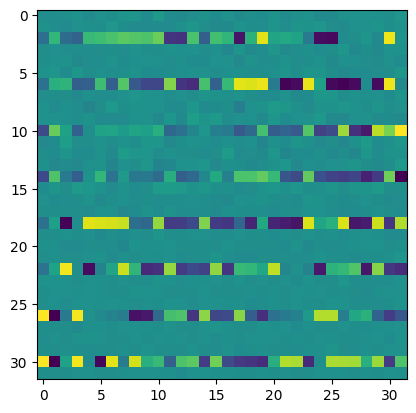

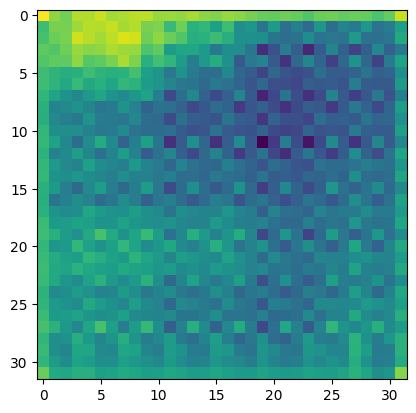

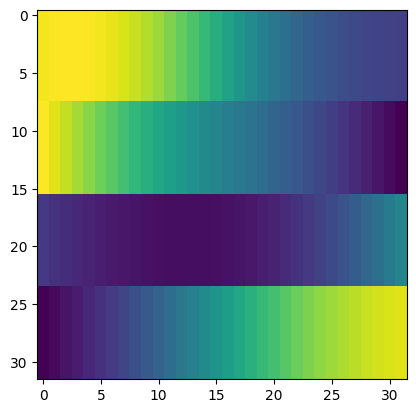

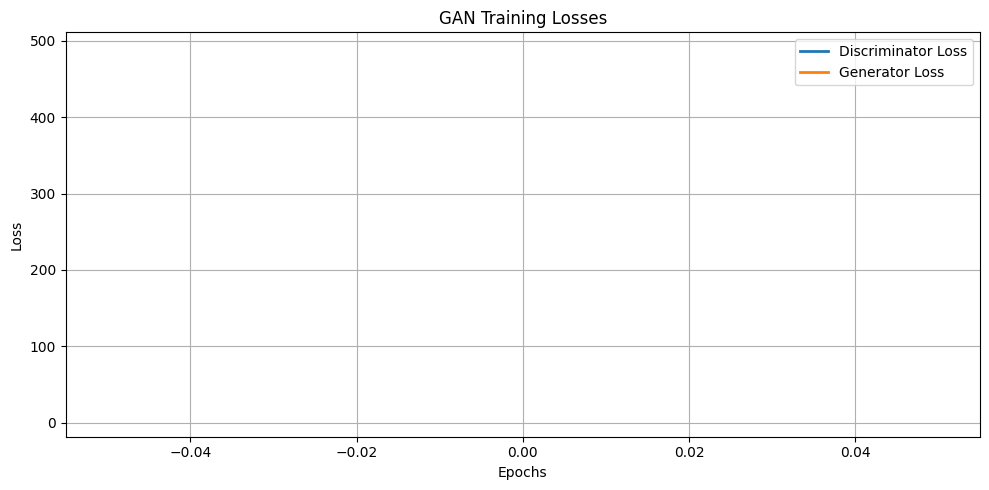

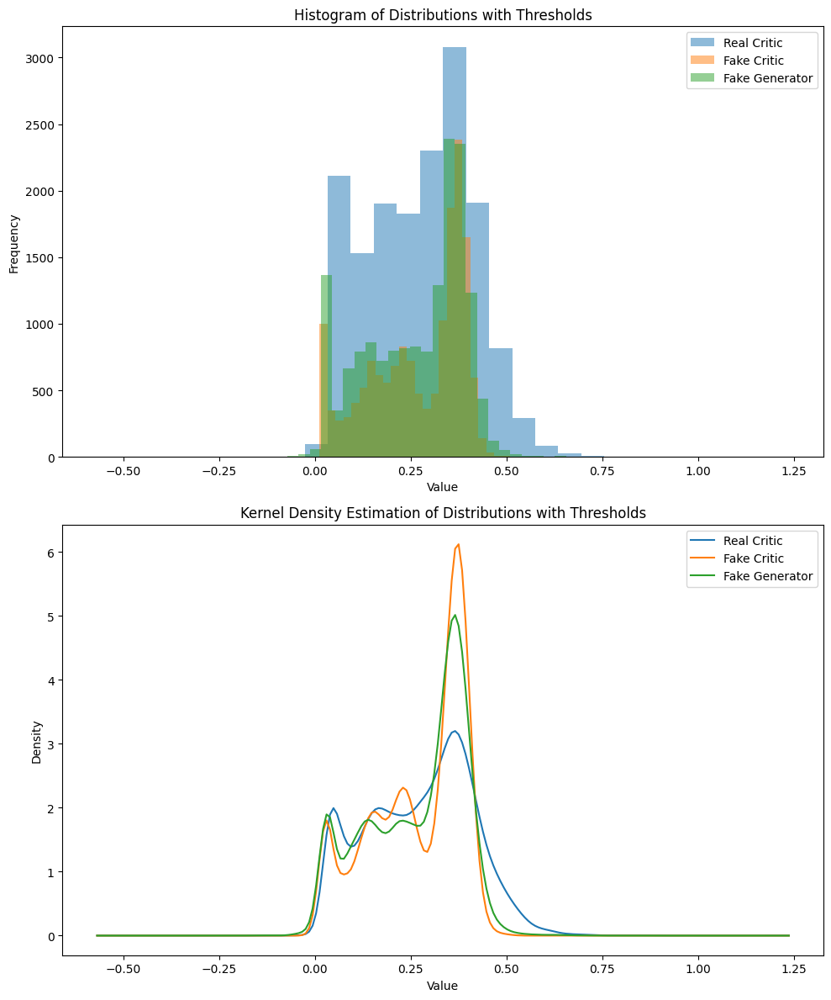

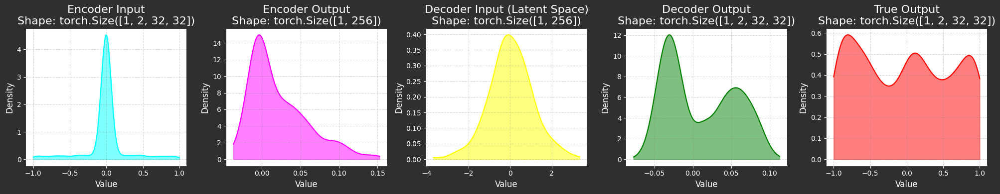

<ipython-input-24-b68e3bf66b4b>:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


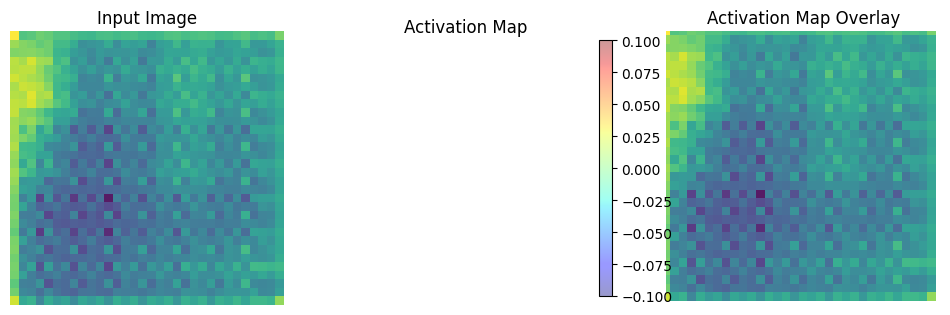

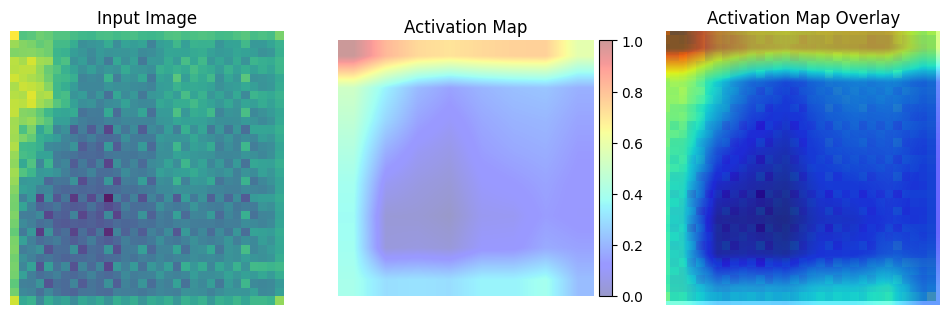

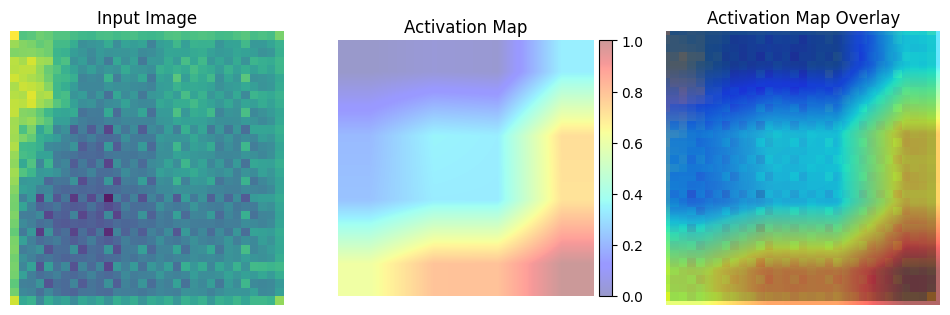

	MNSE Score: 1.0032963686519198
Batch [0/63] -  Critic loss:  5.424257914225261 - generator loss:  490.33514404296875
Batch [21/63] -  Critic loss:  5.817780068426421 - generator loss:  488.17246176979756
Batch [42/63] -  Critic loss:  4.615349895270295 - generator loss:  476.3647354480832
	Epoch 1 - critic loss: 4.066900826005076 - generator loss: 466.0959244985429
	MNSE Score: 0.824241508567144
Batch [0/63] -  Critic loss:  0.9882928927739462 - generator loss:  454.8166198730469
Batch [21/63] -  Critic loss:  1.1238299626292607 - generator loss:  451.8046472722834
Batch [42/63] -  Critic loss:  1.0212424951930381 - generator loss:  451.6023871843205
	Epoch 2 - critic loss: 0.8590385377722446 - generator loss: 448.21790664915056
	MNSE Score: 0.6743675952865964
Batch [0/63] -  Critic loss:  0.3430620531241099 - generator loss:  451.3976135253906
Batch [21/63] -  Critic loss:  0.35588791763240646 - generator loss:  447.9034035422585
Batch [42/63] -  Critic loss:  0.5932291353395743 - ge

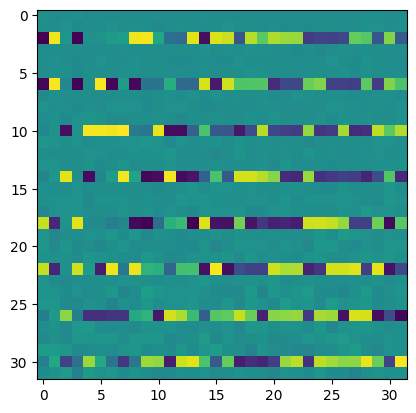

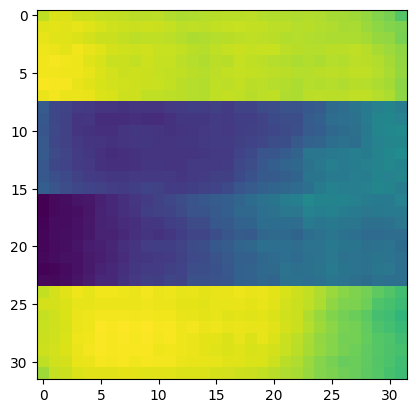

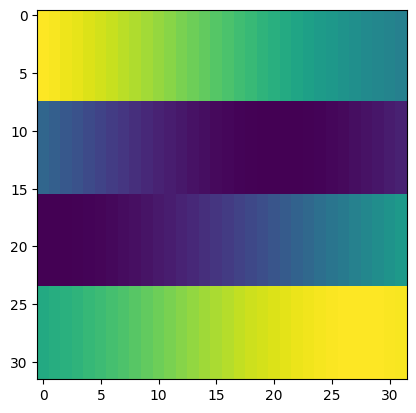

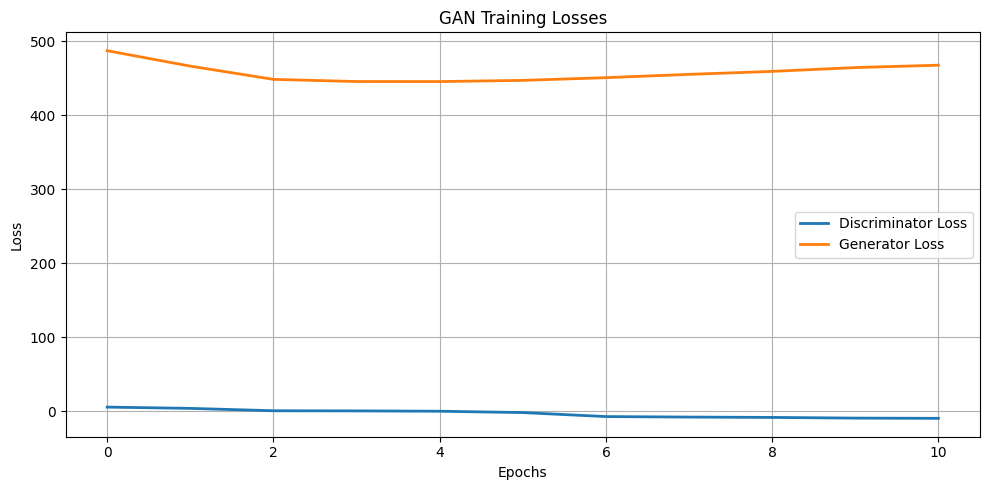

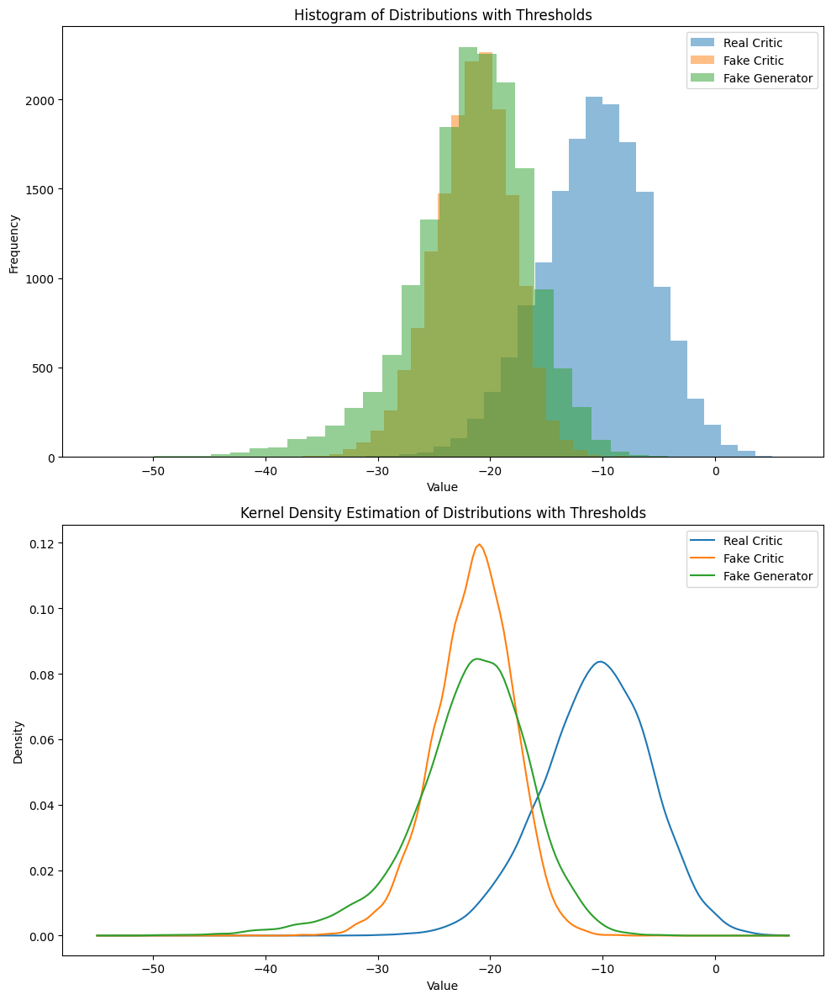

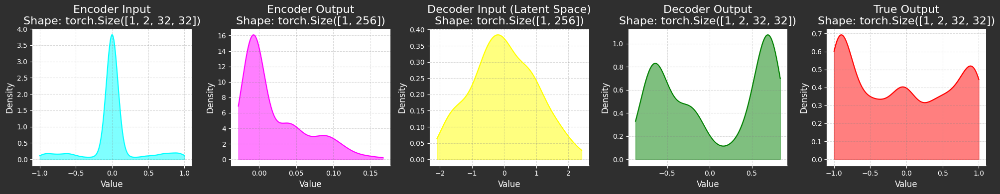

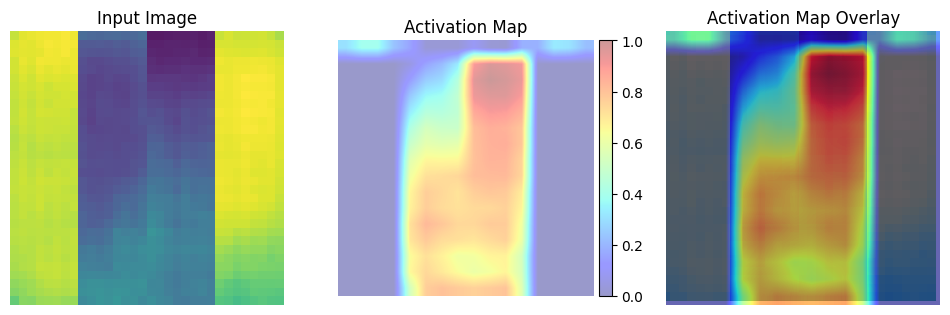

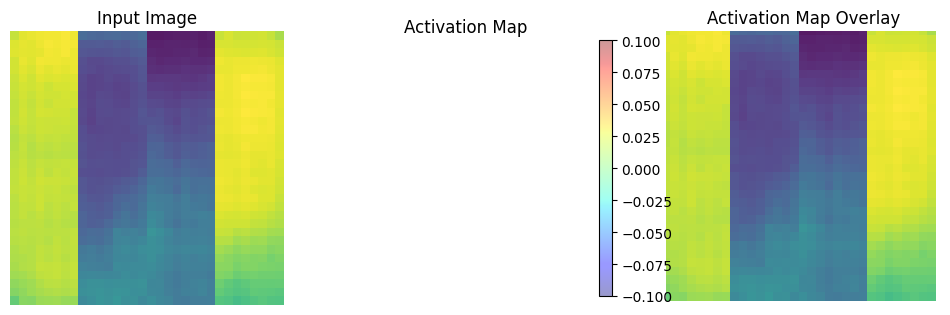

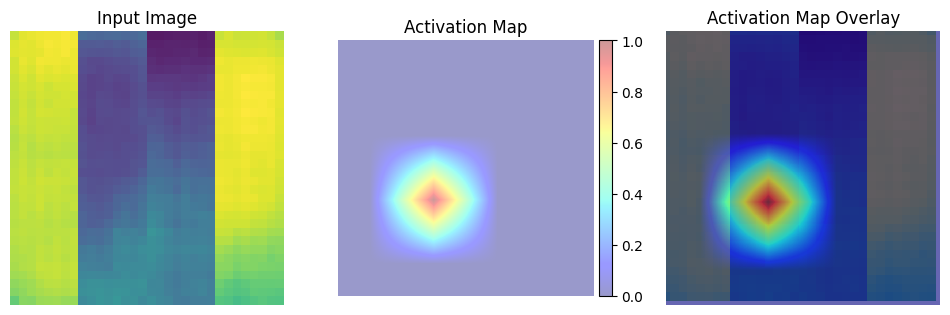

	MNSE Score: 0.6298661241455684
Batch [0/63] -  Critic loss:  -7.59689982732137 - generator loss:  461.15167236328125
Batch [21/63] -  Critic loss:  -8.61312092434276 - generator loss:  470.51628945090556
Batch [42/63] -  Critic loss:  -8.972631251165108 - generator loss:  471.6834241290425
	Epoch 11 - critic loss: -8.673579316921334 - generator loss: 470.4771248953683
	MNSE Score: 0.6284665834336054
Batch [0/63] -  Critic loss:  -8.084129492441813 - generator loss:  473.5645751953125
Batch [21/63] -  Critic loss:  -7.77037247202613 - generator loss:  471.7742267955433
Batch [42/63] -  Critic loss:  -6.673555349194728 - generator loss:  469.4060051496639
	Epoch 12 - critic loss: -6.5521083944058285 - generator loss: 466.0124739389571
	MNSE Score: 0.627874527658735
Batch [0/63] -  Critic loss:  -6.471142292022705 - generator loss:  471.84283447265625
Batch [21/63] -  Critic loss:  -6.897962230624574 - generator loss:  464.4786487926136
Batch [42/63] -  Critic loss:  -7.09210164417592 - 

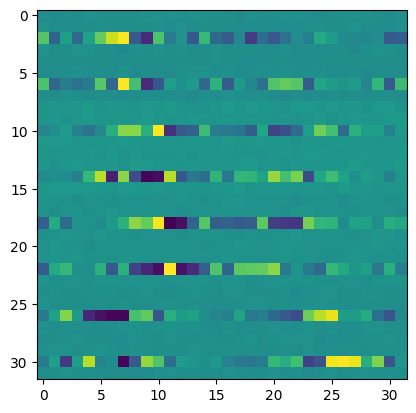

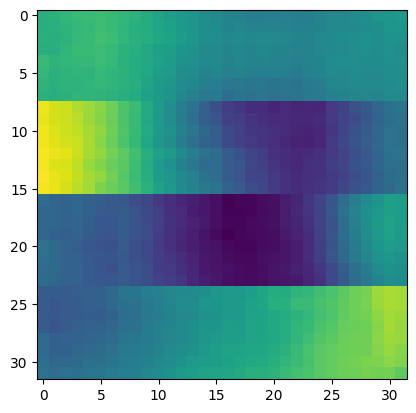

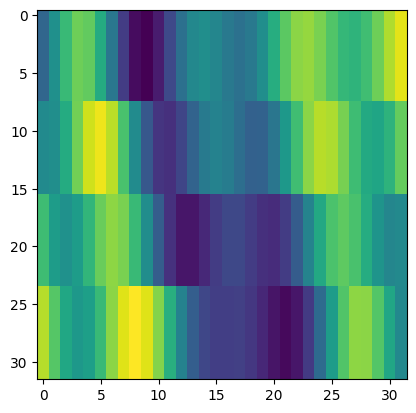

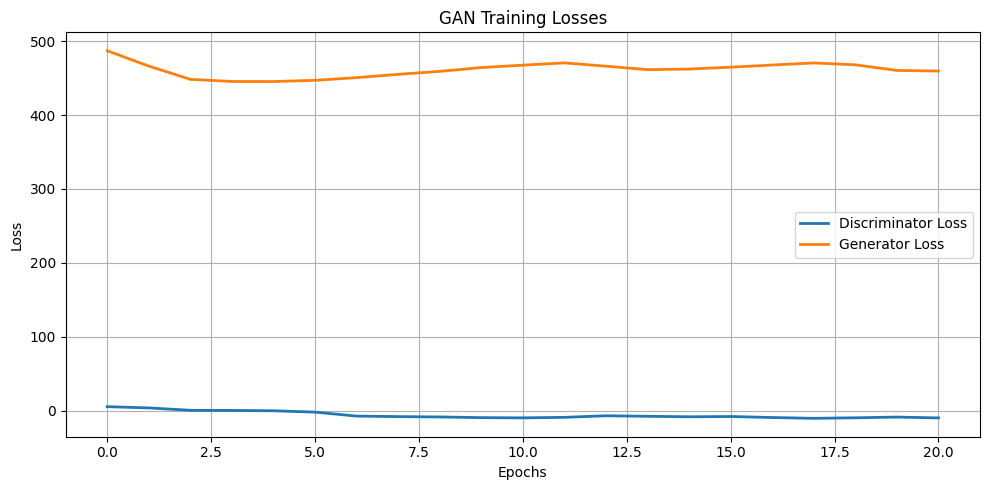

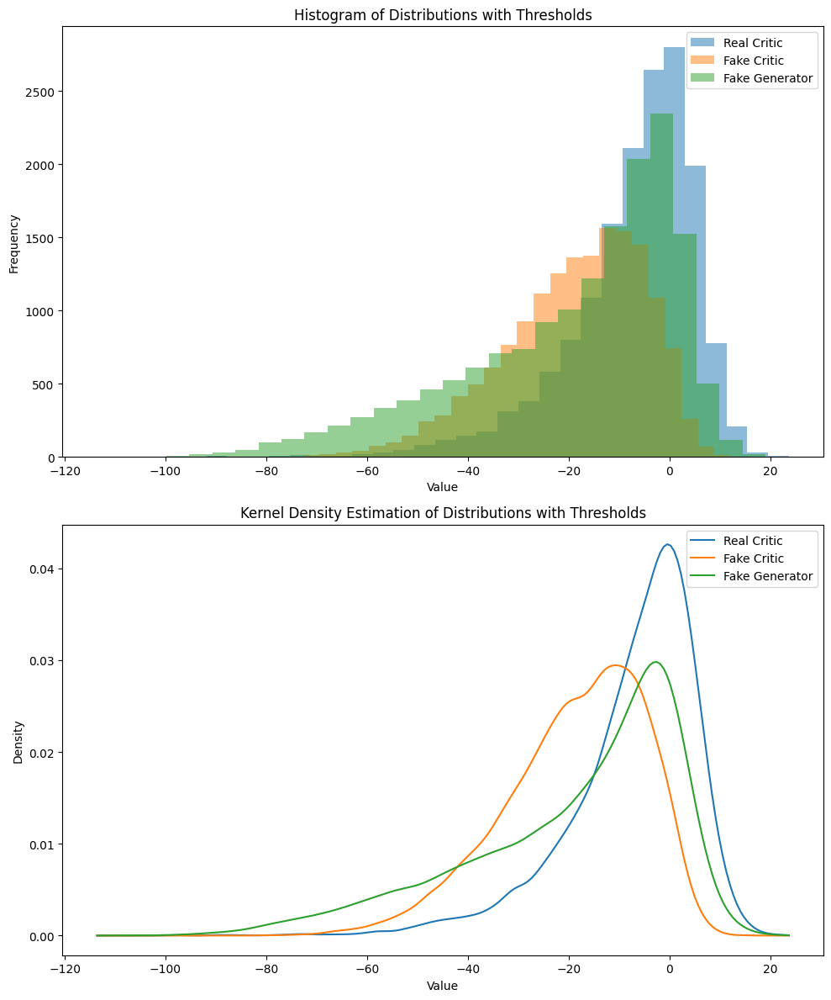

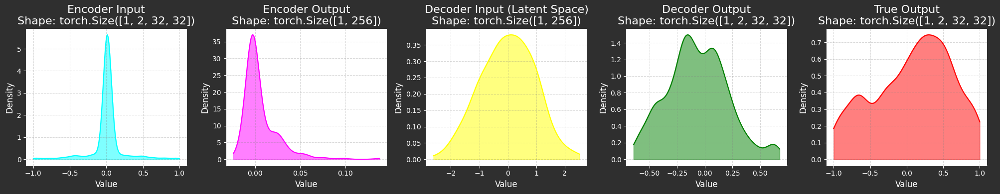

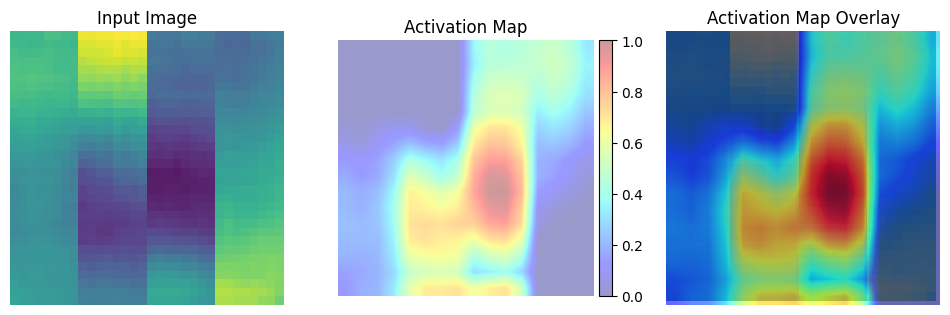

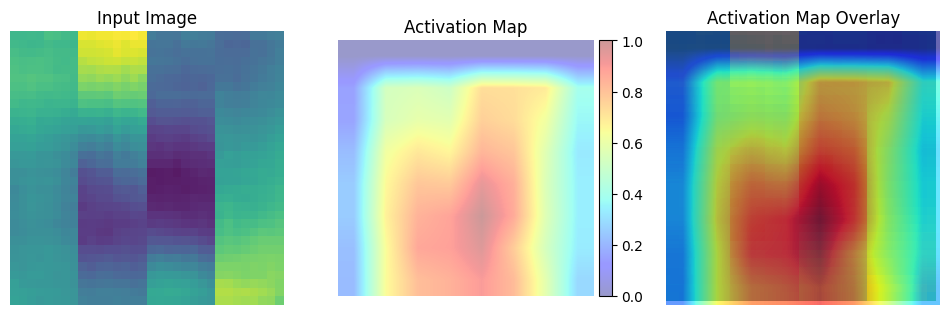

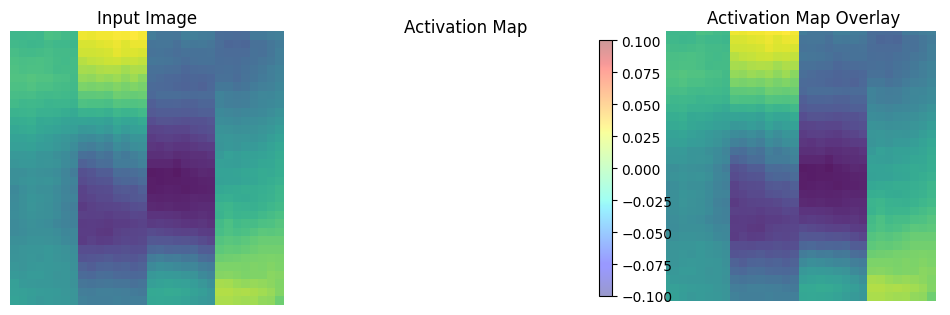

	MNSE Score: 0.5914873745706346
Batch [0/63] -  Critic loss:  -13.556349436442057 - generator loss:  467.78582763671875
Batch [21/63] -  Critic loss:  -7.713426373221659 - generator loss:  462.07853282581675
Batch [42/63] -  Critic loss:  -9.982482259587725 - generator loss:  460.63559882585395
	Epoch 21 - critic loss: -8.473368734279006 - generator loss: 455.3043154761905
	MNSE Score: 0.5650573363379826
Batch [0/63] -  Critic loss:  -4.89894962310791 - generator loss:  441.154296875
Batch [21/63] -  Critic loss:  -5.820155830094309 - generator loss:  442.65663979270244
Batch [42/63] -  Critic loss:  -6.1097588982693 - generator loss:  440.5485740484193
	Epoch 22 - critic loss: -6.251324810048258 - generator loss: 436.4840930757068
	MNSE Score: 0.5276353297725557
Batch [0/63] -  Critic loss:  -7.006035486857097 - generator loss:  439.06695556640625
Batch [21/63] -  Critic loss:  -7.185088497219663 - generator loss:  435.3697537508878
Batch [42/63] -  Critic loss:  -7.634038599886635 - 

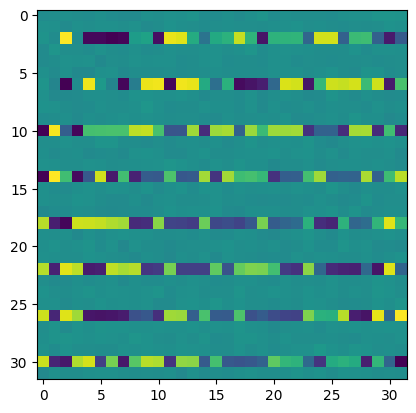

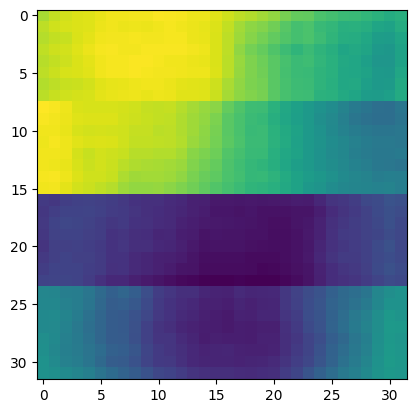

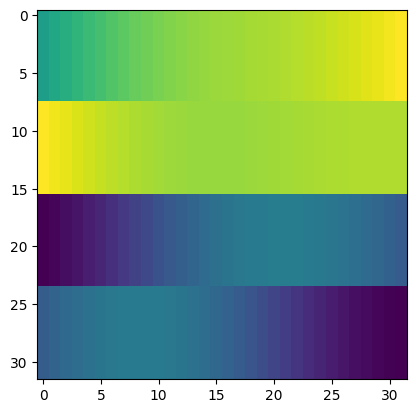

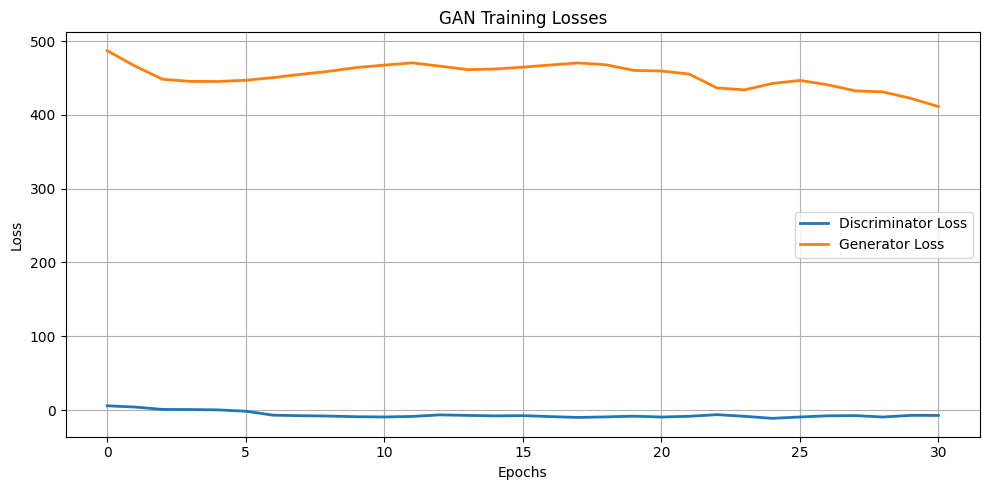

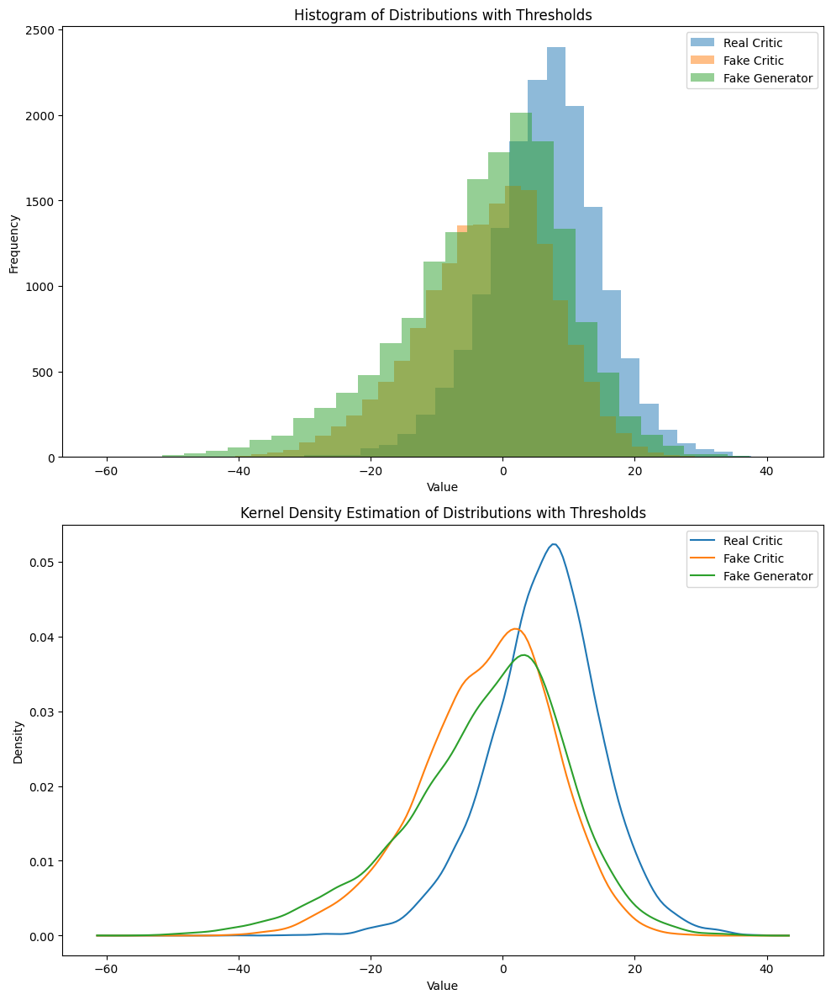

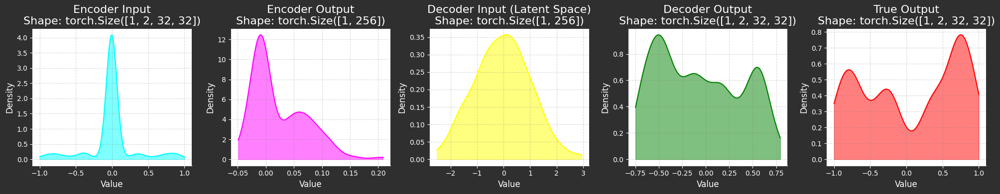

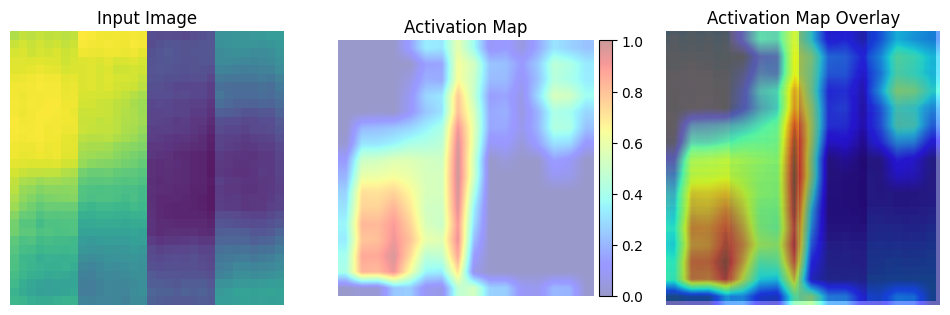

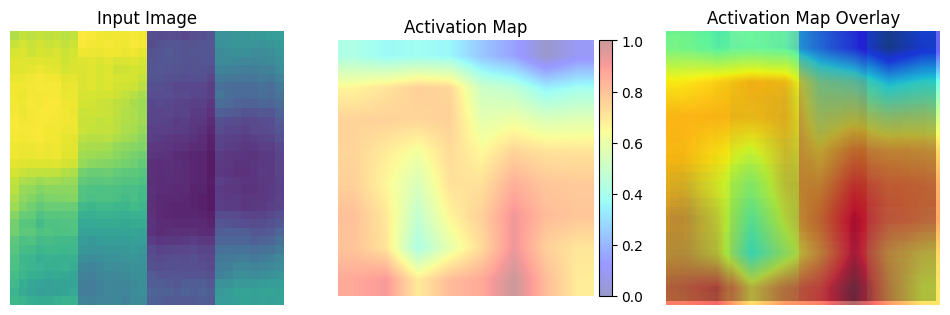

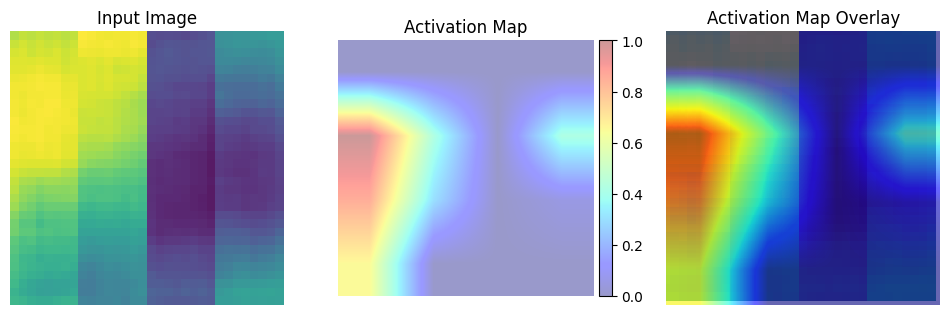

	MNSE Score: 0.4322850505510966
Batch [0/63] -  Critic loss:  -7.15228255589803 - generator loss:  408.498779296875
Batch [21/63] -  Critic loss:  -8.035160115270903 - generator loss:  411.93359791148794
Batch [42/63] -  Critic loss:  -8.156162006910456 - generator loss:  411.0849240325218
	Epoch 31 - critic loss: -8.32735125728385 - generator loss: 409.2413538372706
	MNSE Score: 0.4254642261399163
Batch [0/63] -  Critic loss:  -8.932005882263184 - generator loss:  419.3040771484375
Batch [21/63] -  Critic loss:  -7.804158698428761 - generator loss:  410.7034939852628
Batch [42/63] -  Critic loss:  -7.405431168948033 - generator loss:  409.84741494821947
	Epoch 32 - critic loss: -7.318315035451658 - generator loss: 407.1312343052455
	MNSE Score: 0.42513122586976915
Batch [0/63] -  Critic loss:  -7.623379389444987 - generator loss:  410.2362060546875
Batch [21/63] -  Critic loss:  -8.29088669834715 - generator loss:  409.2795132723722
Batch [42/63] -  Critic loss:  -8.221408285835915 - 

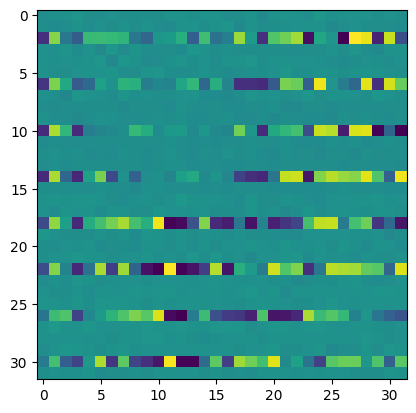

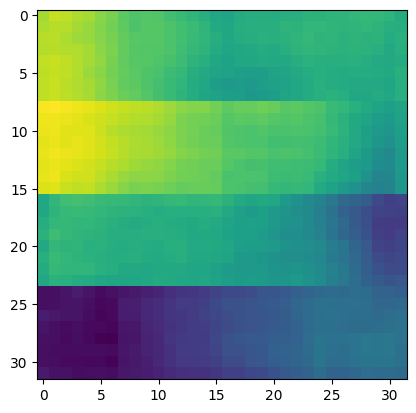

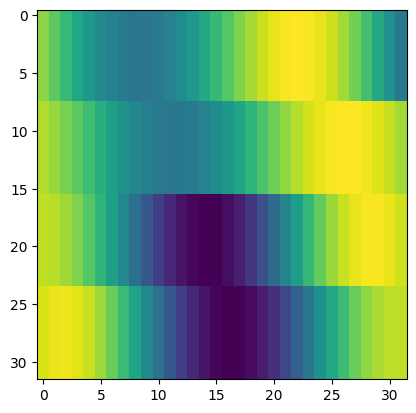

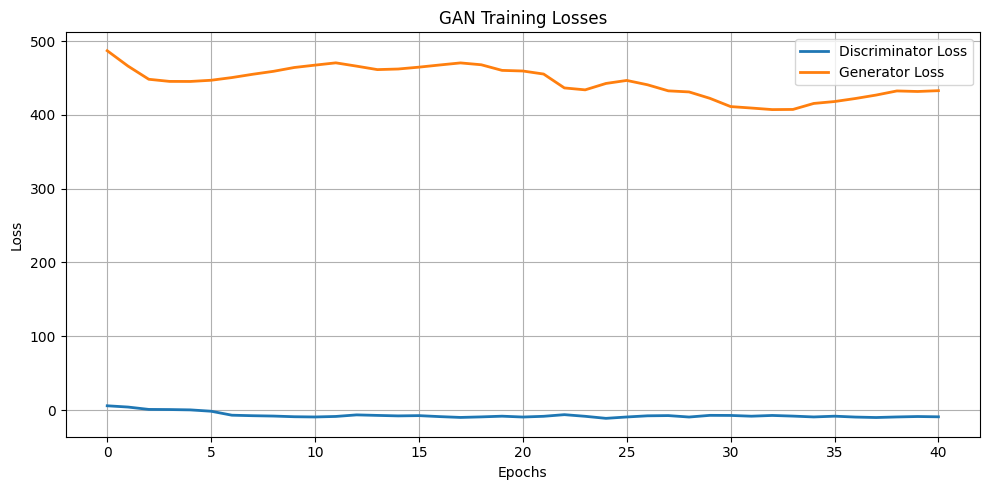

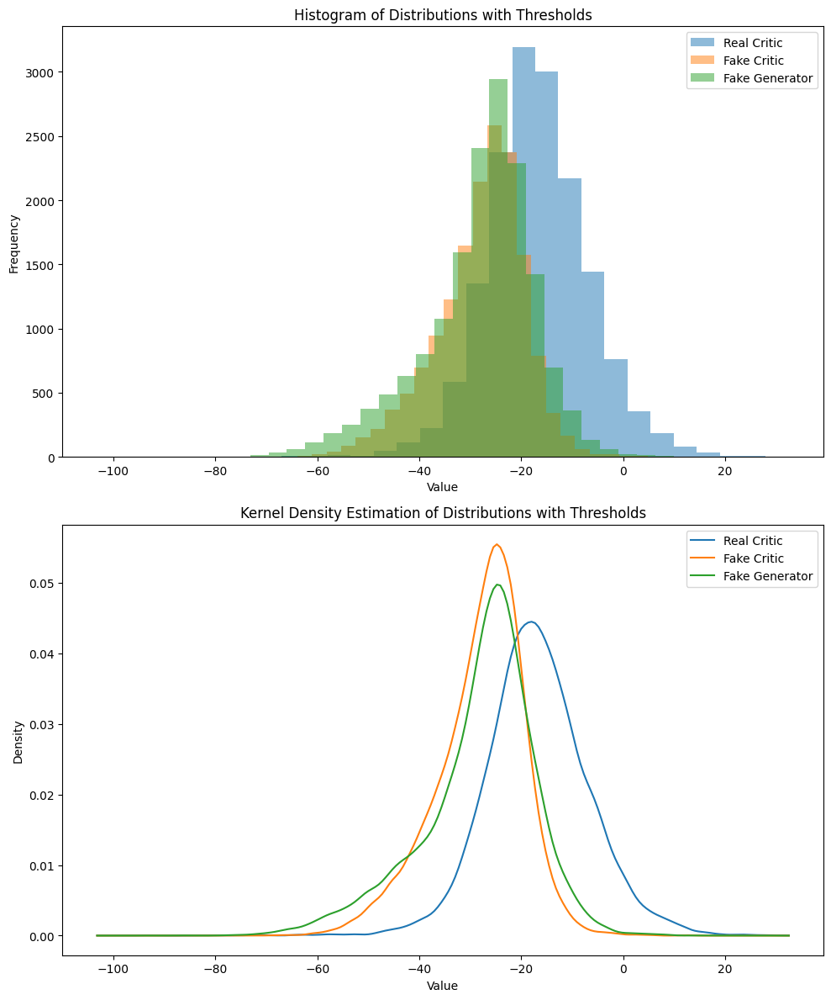

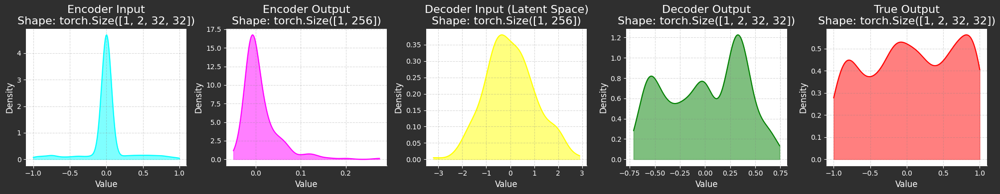

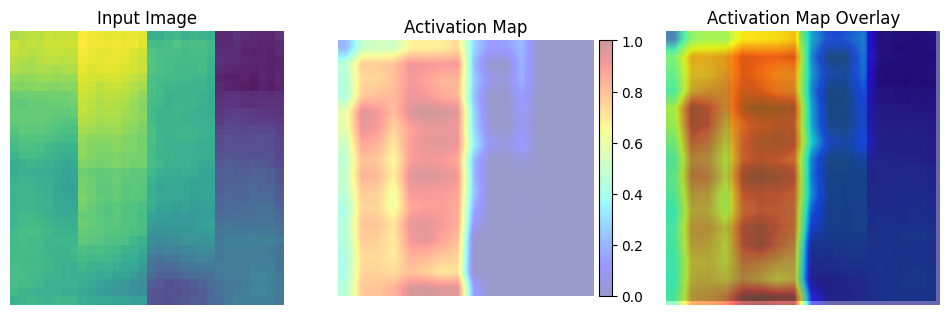

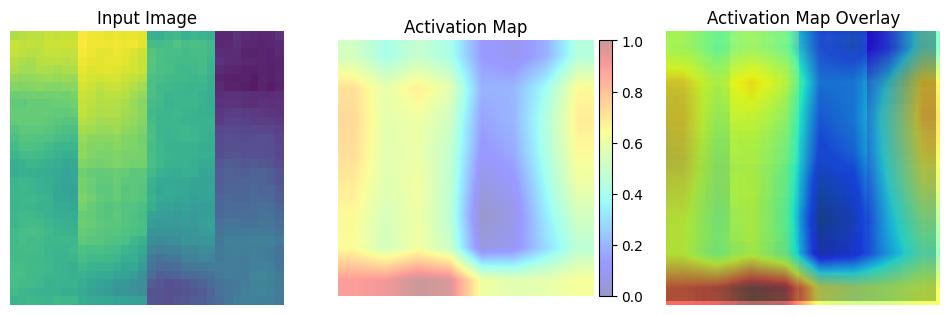

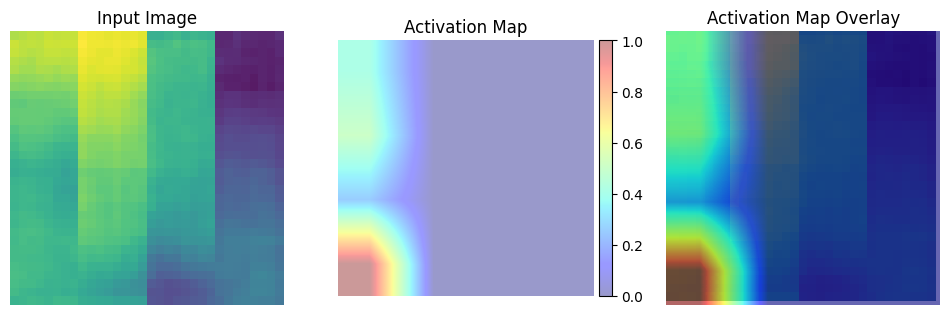

Batch [0/63] -  Critic loss:  -7.192693710327148 - generator loss:  438.5608215332031
Batch [21/63] -  Critic loss:  -8.459699804132633 - generator loss:  436.4963836669922
Batch [42/63] -  Critic loss:  -9.04867572562639 - generator loss:  437.973692428234
	Epoch 41 - critic loss: -8.095772907216714 - generator loss: 433.815436469184
	MNSE Score: 0.4161830298484318
Batch [0/63] -  Critic loss:  -7.2018327713012695 - generator loss:  441.11090087890625
Batch [21/63] -  Critic loss:  -7.582295446684866 - generator loss:  434.2139296098189
Batch [42/63] -  Critic loss:  -7.854286848112593 - generator loss:  435.435868374137
	Epoch 42 - critic loss: -8.500905594497763 - generator loss: 433.5615965828063
	MNSE Score: 0.4127449842672499
Batch [0/63] -  Critic loss:  -9.485276540120443 - generator loss:  443.6675720214844
Batch [21/63] -  Critic loss:  -9.717228983387804 - generator loss:  443.9631625088778
Batch [42/63] -  Critic loss:  -9.554227254187417 - generator loss:  444.281997325808

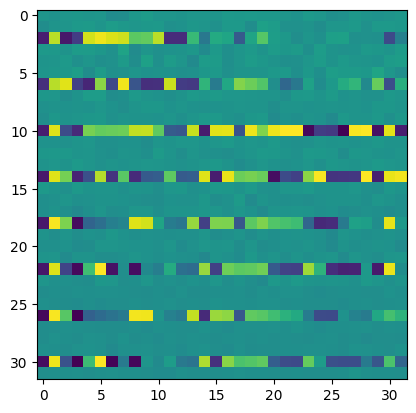

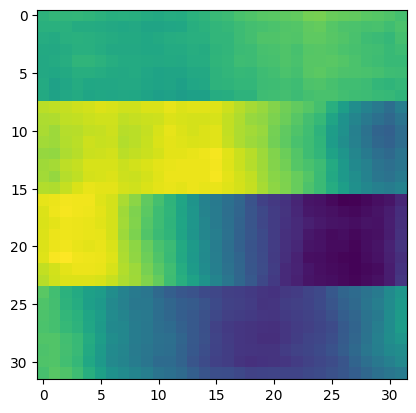

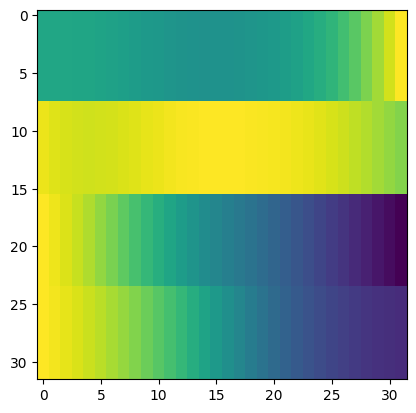

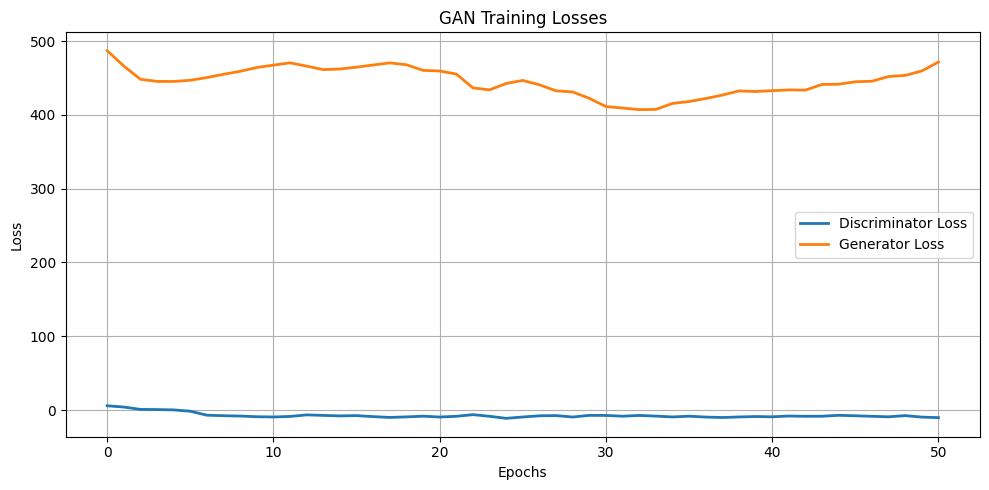

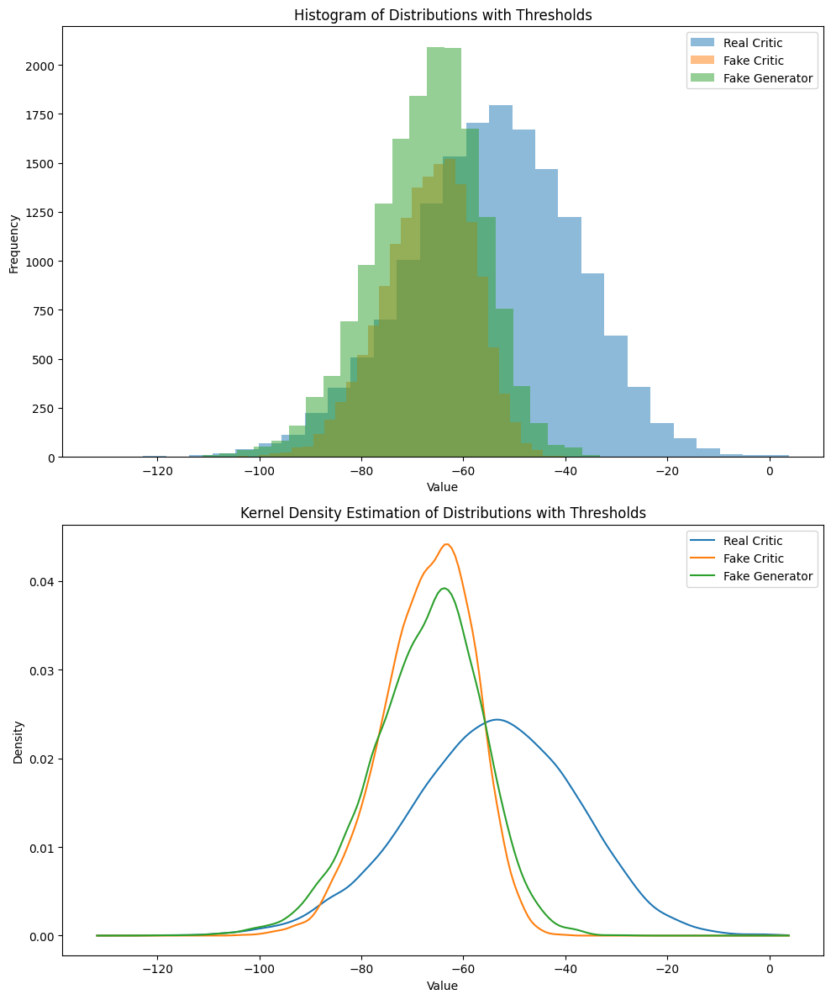

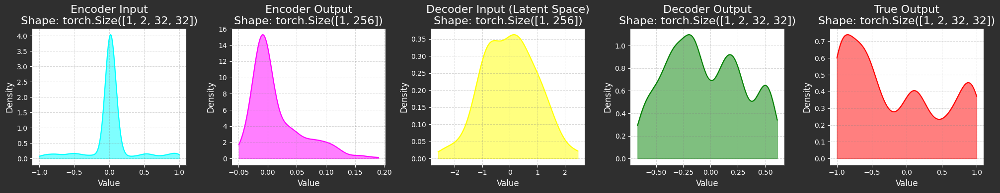

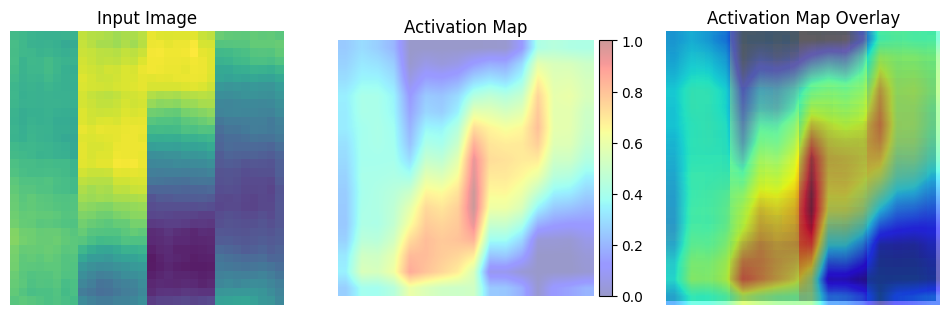

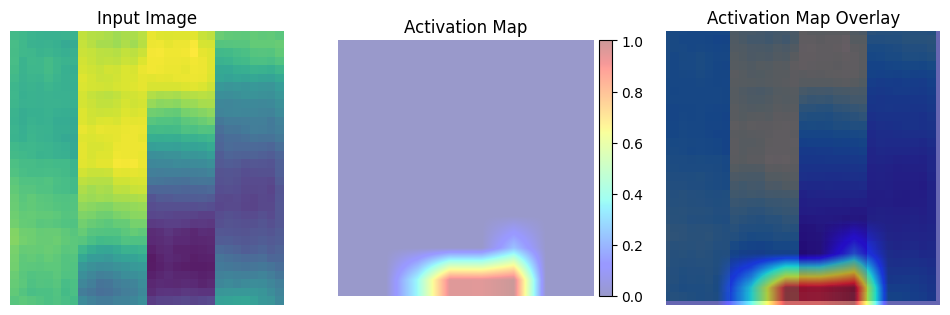

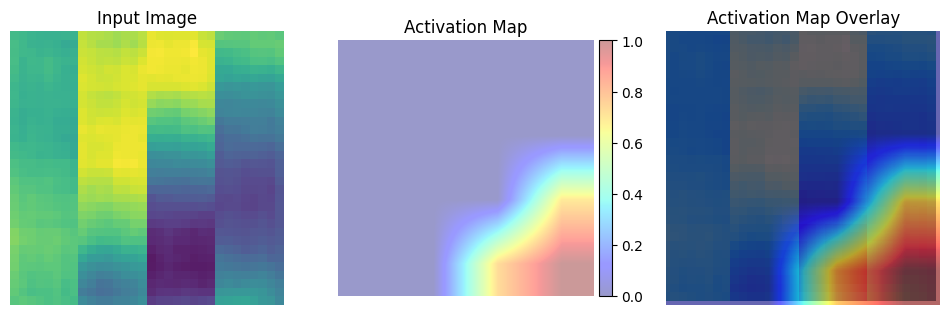

Batch [0/63] -  Critic loss:  -8.010764280954996 - generator loss:  481.2160339355469
Batch [21/63] -  Critic loss:  -9.866750890558414 - generator loss:  481.84307861328125
Batch [42/63] -  Critic loss:  -7.927324188772098 - generator loss:  478.06958575581393
	Epoch 51 - critic loss: -7.635792745484245 - generator loss: 473.9564795115637
Batch [0/63] -  Critic loss:  -7.741016070048015 - generator loss:  472.36334228515625
Batch [21/63] -  Critic loss:  -7.4328763701698985 - generator loss:  472.4875890558416
Batch [42/63] -  Critic loss:  -7.652465387832287 - generator loss:  472.1789153343023
	Epoch 52 - critic loss: -7.732410203842889 - generator loss: 469.33717128208707
Batch [0/63] -  Critic loss:  -7.181702931722005 - generator loss:  467.9282531738281
Batch [21/63] -  Critic loss:  -8.68255006905758 - generator loss:  470.8996415571733
Batch [42/63] -  Critic loss:  -8.810082823731177 - generator loss:  471.82654518304867
	Epoch 53 - critic loss: -8.770990774114294 - generator

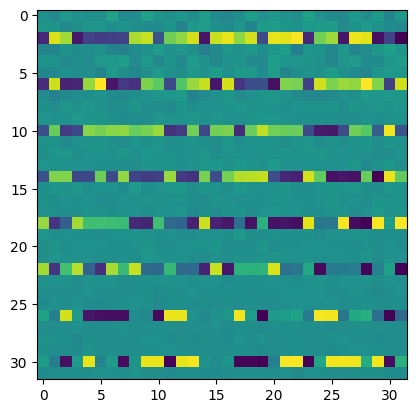

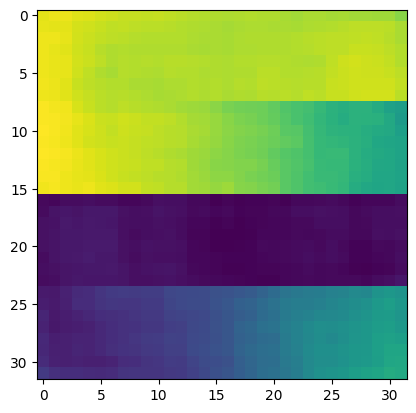

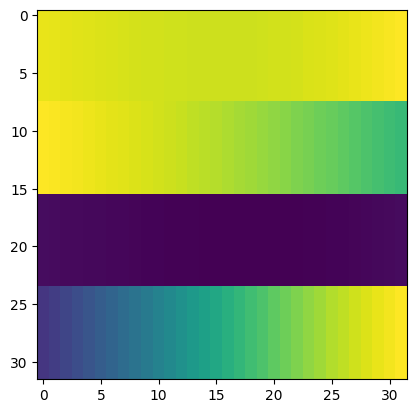

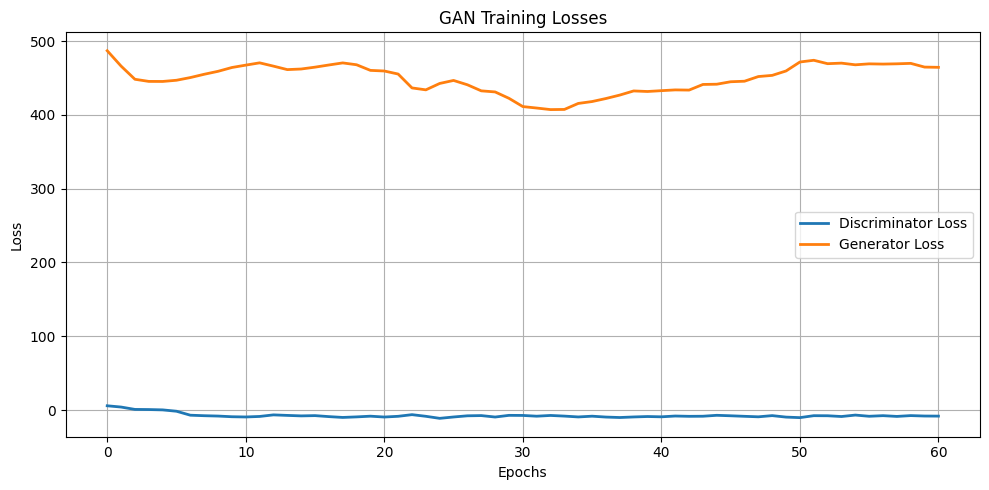

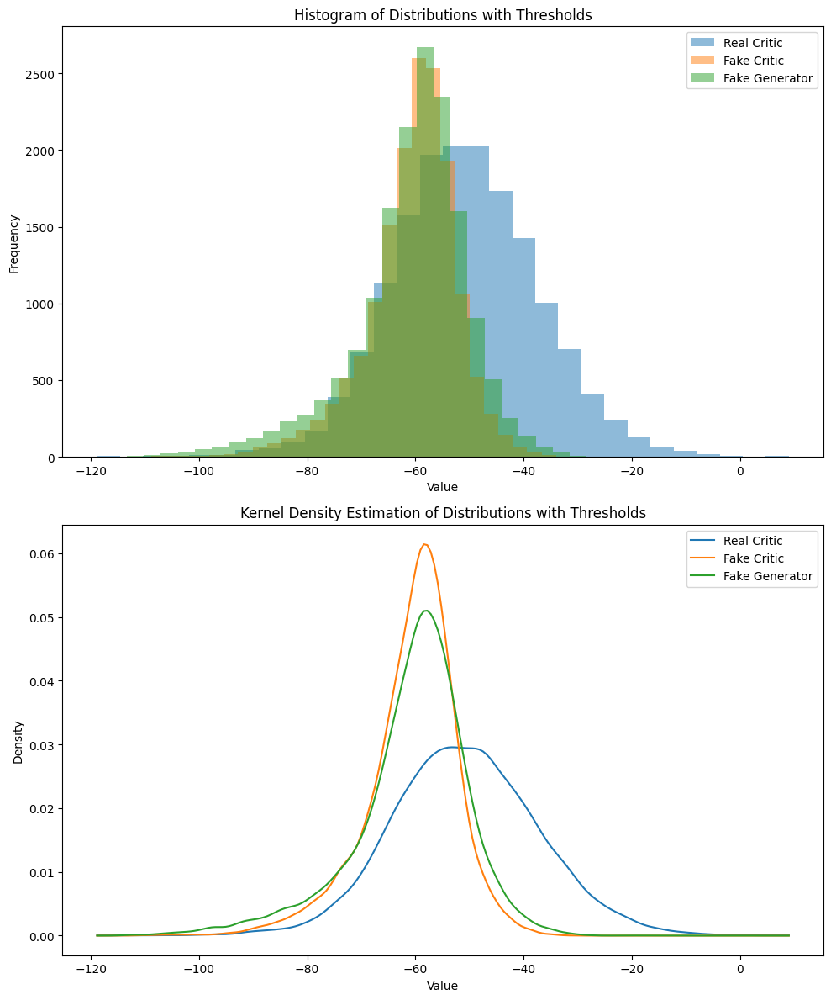

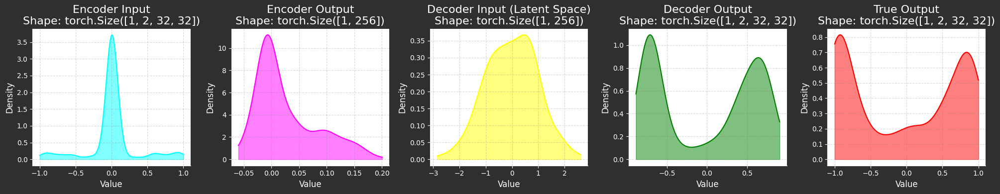

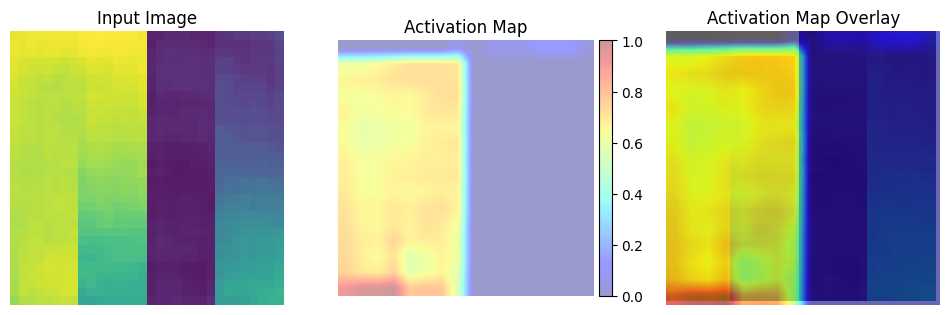

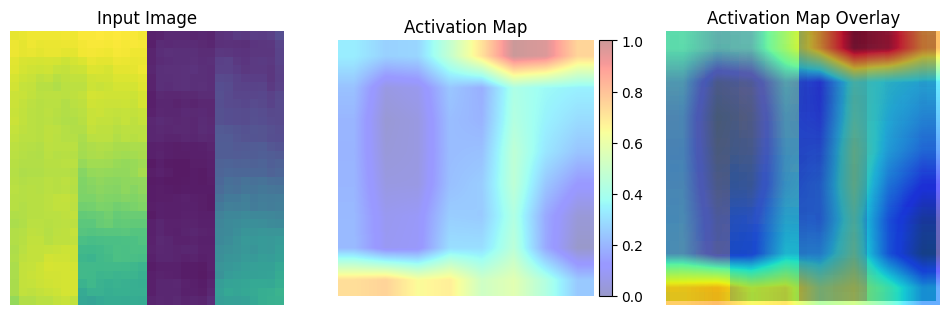

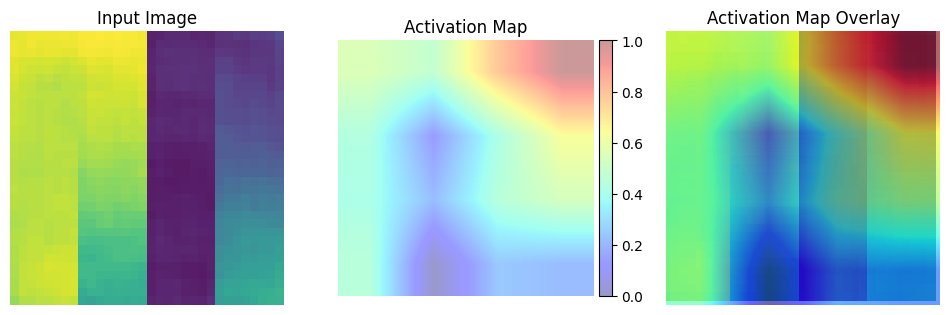

Batch [0/63] -  Critic loss:  -7.116671244303386 - generator loss:  461.3657531738281
Batch [21/63] -  Critic loss:  -7.800138133944887 - generator loss:  463.2733820134943
Batch [42/63] -  Critic loss:  -7.857104689575906 - generator loss:  462.57110098905343
	Epoch 61 - critic loss: -8.2686223580093 - generator loss: 460.24886745876734
Batch [0/63] -  Critic loss:  -10.794625918070475 - generator loss:  464.0826416015625
Batch [21/63] -  Critic loss:  -7.684552449168581 - generator loss:  462.1762487238104
Batch [42/63] -  Critic loss:  -8.716872627420944 - generator loss:  463.8574623285338
	Epoch 62 - critic loss: -9.017049841149147 - generator loss: 464.823965890067
Batch [0/63] -  Critic loss:  -5.593576113382976 - generator loss:  473.4690246582031
Batch [21/63] -  Critic loss:  -6.41659458478292 - generator loss:  469.3626695112749
Batch [42/63] -  Critic loss:  -6.826429437297258 - generator loss:  470.1609475778979
	Epoch 63 - critic loss: -7.039767454540919 - generator loss:

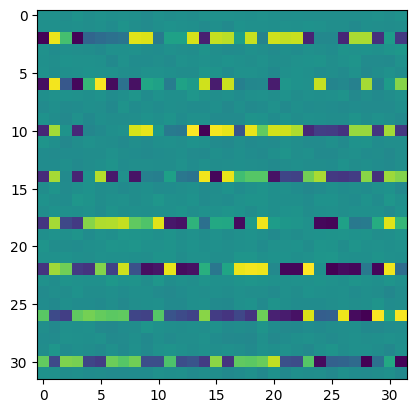

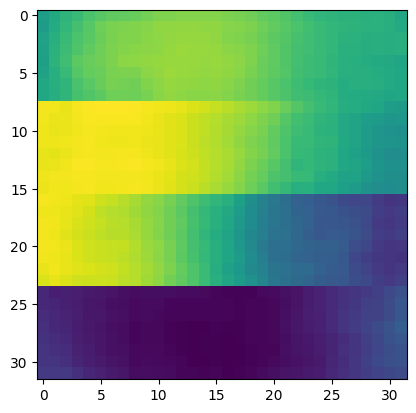

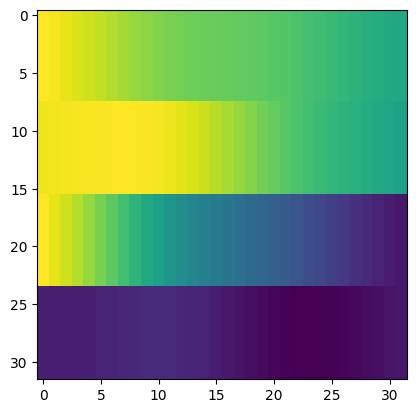

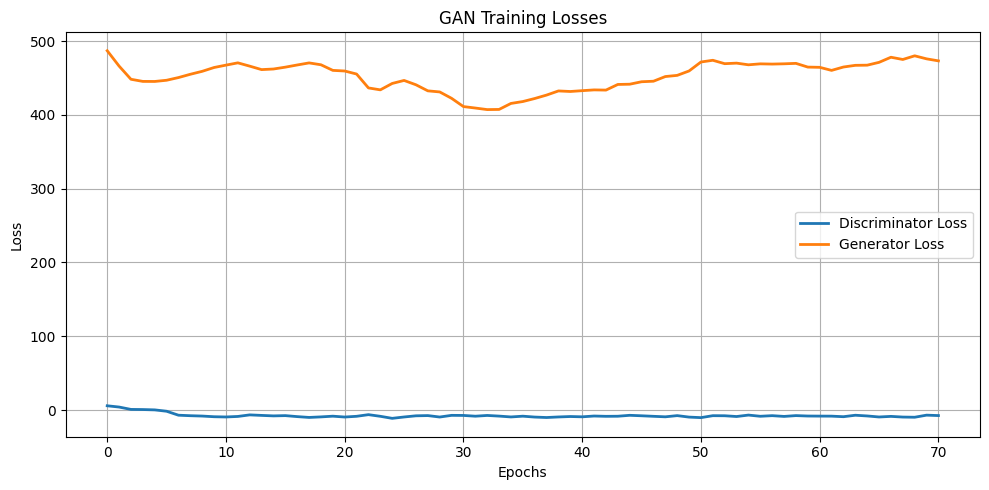

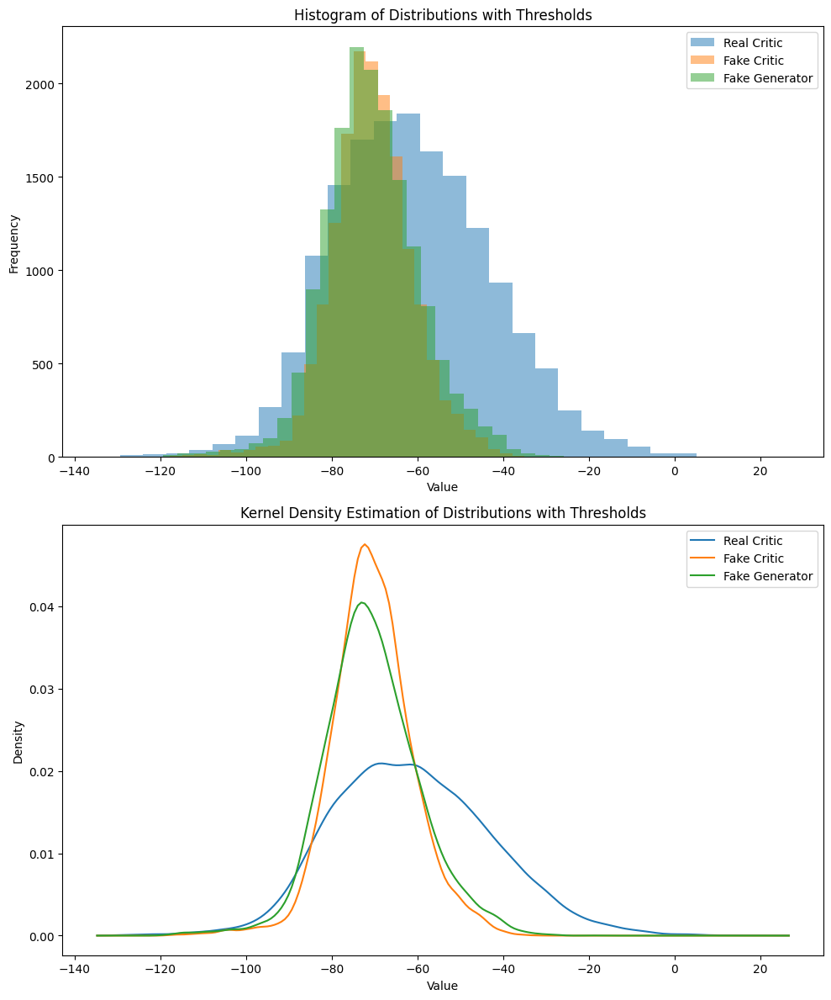

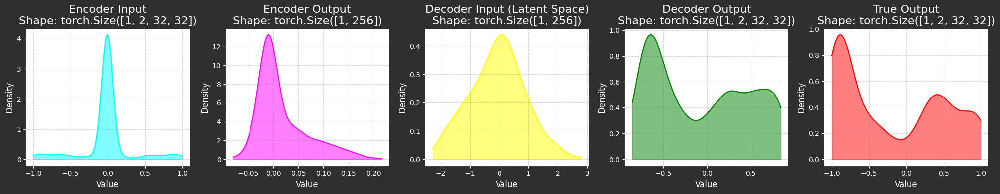

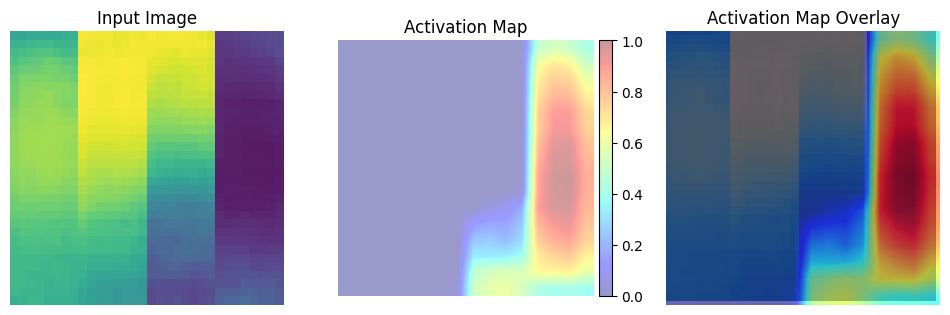

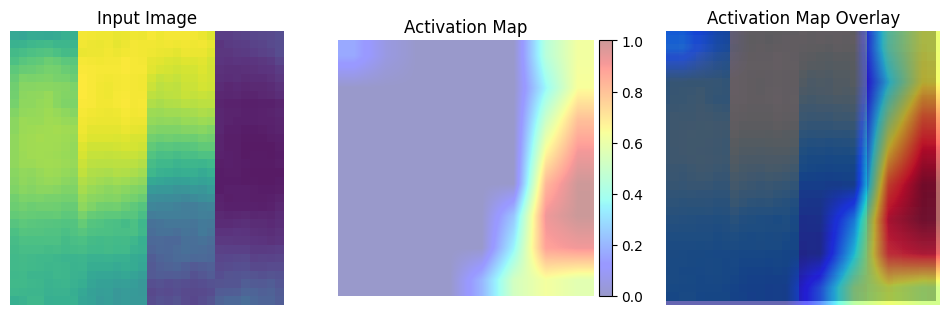

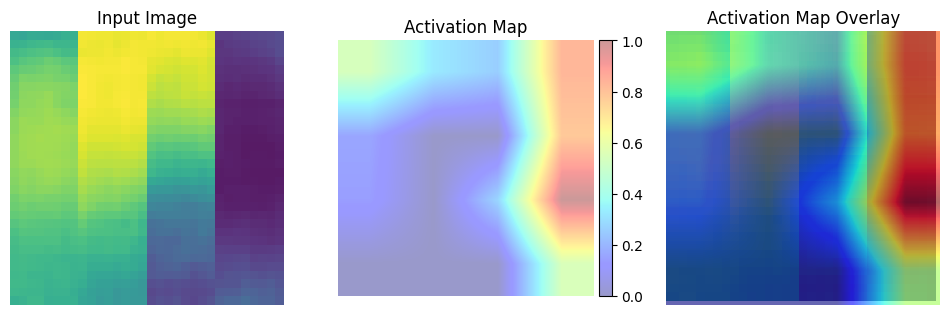

Batch [0/63] -  Critic loss:  -6.510783672332764 - generator loss:  473.15435791015625
Batch [21/63] -  Critic loss:  -6.625118884173307 - generator loss:  472.35426191850144
Batch [42/63] -  Critic loss:  -6.822399908258008 - generator loss:  472.87254085097203
	Epoch 71 - critic loss: -6.932478180638066 - generator loss: 469.7038981119792
	MNSE Score: 0.4002911926261962
Batch [0/63] -  Critic loss:  -7.457603136698405 - generator loss:  474.6773681640625
Batch [21/63] -  Critic loss:  -7.638145107211488 - generator loss:  472.08505110307175
Batch [42/63] -  Critic loss:  -7.659336363622385 - generator loss:  470.86696536041967
	Epoch 72 - critic loss: -7.900094599950882 - generator loss: 468.80785115559894
	MNSE Score: 0.3989330463939243
Batch [0/63] -  Critic loss:  -7.883816242218018 - generator loss:  472.2869567871094
Batch [21/63] -  Critic loss:  -8.20031992594401 - generator loss:  470.54302284934306
Batch [42/63] -  Critic loss:  -8.146464850551398 - generator loss:  468.0741

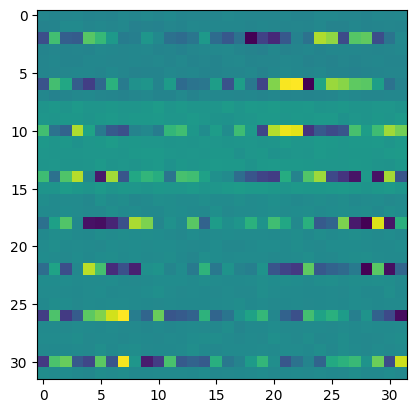

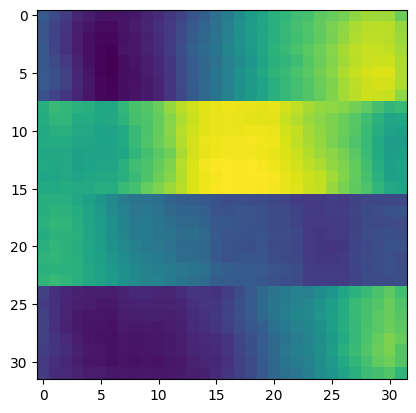

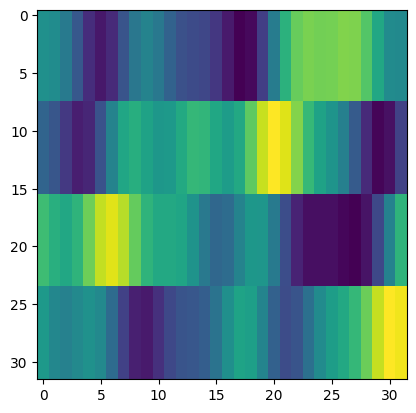

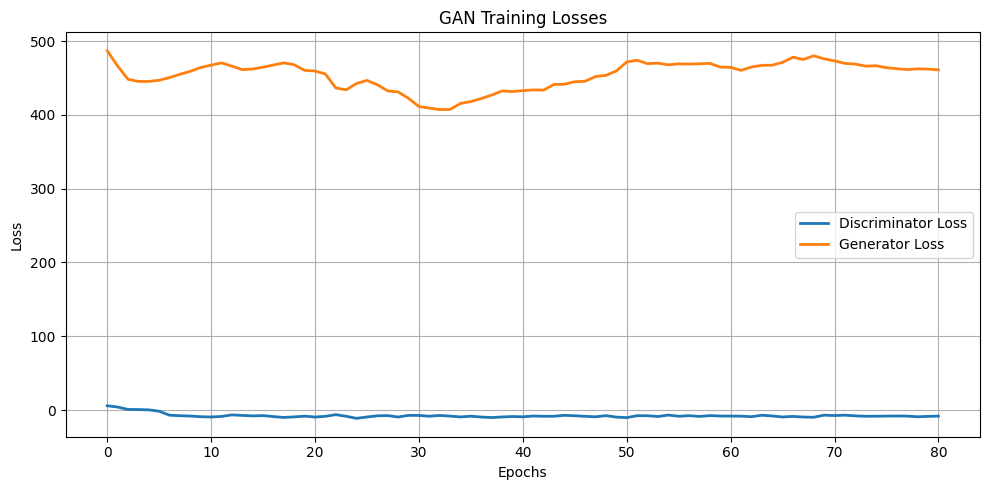

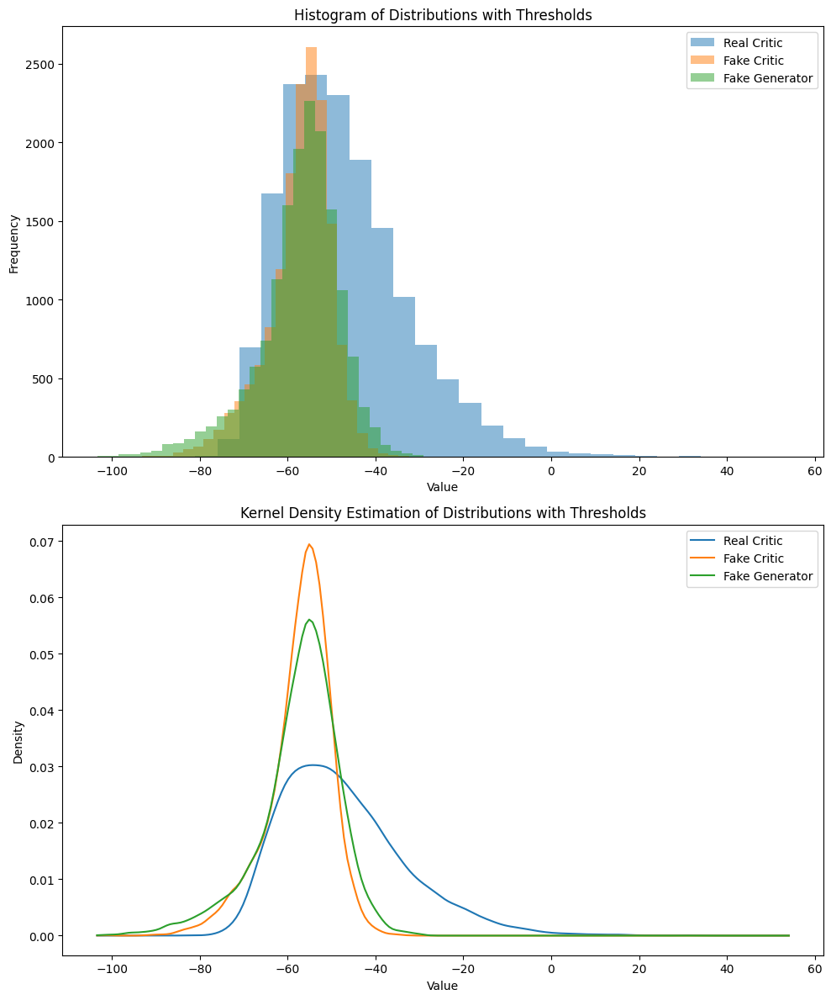

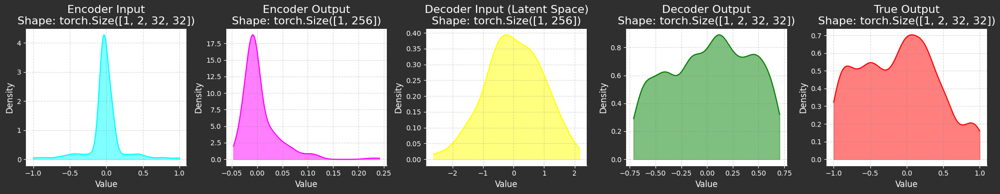

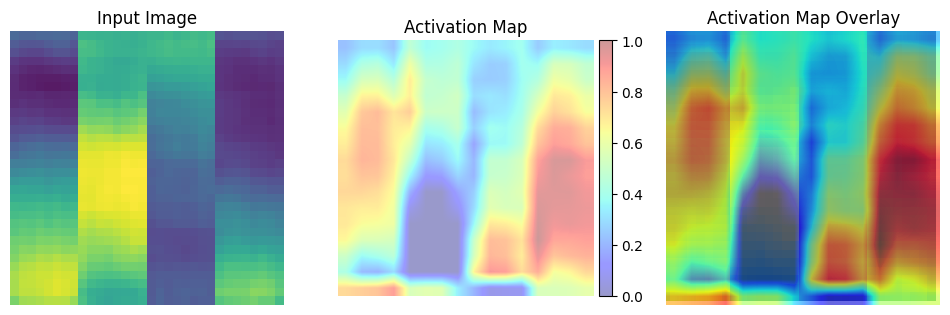

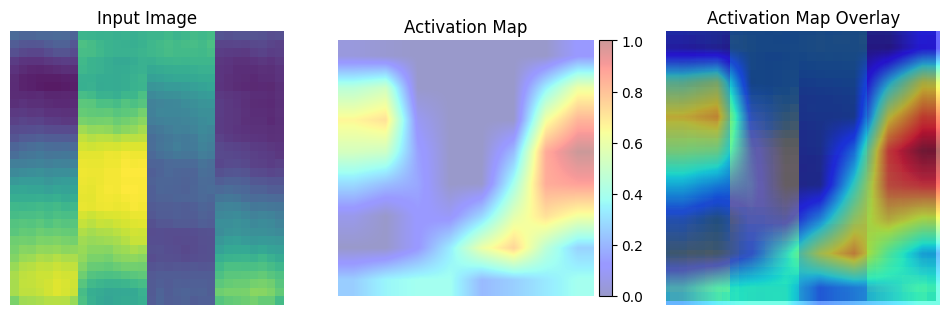

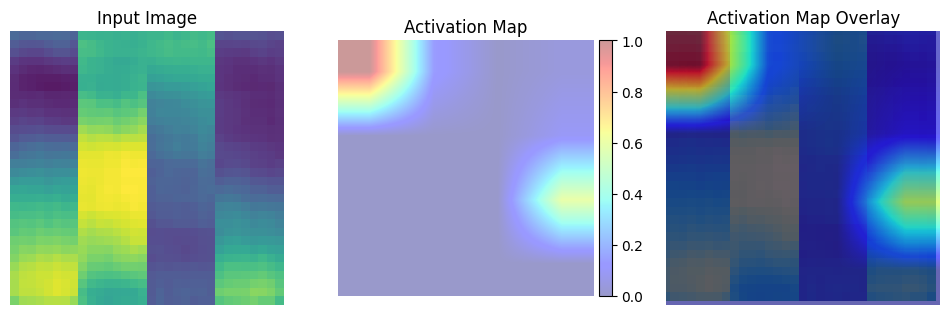

Batch [0/63] -  Critic loss:  -8.25959046681722 - generator loss:  462.31732177734375
Batch [21/63] -  Critic loss:  -7.338143121112474 - generator loss:  458.8988494873047
Batch [42/63] -  Critic loss:  -6.867349131162777 - generator loss:  458.96248821879544
	Epoch 81 - critic loss: -6.902222975221261 - generator loss: 457.159911140563
Batch [0/63] -  Critic loss:  -6.709305922190349 - generator loss:  452.49249267578125
Batch [21/63] -  Critic loss:  -7.154969670555809 - generator loss:  459.46446228027344
Batch [42/63] -  Critic loss:  -7.239600336828896 - generator loss:  456.7081965956577
	Epoch 82 - critic loss: -7.629711173829578 - generator loss: 453.52472505115327
Batch [0/63] -  Critic loss:  -9.840261141459147 - generator loss:  457.8804016113281
Batch [21/63] -  Critic loss:  -9.142690687468557 - generator loss:  455.6504114324396
Batch [42/63] -  Critic loss:  -10.149792338526526 - generator loss:  456.44408895803053
	Epoch 83 - critic loss: -9.599812898686324 - generator

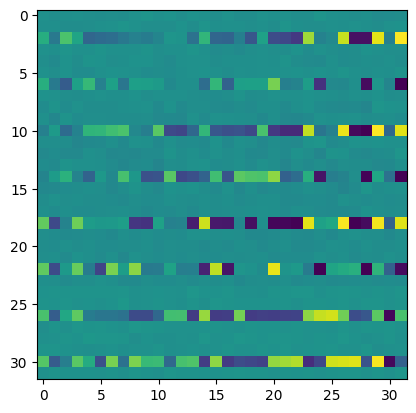

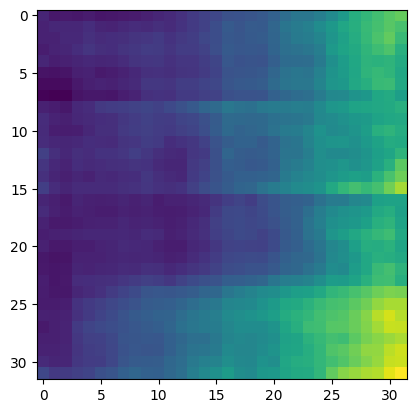

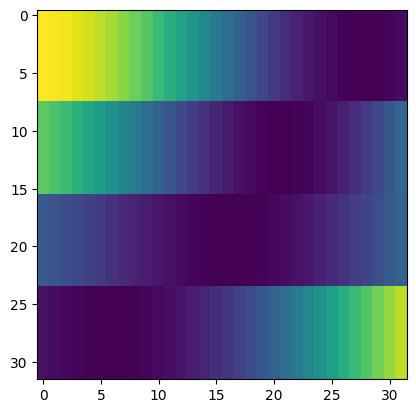

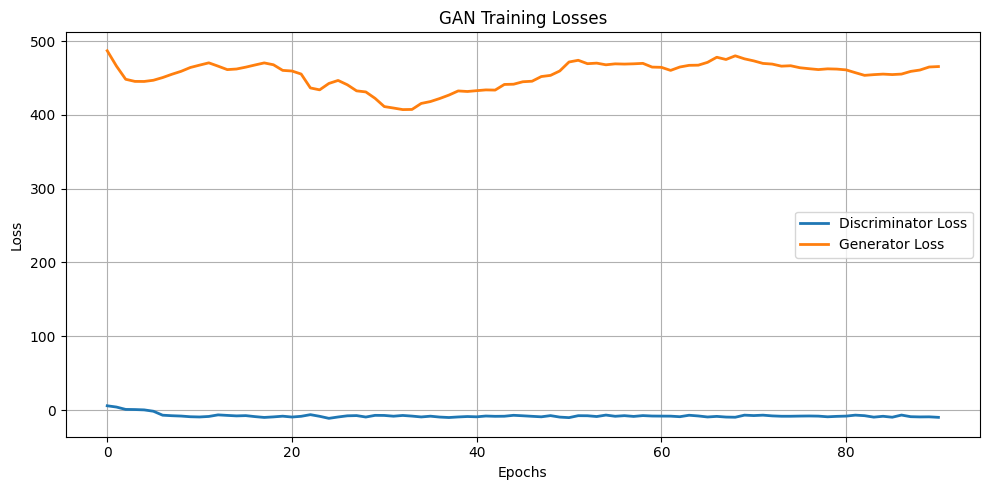

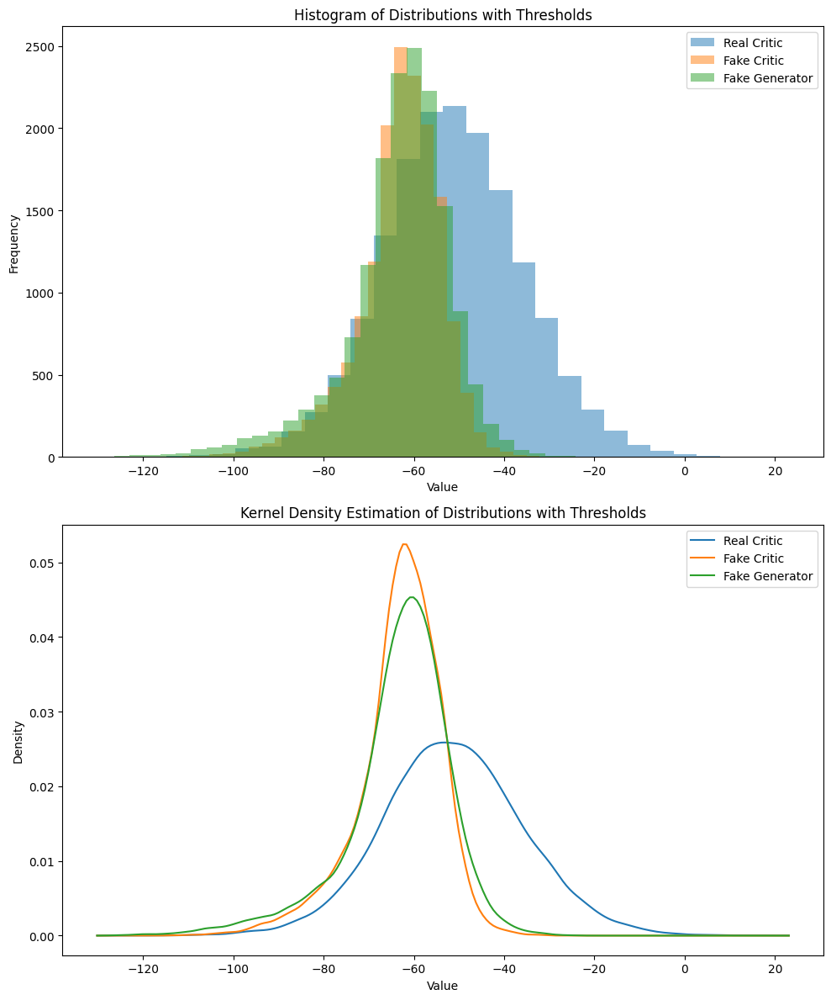

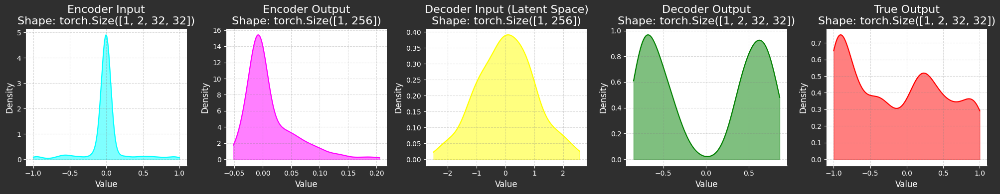

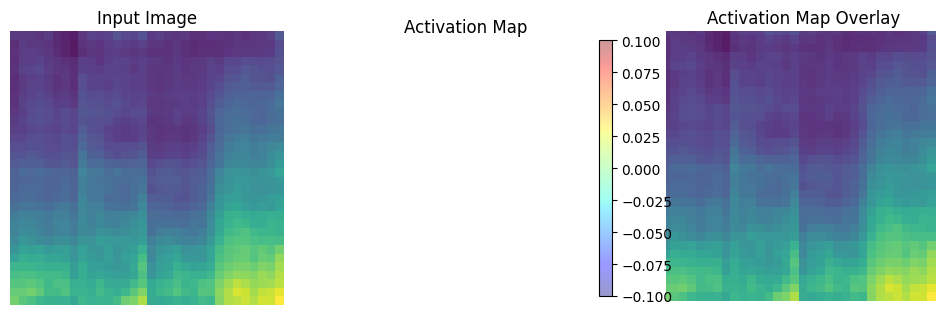

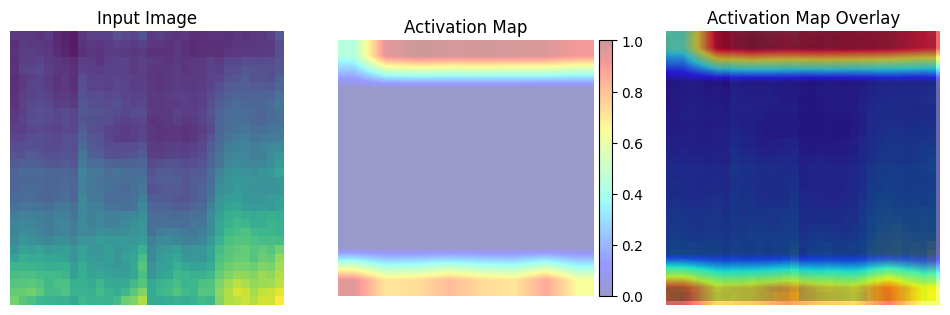

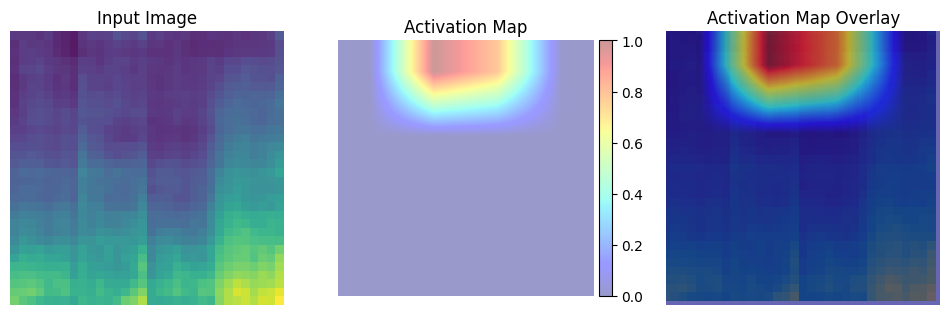

Batch [0/63] -  Critic loss:  -7.078377882639567 - generator loss:  473.86236572265625
Batch [21/63] -  Critic loss:  -7.20303498614918 - generator loss:  469.4453194358132
Batch [42/63] -  Critic loss:  -8.09345559556355 - generator loss:  469.56658935546875
	Epoch 91 - critic loss: -8.578736706385538 - generator loss: 467.7710702078683
Batch [0/63] -  Critic loss:  -13.39037291208903 - generator loss:  467.195068359375
Batch [21/63] -  Critic loss:  -10.895498543074636 - generator loss:  475.37232832475144
Batch [42/63] -  Critic loss:  -9.585231097169627 - generator loss:  474.29777633312136
	Epoch 92 - critic loss: -9.98704832193082 - generator loss: 472.44815547882564
	MNSE Score: 0.39588442870548796
Batch [0/63] -  Critic loss:  -5.313939571380615 - generator loss:  472.86956787109375
Batch [21/63] -  Critic loss:  -6.967820738301132 - generator loss:  473.715971513228
Batch [42/63] -  Critic loss:  -7.173047446465305 - generator loss:  472.37108665288883
	Epoch 93 - critic loss:

In [34]:
channel_est_wgan_gp_vae_multi_antenna()

## VAE + WGAN-GP + Skewness loss

In [35]:
vae = VAE(z_dim=z_dim).to(device)
critic = Critic().to(device)

# Initialize weights
vae = vae.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
vae_opt = torch.optim.Adam(vae.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)

save_results = "channel_est_wgan_gp_based_vae_skew_multi_antenna"

In [36]:
def channel_est_wgan_gp_vae_threwness():
    save_results = "channel_est_wgan_gp_based_vae_skew_multi_antenna"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        g_skewness = 0
        nmse_scores = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        vae.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()


                # Forward pass
                fake, *values = vae(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)

                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss
                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            vae_opt.zero_grad()

            # get noise
            # Forward pass
            fake_2, *values = vae(label)

            # Compute loss
            v_loss, *values = vae_loss(fake_2, real, *values)


            critic_fake_2 = critic(fake_2)

            skew_loss_2 = l2_loss(skew_cal(real.view(real.size(0), -1)),skew_cal(fake_2.view(fake_2.size(0), -1)))

            g_loss = - torch.mean(critic_fake_2) + skew_loss_2 + v_loss


            # Update gradients
            g_loss.backward()

            # Update the weights
            vae_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))
            g_skewness += skew_loss_2.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse_func(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))
        total_skewness.append(g_skewness / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        vae.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake, *values = vae(label)
                _, _, (input_decoder, output_encoder) = values
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:].T)
            show_tensor_images(real[0,0,:,:].T)
            show_loss_images(total_c_losses, total_g_losses)

            # grad_cam = GradCam(critic, critic.critic[-3])
            # grad_cam_1 = GradCam(critic, critic.critic[-2])
            # grad_cam_2 = GradCam(critic, critic.critic[-1])
            # grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            # grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            # grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            plot_vae_in_out(label, fake, input_decoder, output_encoder, real)


            grad_cam = GradCam(critic, critic.critic[-3][0])
            grad_cam_1 = GradCam(critic, critic.critic[-2][0])
            grad_cam_2 = GradCam(critic, critic.critic[-1][0])
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            save_checkpoint(vae, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")
            plot_generated_image(
                fake[0,0,:,:].T,
                test_input=label[0,0,:,:].T,
                tar=real[0,0,:,:].T,
                prefix=save_results,
            )
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

        plot_skewness_func(
            total_skewness,
            range(epoch + 1),
            img_path=f"results/skewness/{save_results}/skewness.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] -  Critic loss:  9.905587196350098 - generator loss:  502.65576171875
Batch [21/63] -  Critic loss:  5.694859110947812 - generator loss:  491.8565604469993
Batch [42/63] -  Critic loss:  5.1545177411663445 - generator loss:  491.4933265863463
	Epoch 0 - critic loss: 5.034289432581139 - generator loss: 483.22944713774183


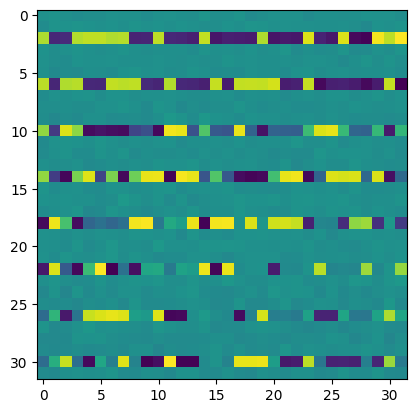

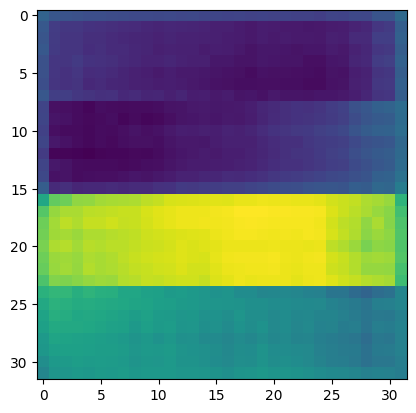

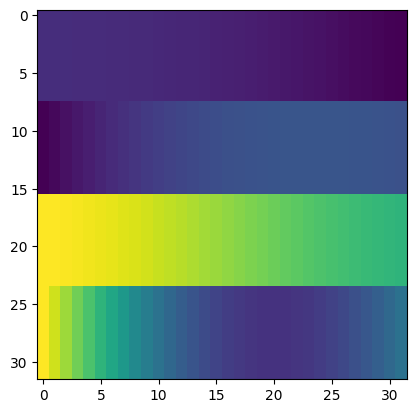

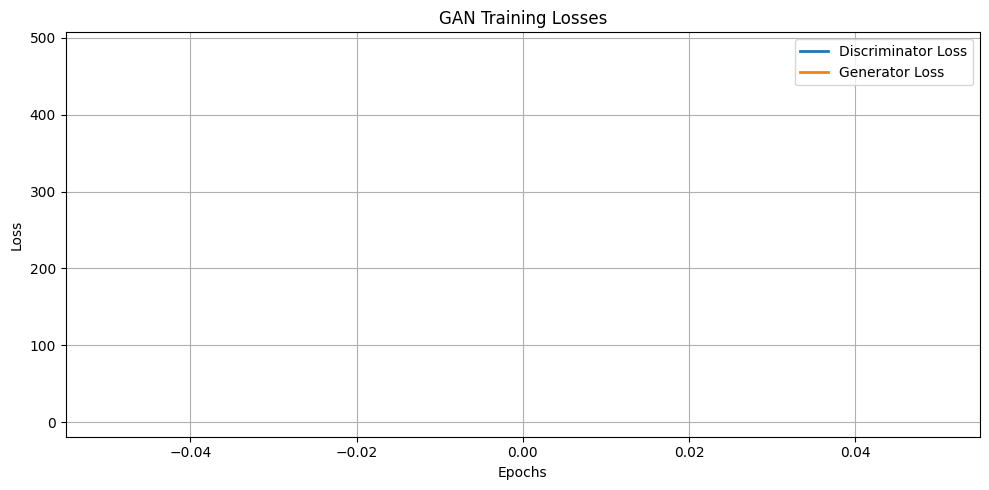

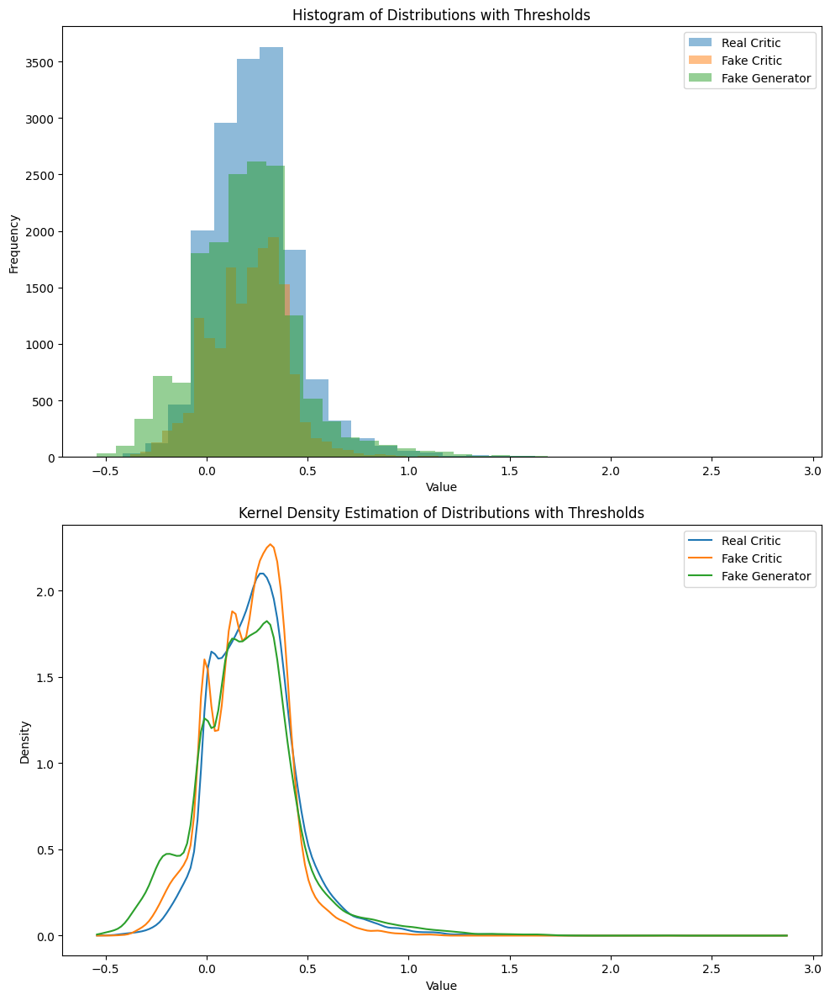

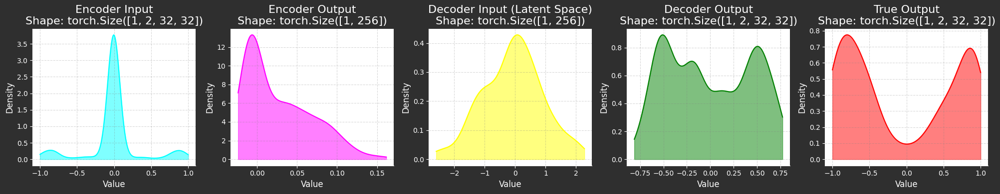

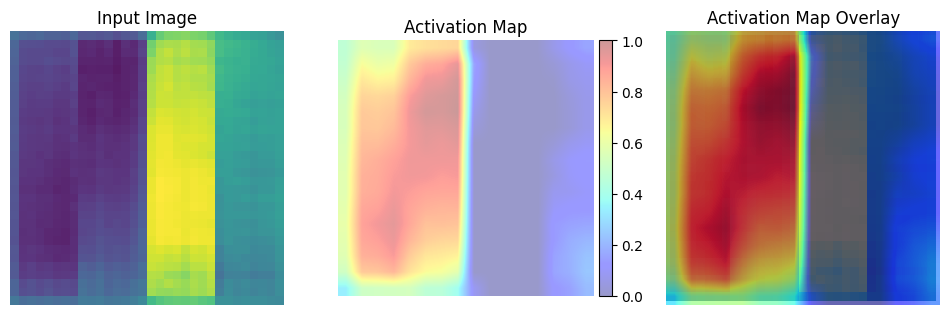

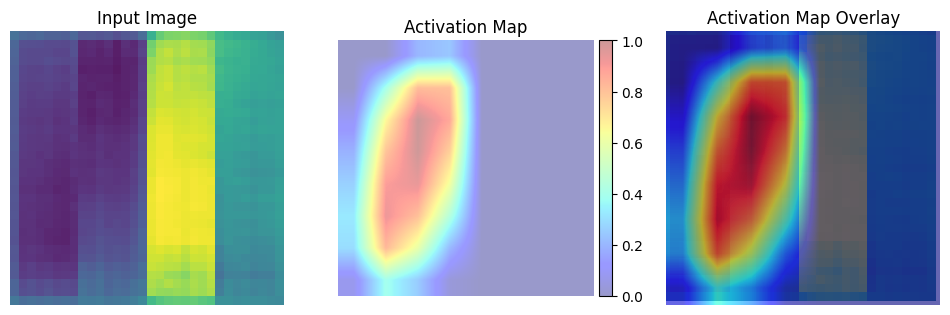

<ipython-input-24-b68e3bf66b4b>:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


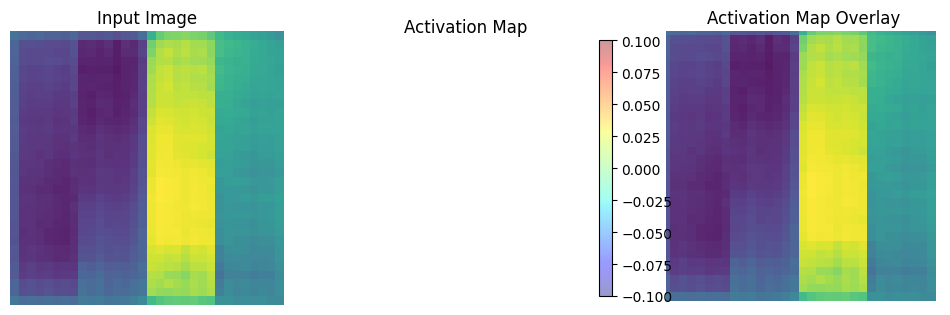

	MNSE Score: 0.9370833767784966
Batch [0/63] -  Critic loss:  2.9079498449961343 - generator loss:  463.1694641113281
Batch [21/63] -  Critic loss:  3.216098330237648 - generator loss:  458.61529541015625
Batch [42/63] -  Critic loss:  3.0287571350733438 - generator loss:  457.10399822856107
	Epoch 1 - critic loss: 3.052616479220213 - generator loss: 453.62299068390377
	MNSE Score: 0.6862671583417862
Batch [0/63] -  Critic loss:  1.0591286619504292 - generator loss:  451.05419921875
Batch [21/63] -  Critic loss:  1.1236565898765216 - generator loss:  452.45044361461294
Batch [42/63] -  Critic loss:  1.382066924211591 - generator loss:  452.7034138524255
	Epoch 2 - critic loss: 1.4739537193346282 - generator loss: 450.68499658978175
	MNSE Score: 0.6629098086130052
Batch [0/63] -  Critic loss:  1.3114737073580425 - generator loss:  446.6165771484375
Batch [21/63] -  Critic loss:  0.4261595936435642 - generator loss:  449.0384244051847
Batch [42/63] -  Critic loss:  0.31953619270361666 - 

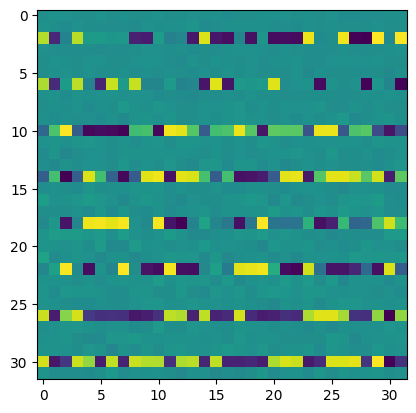

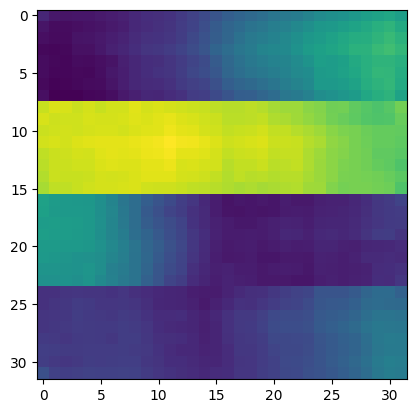

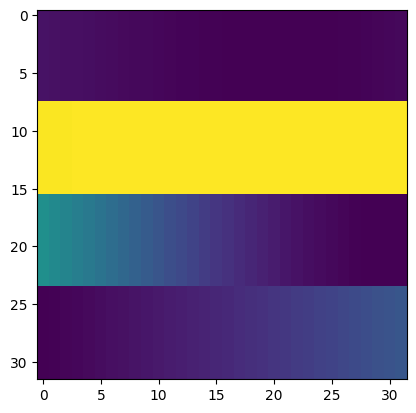

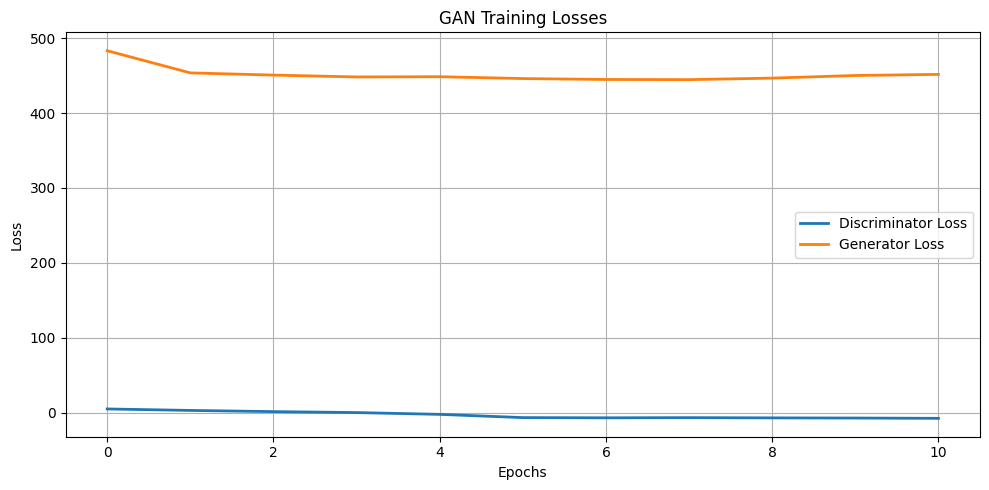

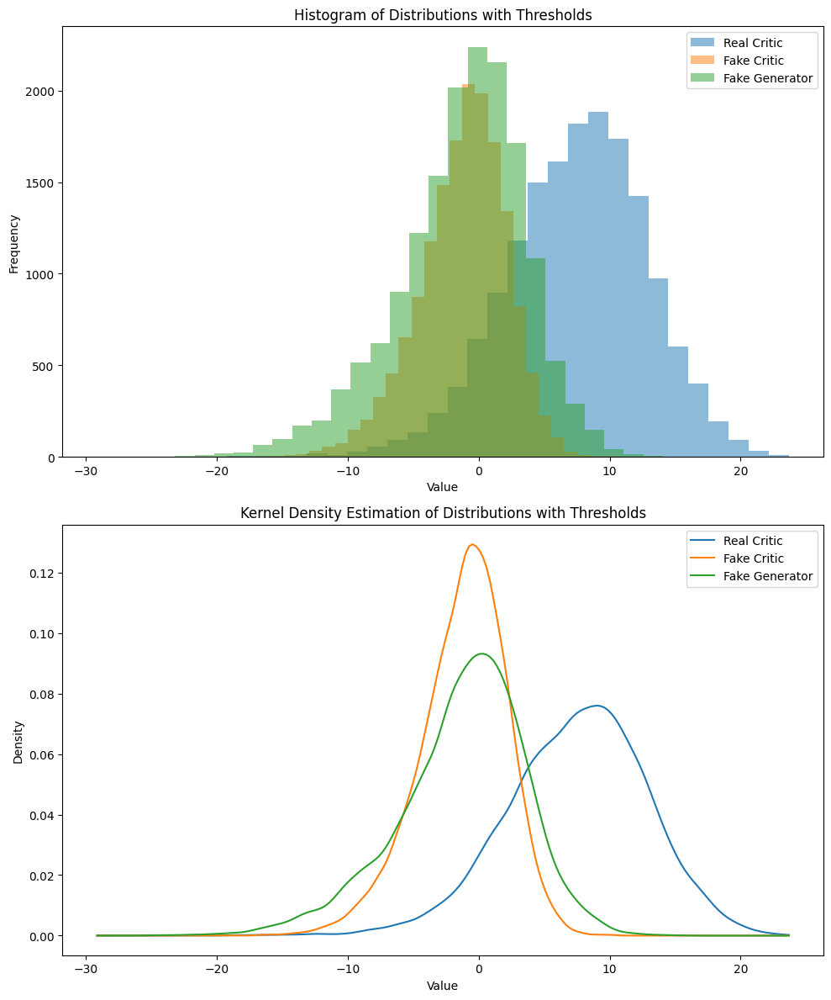

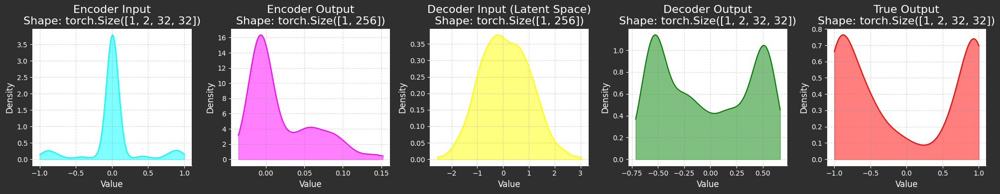

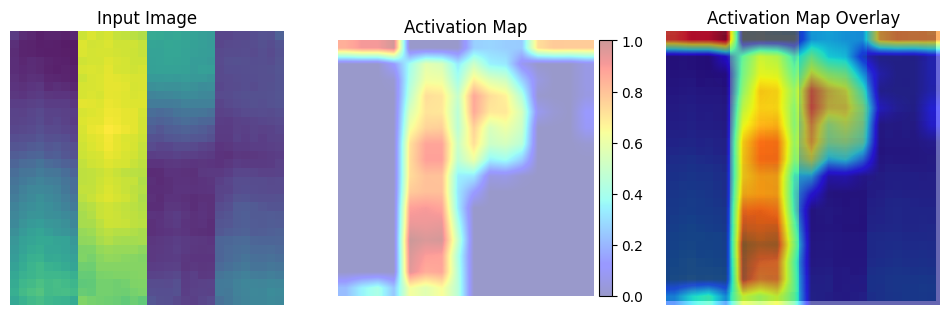

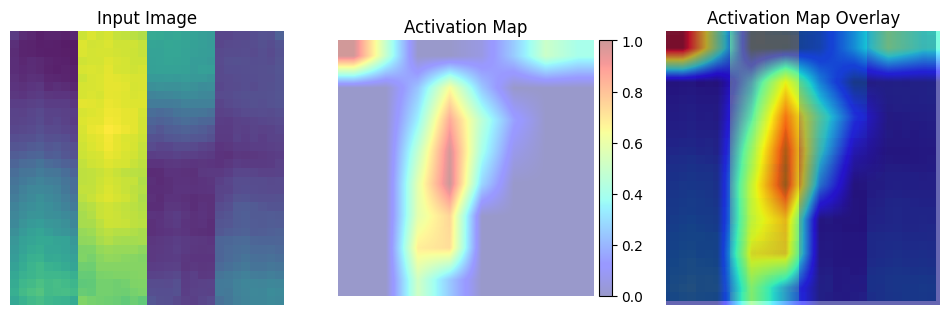

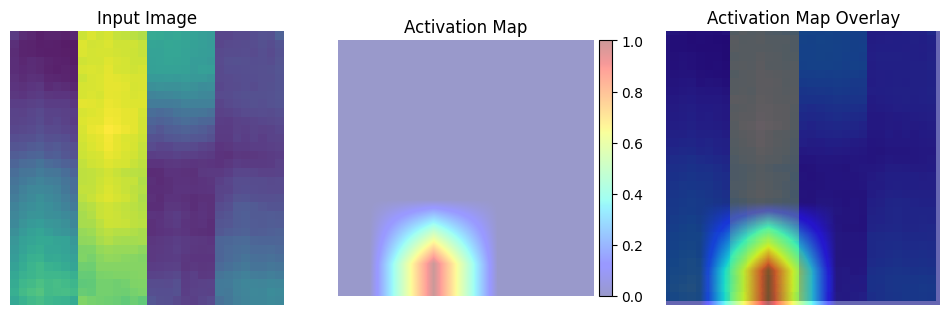

	MNSE Score: 0.6298137893752446
Batch [0/63] -  Critic loss:  -7.964167435963948 - generator loss:  453.4267272949219
Batch [21/63] -  Critic loss:  -8.127048160090592 - generator loss:  454.5945545543324
Batch [42/63] -  Critic loss:  -8.18385145645733 - generator loss:  454.3060118209484
	Epoch 11 - critic loss: -7.986991829342313 - generator loss: 450.96631973508806
	MNSE Score: 0.6244896924684918
Batch [0/63] -  Critic loss:  -9.532224337259928 - generator loss:  453.0325622558594
Batch [21/63] -  Critic loss:  -9.094707279494315 - generator loss:  454.6538654674183
Batch [42/63] -  Critic loss:  -8.713780310726905 - generator loss:  455.01936730673145
	Epoch 12 - critic loss: -8.497276525648813 - generator loss: 452.04185074094744
	MNSE Score: 0.6234455666844807
Batch [0/63] -  Critic loss:  -7.287942727406819 - generator loss:  451.1283264160156
Batch [21/63] -  Critic loss:  -6.1756527044556355 - generator loss:  450.6658214222301
Batch [42/63] -  Critic loss:  -6.26381431901177

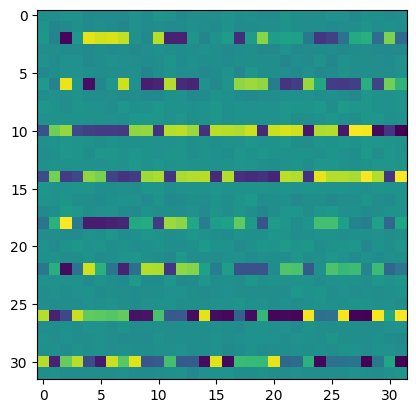

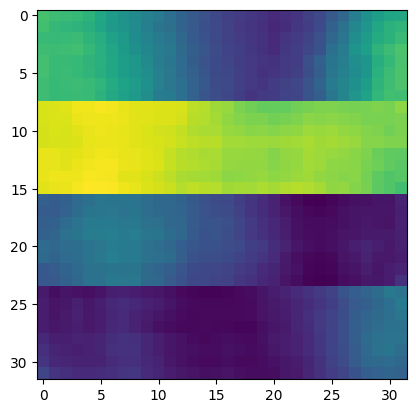

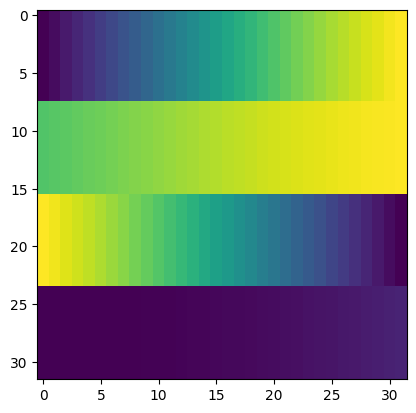

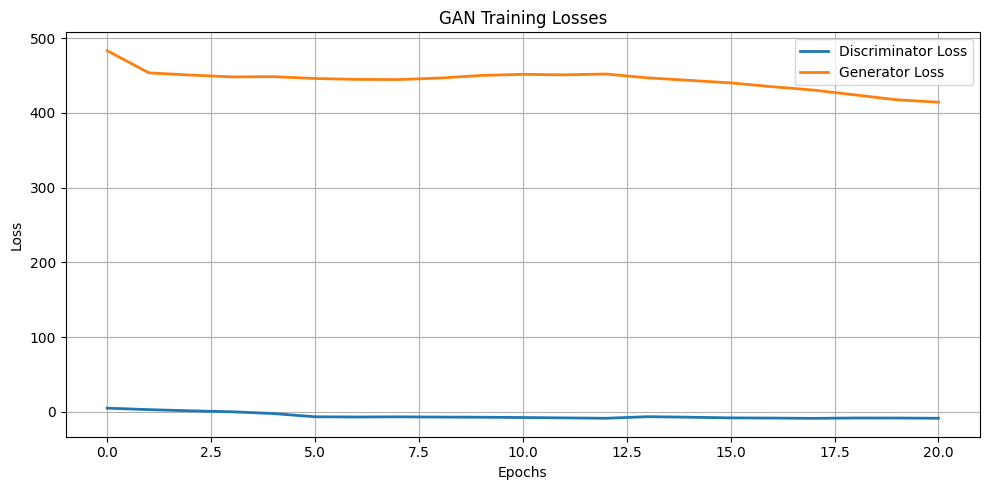

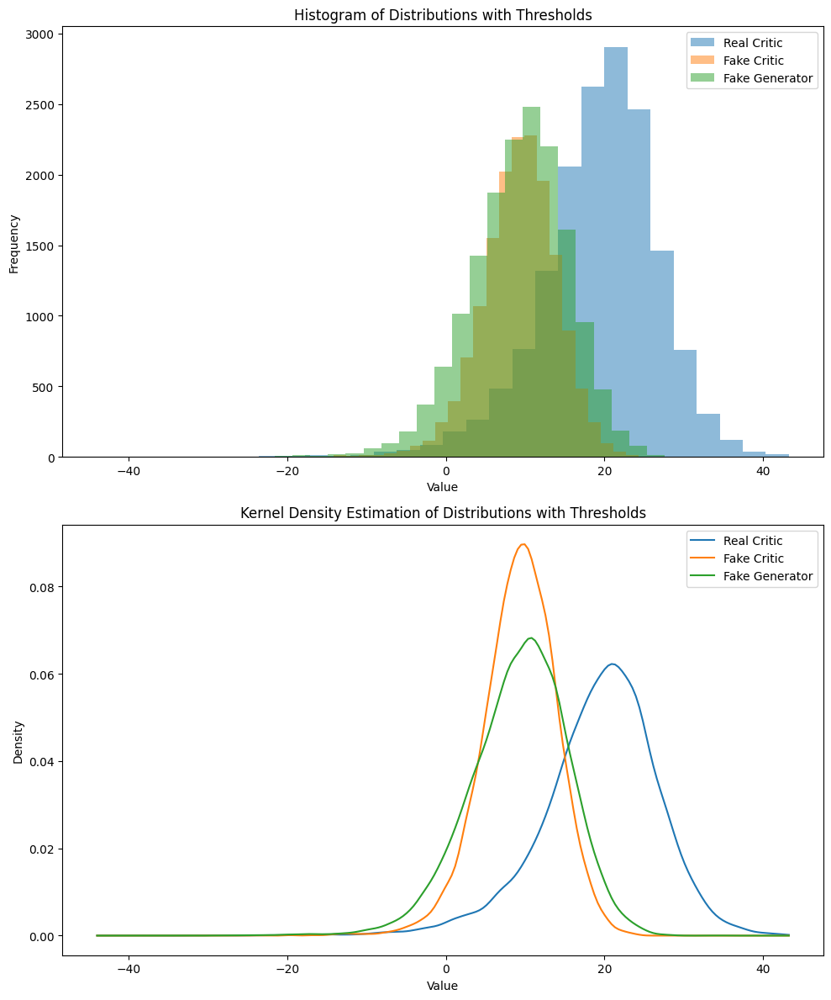

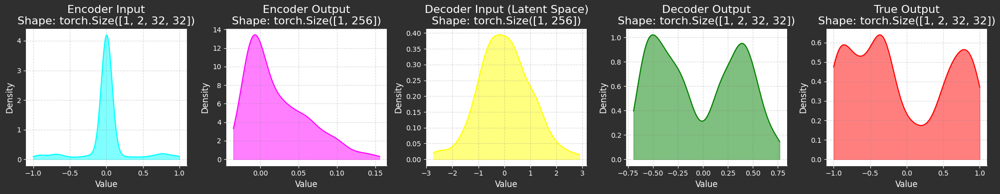

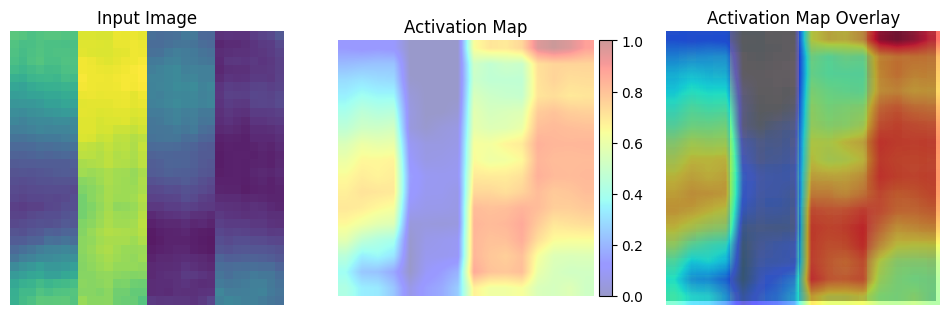

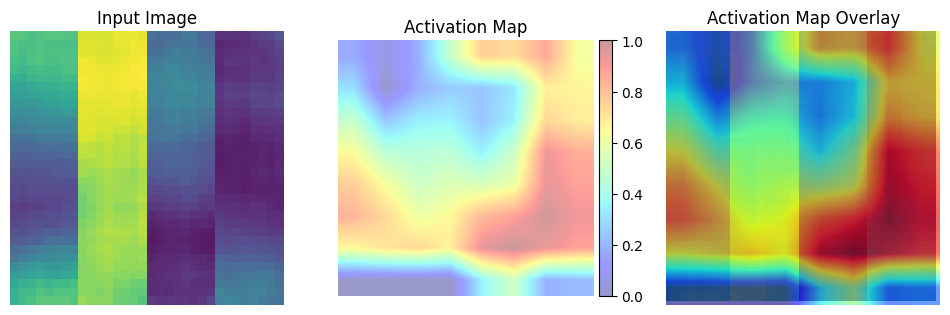

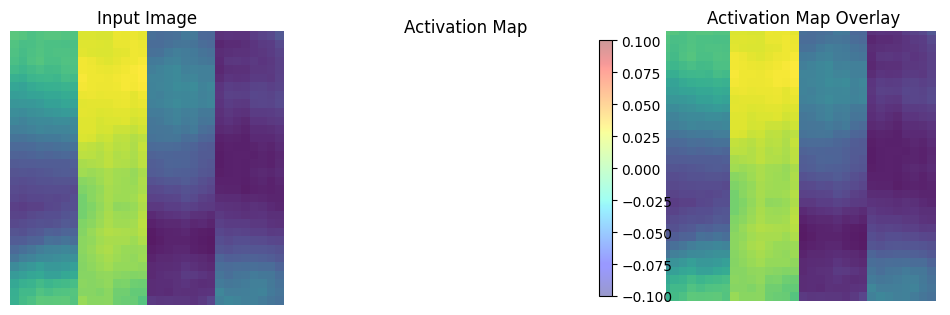

	MNSE Score: 0.4891454161159576
Batch [0/63] -  Critic loss:  -8.61666202545166 - generator loss:  419.0804748535156
Batch [21/63] -  Critic loss:  -8.3695777907516 - generator loss:  415.5388169722124
Batch [42/63] -  Critic loss:  -8.818157310633692 - generator loss:  414.57427552688955
	Epoch 21 - critic loss: -8.78395802129513 - generator loss: 412.0035666813926
	MNSE Score: 0.4768139147569263
Batch [0/63] -  Critic loss:  -8.791929880777994 - generator loss:  414.9129943847656
Batch [21/63] -  Critic loss:  -7.977973526174372 - generator loss:  411.9991885098544
Batch [42/63] -  Critic loss:  -7.749720322069273 - generator loss:  410.2791080918423
	Epoch 22 - critic loss: -8.166192122868129 - generator loss: 408.68896435934397
	MNSE Score: 0.4645793546759893
Batch [0/63] -  Critic loss:  -7.009889602661133 - generator loss:  417.90771484375
Batch [21/63] -  Critic loss:  -7.874728405114377 - generator loss:  412.11232965642756
Batch [42/63] -  Critic loss:  -8.059268988380136 - ge

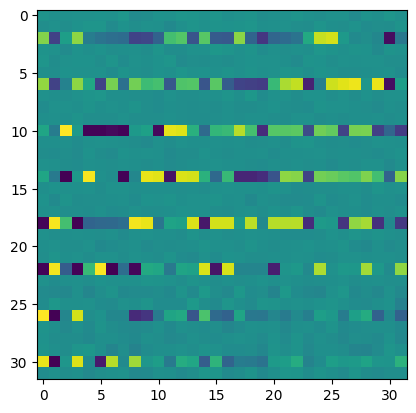

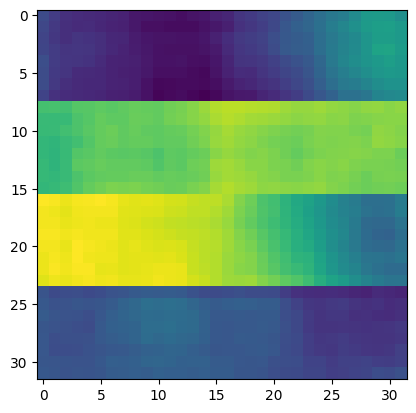

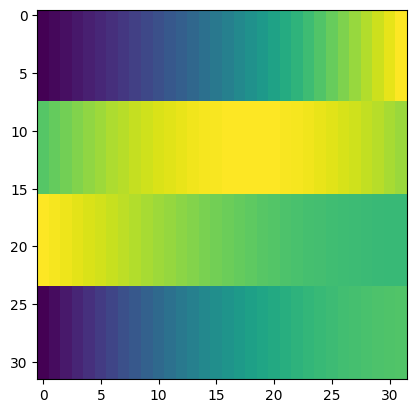

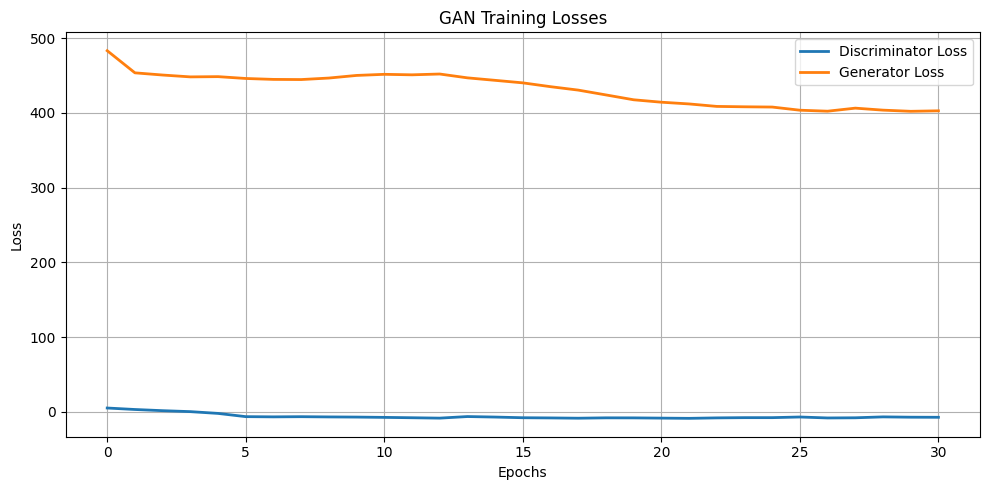

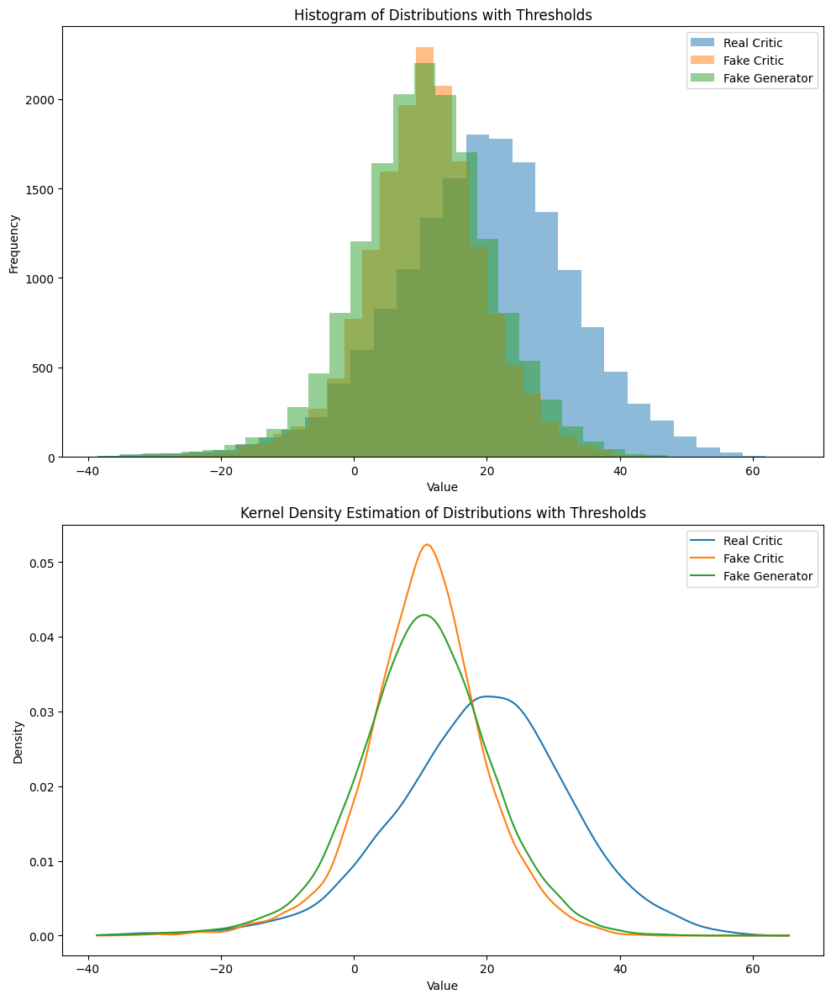

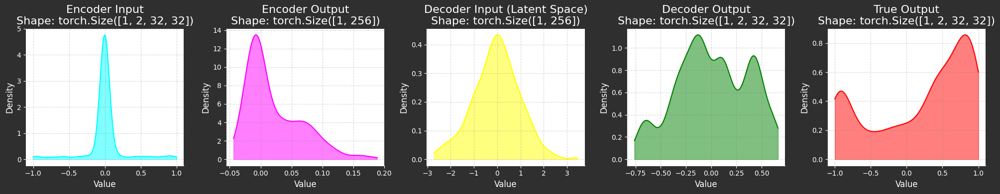

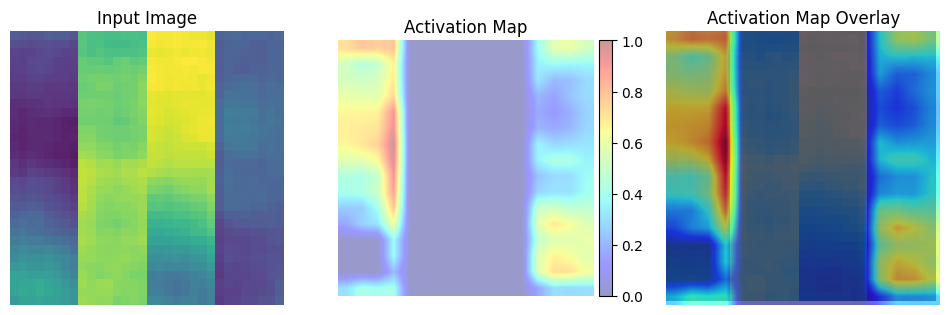

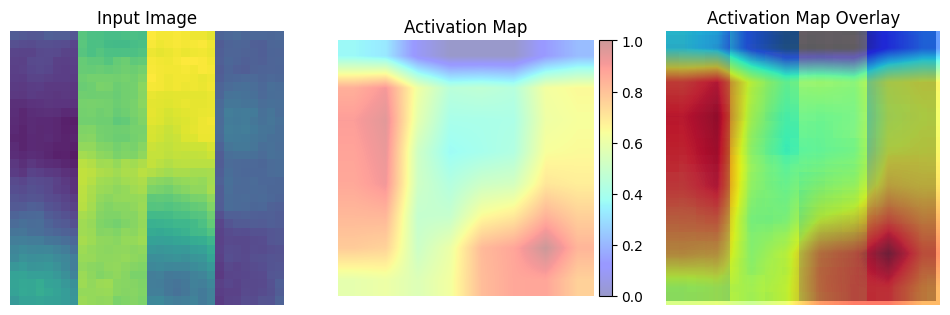

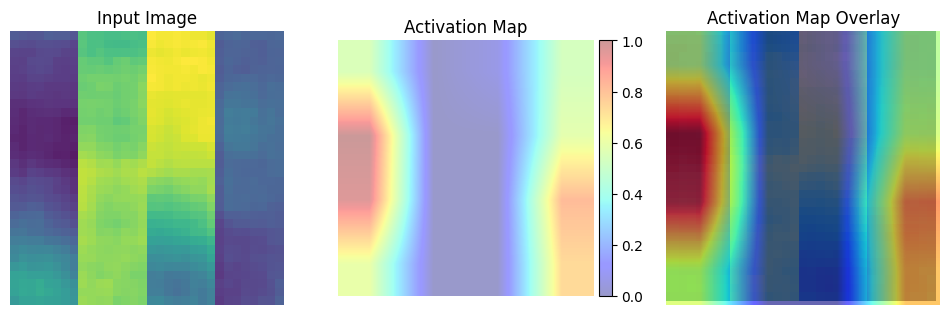

	MNSE Score: 0.43677246949029347
Batch [0/63] -  Critic loss:  -8.851951281229654 - generator loss:  407.6219177246094
Batch [21/63] -  Critic loss:  -8.12794957738934 - generator loss:  405.8504624800249
Batch [42/63] -  Critic loss:  -8.064511720524276 - generator loss:  406.7393607206123
	Epoch 31 - critic loss: -8.117844823807005 - generator loss: 404.592767624628
	MNSE Score: 0.43236573111443294
Batch [0/63] -  Critic loss:  -7.0933966636657715 - generator loss:  410.0296325683594
Batch [21/63] -  Critic loss:  -7.945857763290404 - generator loss:  407.1042078191584
Batch [42/63] -  Critic loss:  -7.885149501090825 - generator loss:  406.48856797329216
	Epoch 32 - critic loss: -7.808441104081571 - generator loss: 403.9322001139323
	MNSE Score: 0.4280718356843979
Batch [0/63] -  Critic loss:  -8.43738873799642 - generator loss:  405.5640563964844
Batch [21/63] -  Critic loss:  -7.830411296902281 - generator loss:  405.52602455832744
Batch [42/63] -  Critic loss:  -7.644701576972195

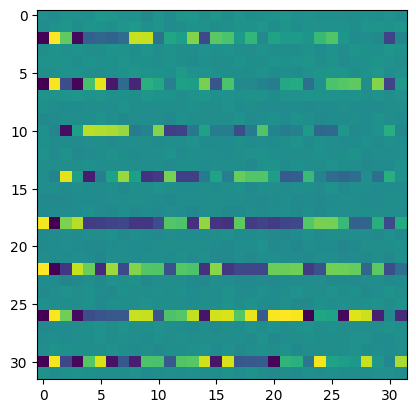

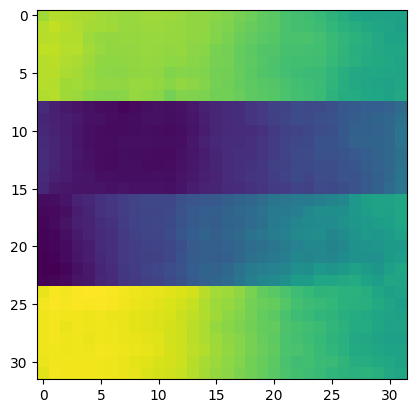

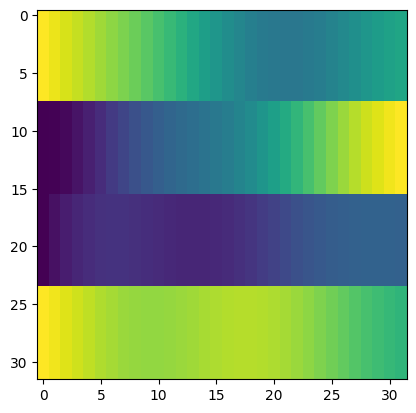

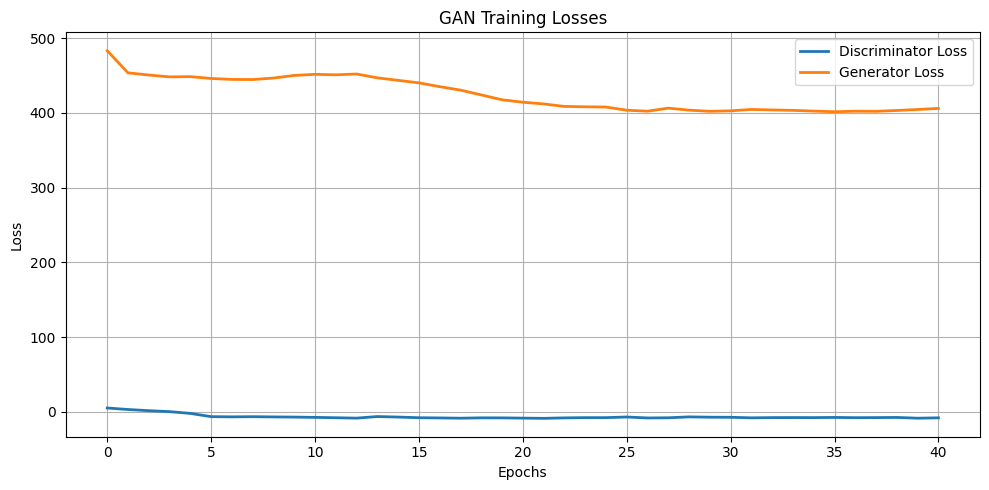

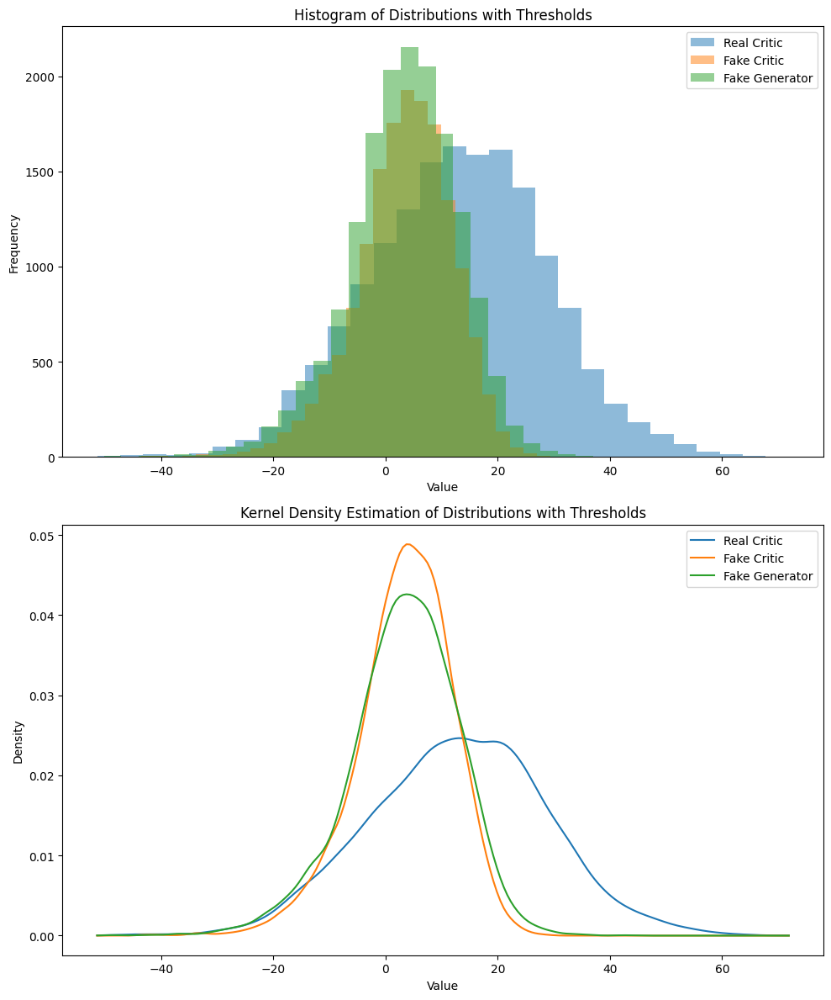

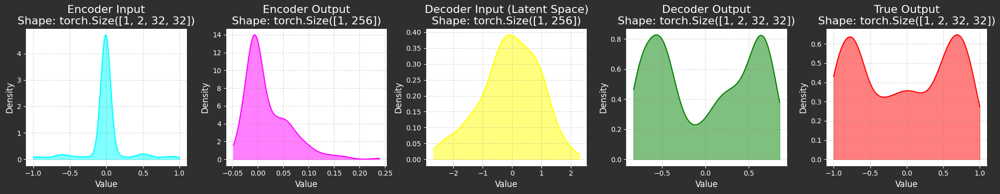

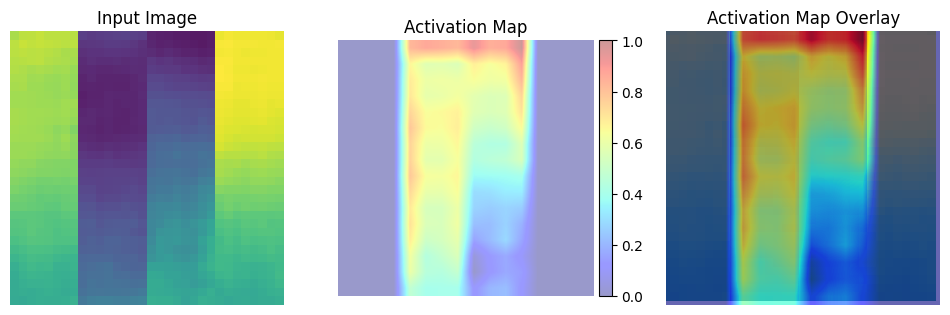

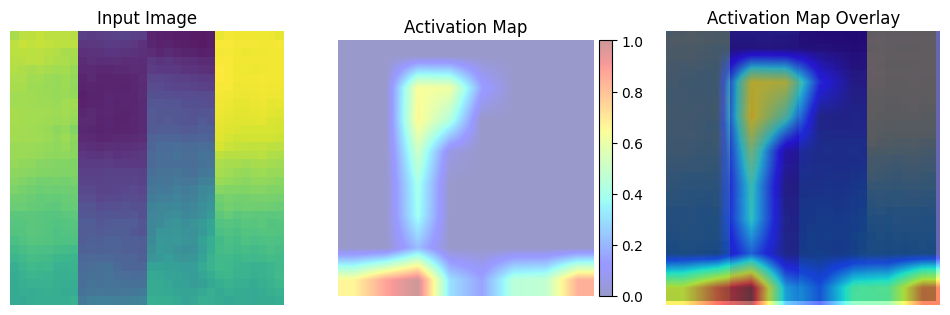

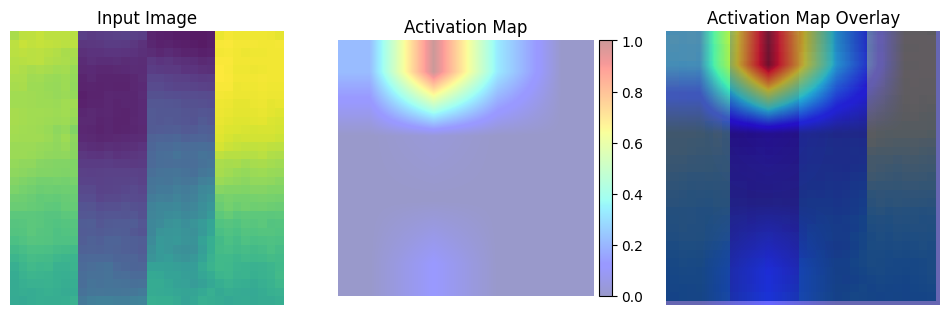

	MNSE Score: 0.4151654352271368
Batch [0/63] -  Critic loss:  -8.101892789204916 - generator loss:  409.6101379394531
Batch [21/63] -  Critic loss:  -9.160815311200693 - generator loss:  409.5664437033913
Batch [42/63] -  Critic loss:  -8.941270210946255 - generator loss:  410.5137903967569
	Epoch 41 - critic loss: -8.851355295332652 - generator loss: 408.5457235669333
	MNSE Score: 0.4119165610699427
Batch [0/63] -  Critic loss:  -11.15654214223226 - generator loss:  423.138916015625
Batch [21/63] -  Critic loss:  -7.889216126817646 - generator loss:  414.02244706587356
Batch [42/63] -  Critic loss:  -7.287666949190836 - generator loss:  413.6584572015807
	Epoch 42 - critic loss: -7.181243805658251 - generator loss: 411.52747114877855
Batch [0/63] -  Critic loss:  -7.350168704986572 - generator loss:  414.3211975097656
Batch [21/63] -  Critic loss:  -7.374769853823113 - generator loss:  413.61935286088425
Batch [42/63] -  Critic loss:  -7.56042155184487 - generator loss:  413.826951137

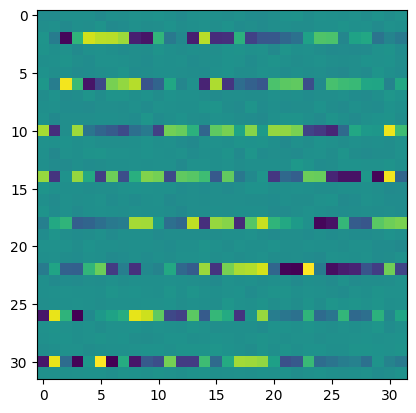

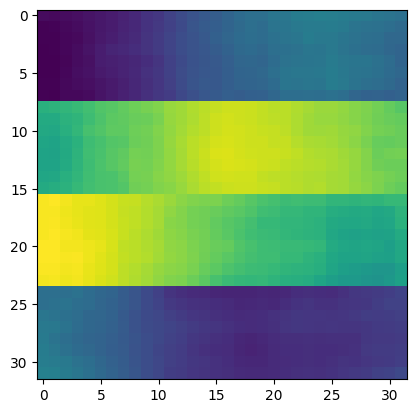

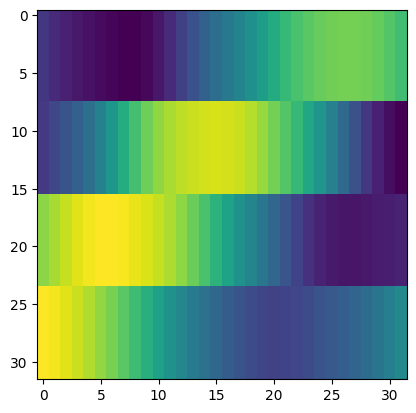

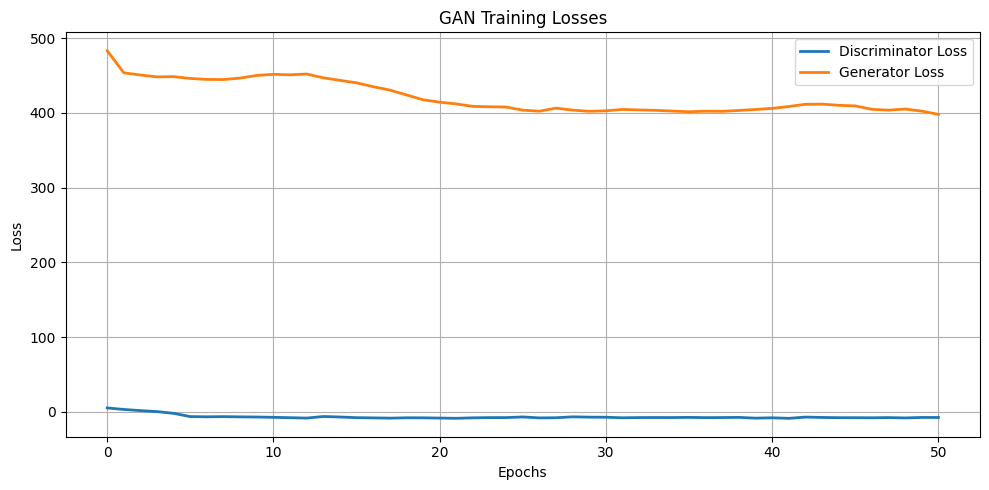

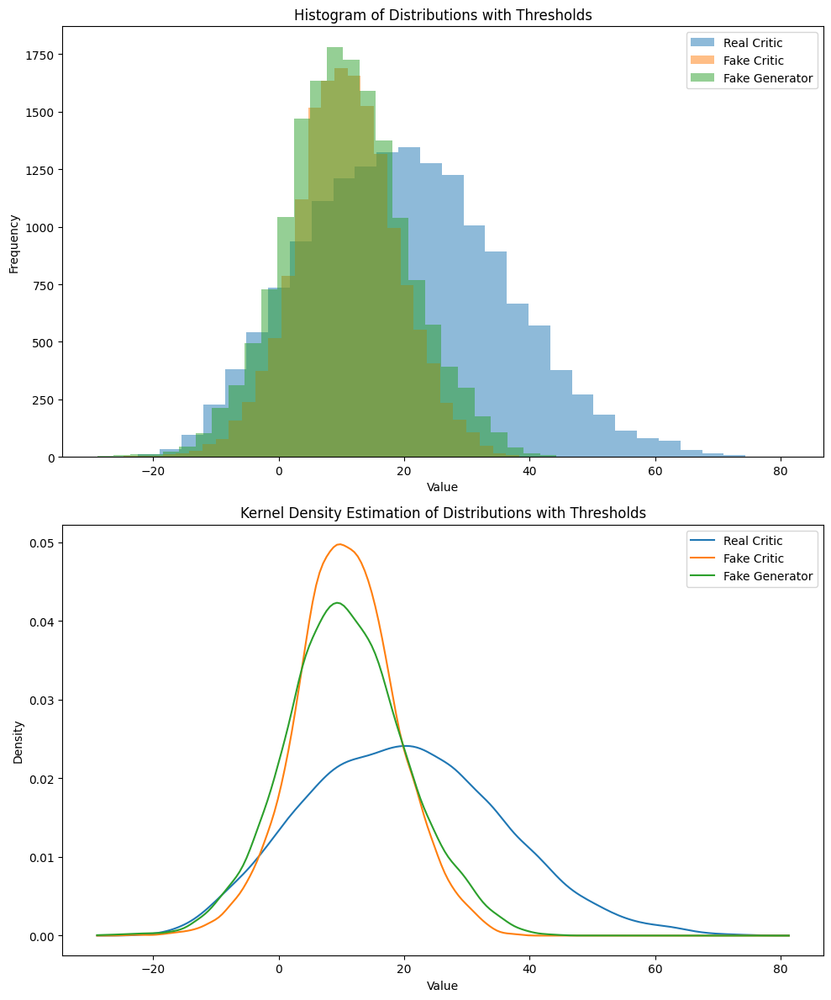

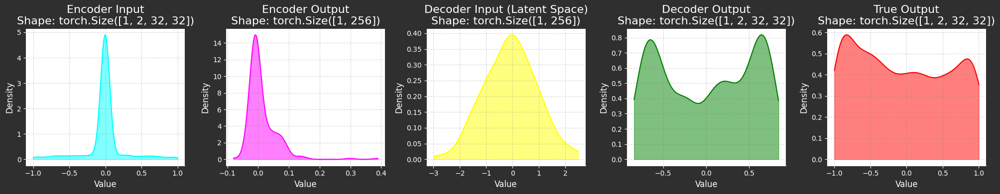

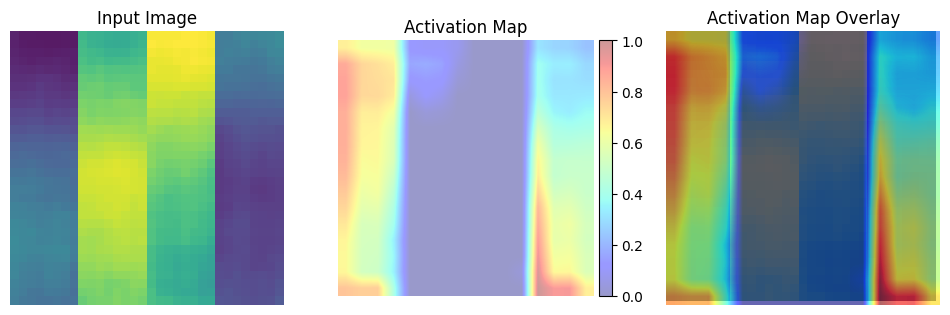

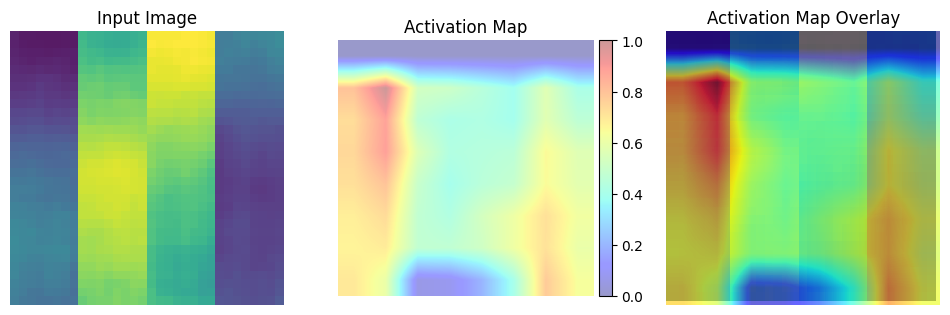

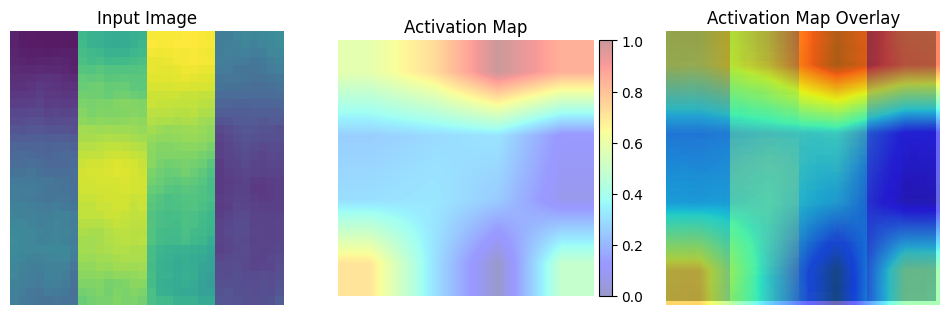

Batch [0/63] -  Critic loss:  -10.133034706115723 - generator loss:  400.45361328125
Batch [21/63] -  Critic loss:  -8.328649513649218 - generator loss:  398.5891959450462
Batch [42/63] -  Critic loss:  -8.556816869927932 - generator loss:  398.7817389909611
	Epoch 51 - critic loss: -8.608363143981453 - generator loss: 397.16003175765746
	MNSE Score: 0.4097277980948251
Batch [0/63] -  Critic loss:  -9.679121017456055 - generator loss:  402.06390380859375
Batch [21/63] -  Critic loss:  -9.351389530933263 - generator loss:  400.9271697998047
Batch [42/63] -  Critic loss:  -9.058149123376655 - generator loss:  400.7473187113917
	Epoch 52 - critic loss: -8.659707577770977 - generator loss: 397.99997965494794
	MNSE Score: 0.4091941988657391
Batch [0/63] -  Critic loss:  -5.912389755249023 - generator loss:  396.3125
Batch [21/63] -  Critic loss:  -7.146467949404862 - generator loss:  398.1882504549894
Batch [42/63] -  Critic loss:  -7.4729311761930015 - generator loss:  399.07893832894257
	

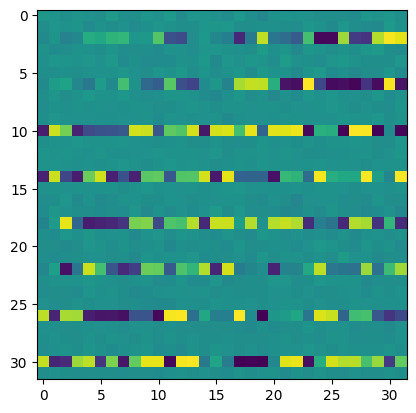

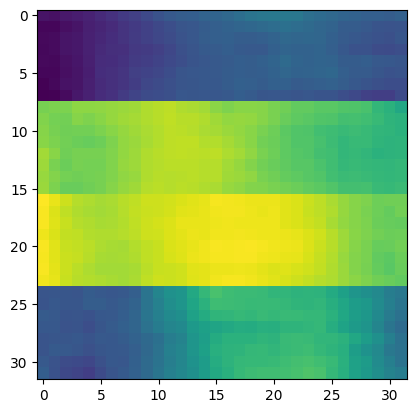

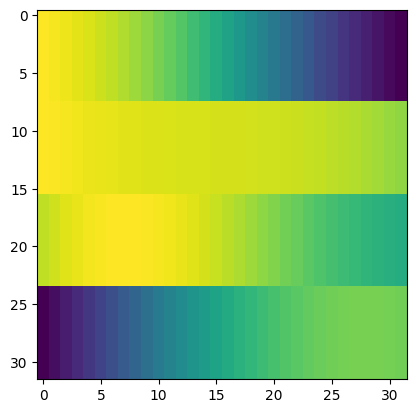

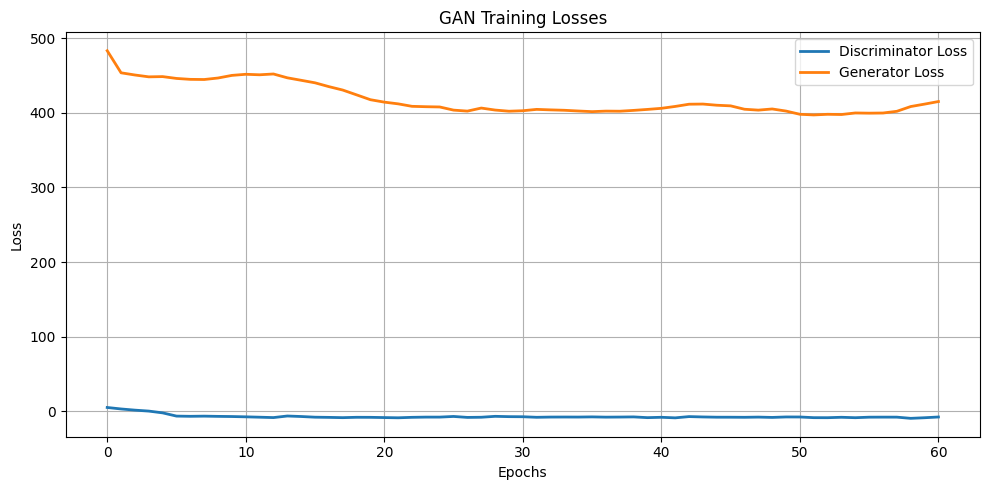

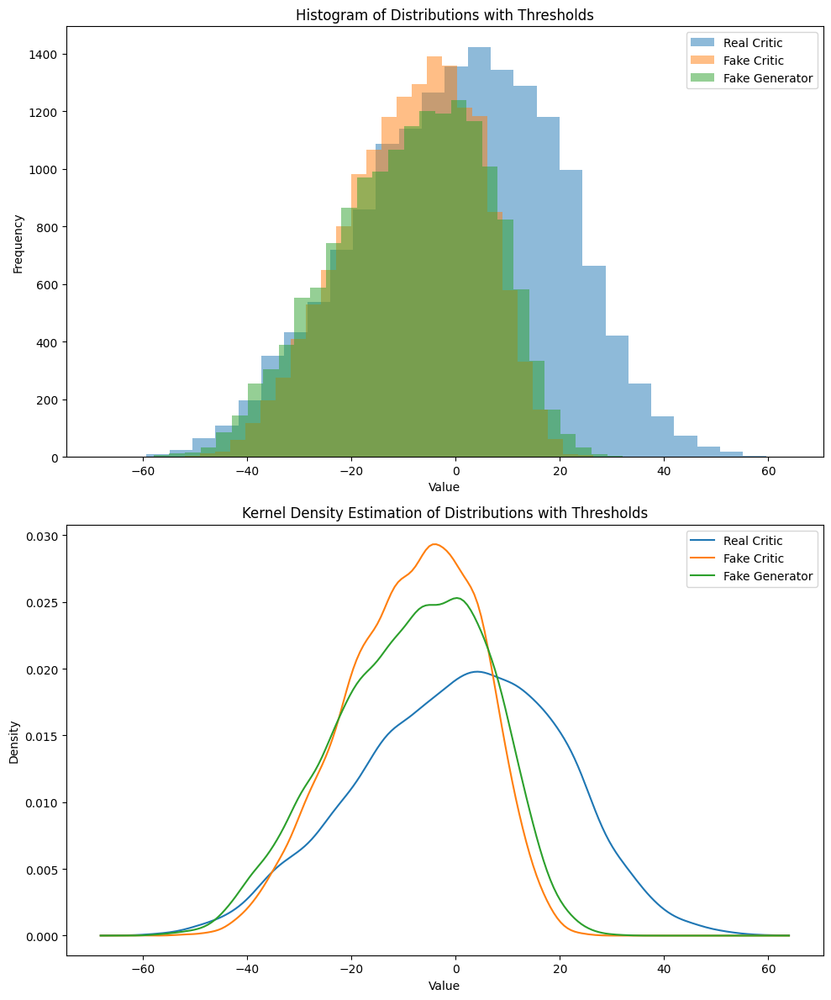

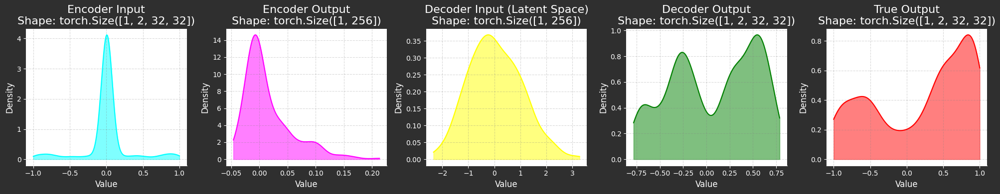

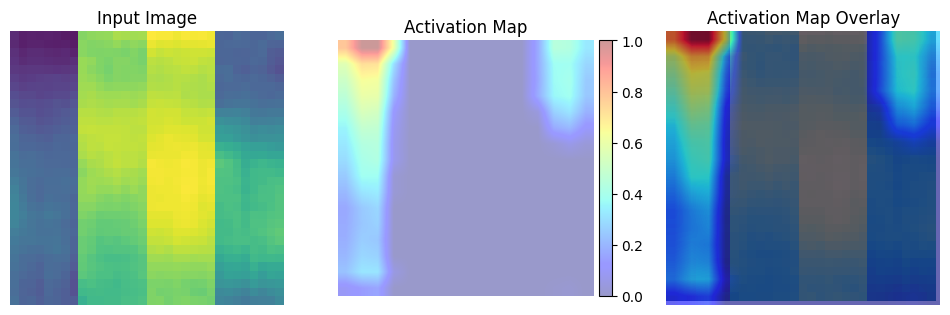

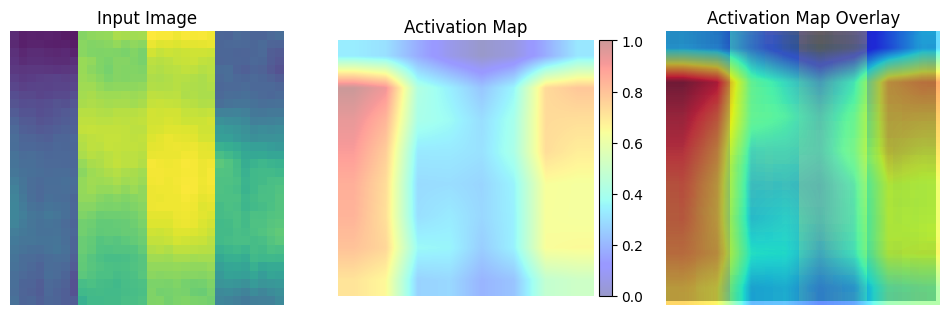

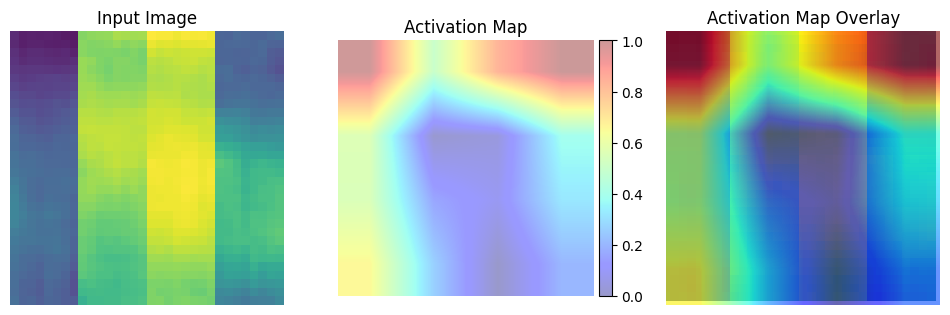

Batch [0/63] -  Critic loss:  -8.757211367289225 - generator loss:  425.7408752441406
Batch [21/63] -  Critic loss:  -8.666962565797748 - generator loss:  421.3745588822798
Batch [42/63] -  Critic loss:  -8.503550647765168 - generator loss:  422.1167254780614
	Epoch 61 - critic loss: -8.54404636413332 - generator loss: 420.400387718564
Batch [0/63] -  Critic loss:  -6.102035204569499 - generator loss:  416.8448181152344
Batch [21/63] -  Critic loss:  -8.241458993969541 - generator loss:  421.2092950994318
Batch [42/63] -  Critic loss:  -8.487753908763562 - generator loss:  422.29352942178417
	Epoch 62 - critic loss: -8.645502801925417 - generator loss: 419.72059461805554
	MNSE Score: 0.4061319525279696
Batch [0/63] -  Critic loss:  -9.533455530802408 - generator loss:  413.21929931640625
Batch [21/63] -  Critic loss:  -9.387676405184196 - generator loss:  421.30661704323506
Batch [42/63] -  Critic loss:  -9.025462815927904 - generator loss:  422.90492425962935
	Epoch 63 - critic loss: 

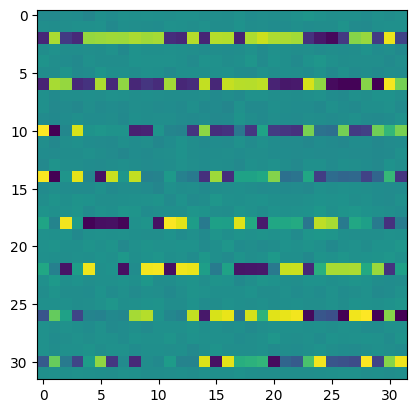

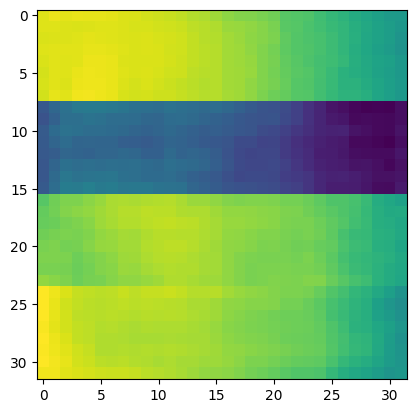

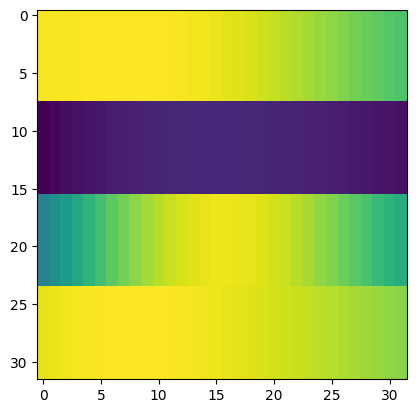

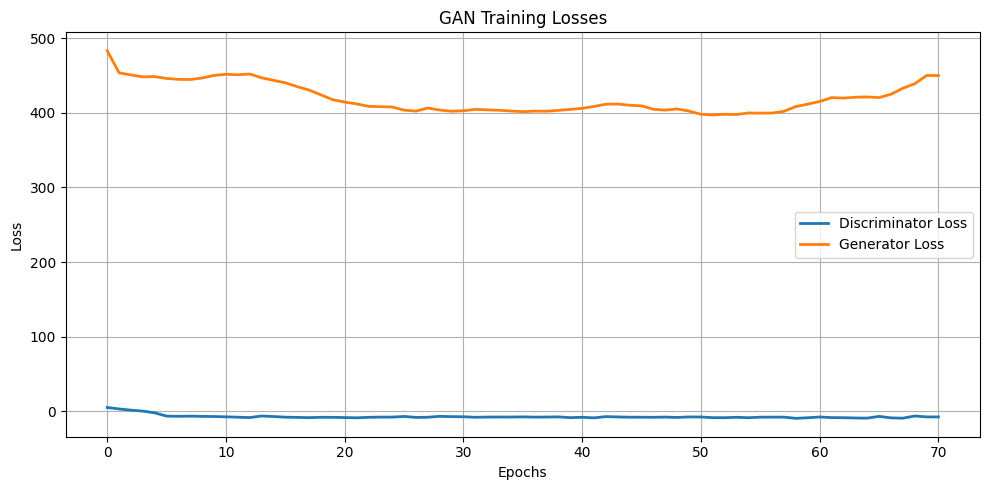

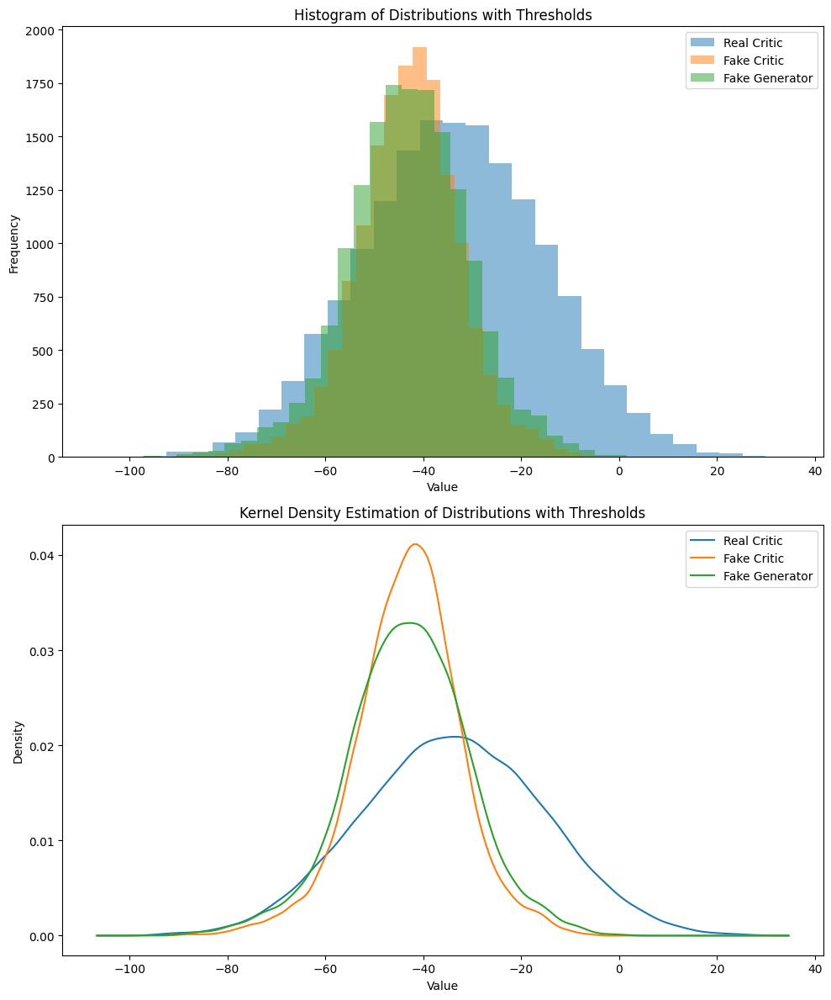

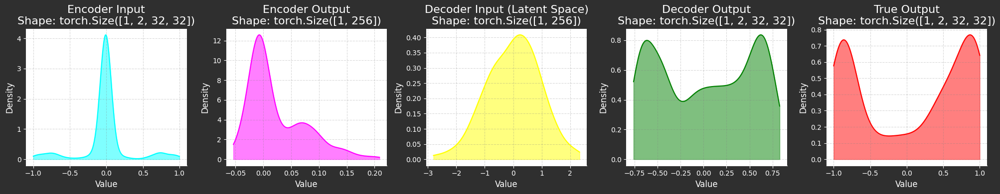

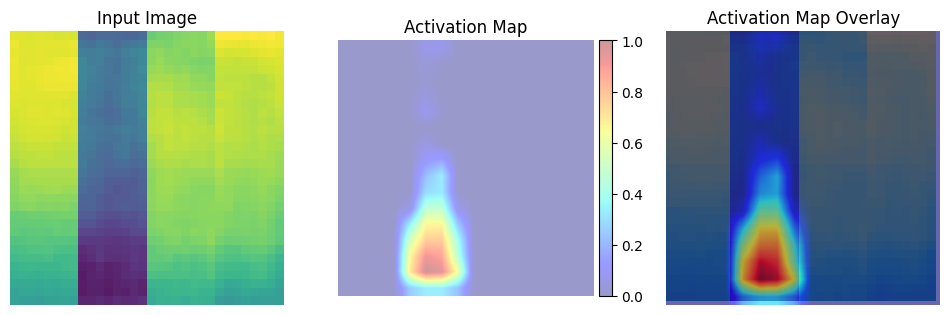

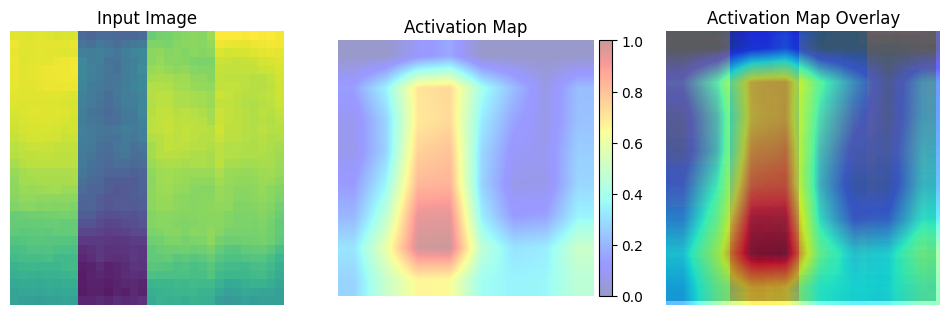

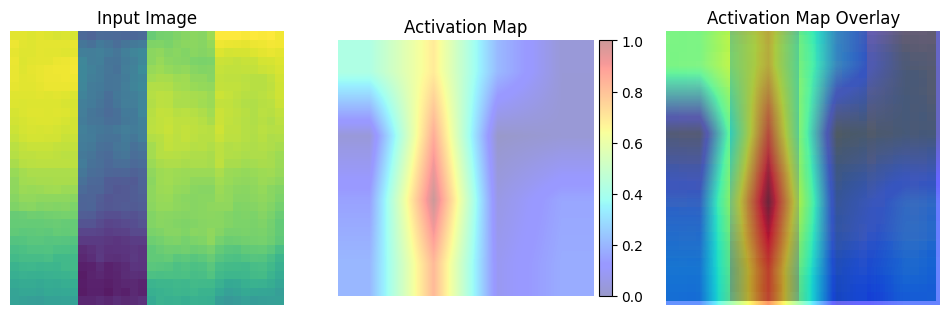

Batch [0/63] -  Critic loss:  -8.314086278279623 - generator loss:  451.6767883300781
Batch [21/63] -  Critic loss:  -8.369374535300516 - generator loss:  451.71969327059657
Batch [42/63] -  Critic loss:  -8.702754848687222 - generator loss:  453.3053134652071
	Epoch 71 - critic loss: -8.498760634629186 - generator loss: 450.9178234281994
	MNSE Score: 0.3993729878039587
Batch [0/63] -  Critic loss:  -7.5452620188395185 - generator loss:  454.03509521484375
Batch [21/63] -  Critic loss:  -6.994077971487334 - generator loss:  454.0116050026634
Batch [42/63] -  Critic loss:  -7.2241252411243515 - generator loss:  453.0350930857104
	Epoch 72 - critic loss: -6.775774943765506 - generator loss: 449.653558640253
Batch [0/63] -  Critic loss:  -6.472204208374023 - generator loss:  443.5023498535156
Batch [21/63] -  Critic loss:  -7.207602804357356 - generator loss:  445.20223582874644
Batch [42/63] -  Critic loss:  -7.557172753090082 - generator loss:  444.4549553449764
	Epoch 73 - critic loss:

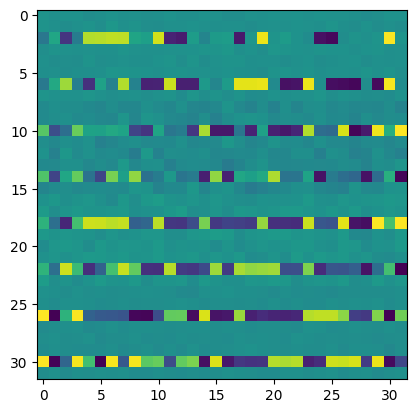

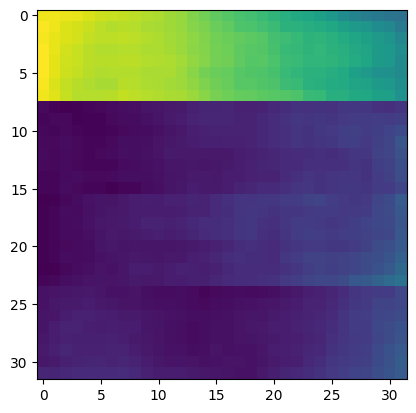

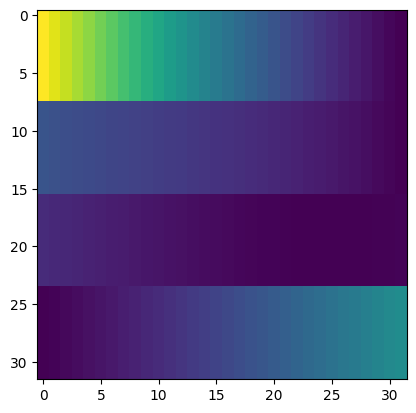

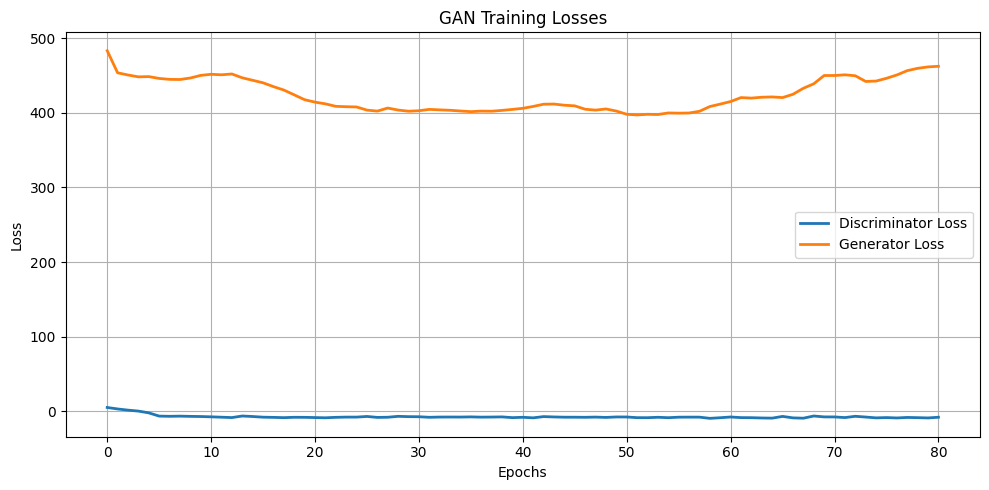

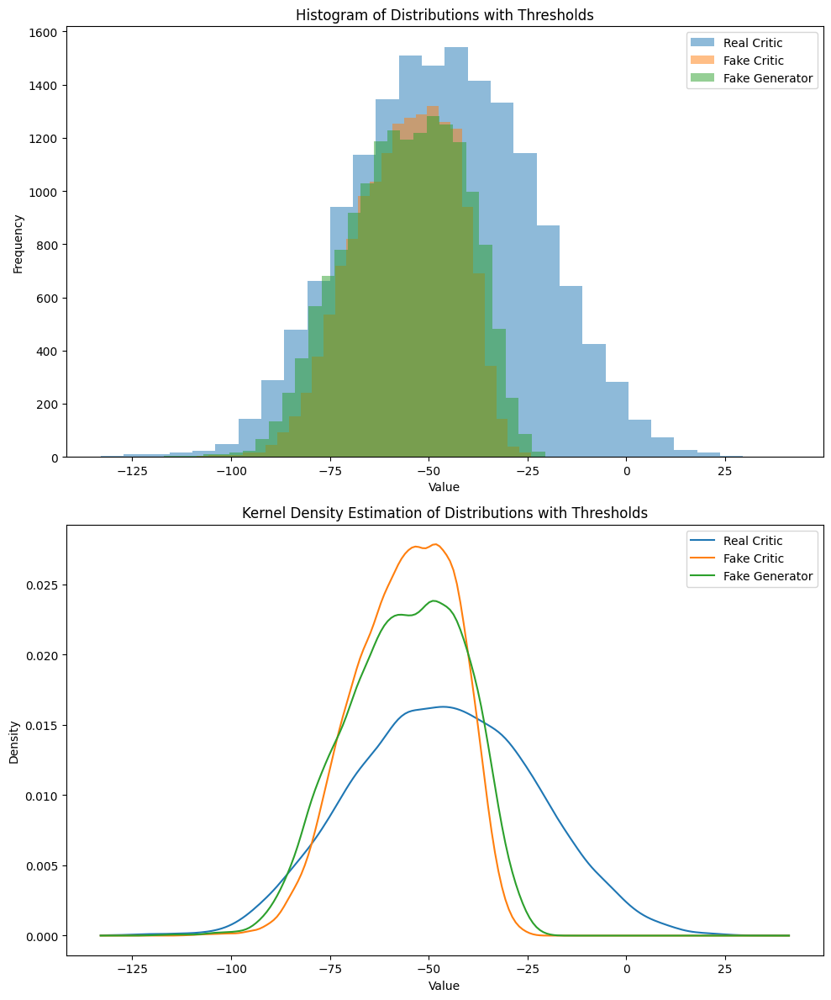

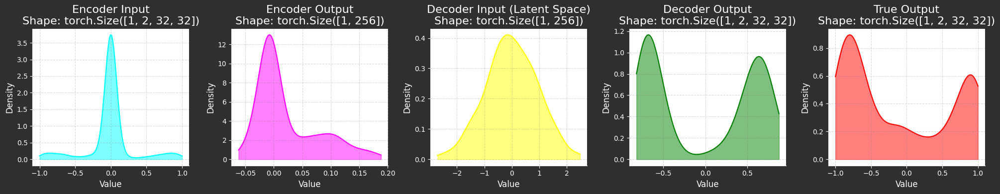

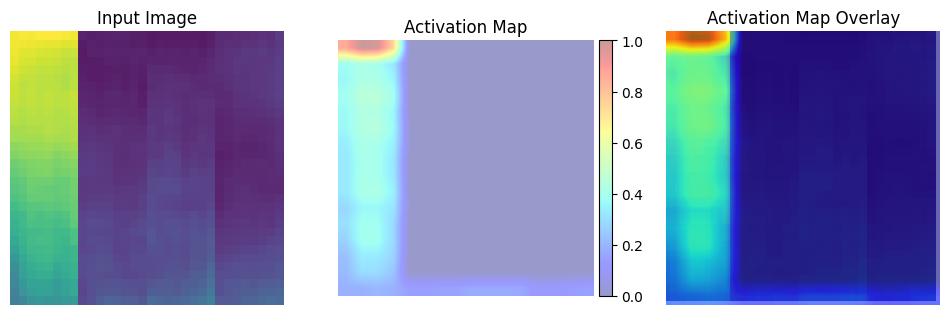

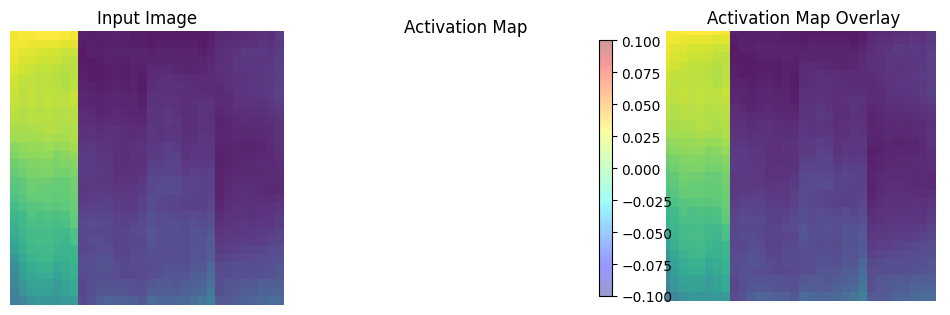

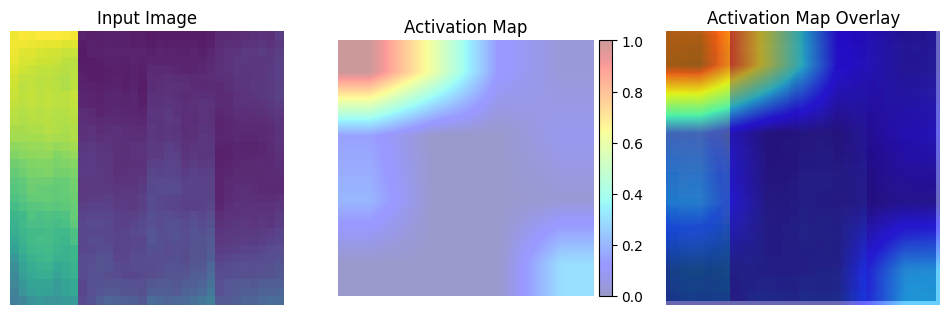

Batch [0/63] -  Critic loss:  -7.405784447987874 - generator loss:  463.598388671875
Batch [21/63] -  Critic loss:  -7.681884079268485 - generator loss:  465.02726329456675
Batch [42/63] -  Critic loss:  -8.279850312905717 - generator loss:  464.3163920557776
	Epoch 81 - critic loss: -8.478817485627674 - generator loss: 462.40868026491194
Batch [0/63] -  Critic loss:  -8.374630769093832 - generator loss:  464.99310302734375
Batch [21/63] -  Critic loss:  -9.17233038671089 - generator loss:  467.55533114346593
Batch [42/63] -  Critic loss:  -8.699603801549868 - generator loss:  467.89660786473473
	Epoch 82 - critic loss: -8.49815619181073 - generator loss: 466.6969493078807
Batch [0/63] -  Critic loss:  -7.079838593800862 - generator loss:  476.3243103027344
Batch [21/63] -  Critic loss:  -8.109482938141536 - generator loss:  474.0082092285156
Batch [42/63] -  Critic loss:  -6.456156157476959 - generator loss:  469.2963434263717
	Epoch 83 - critic loss: -6.49093186398032 - generator los

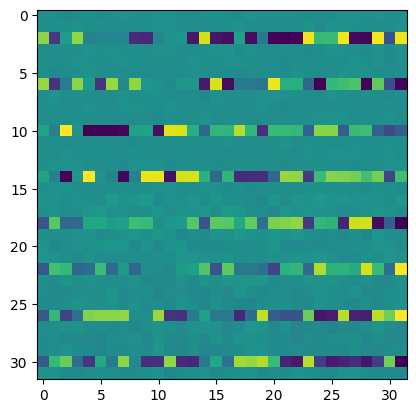

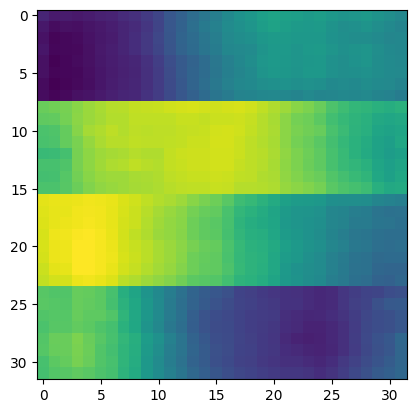

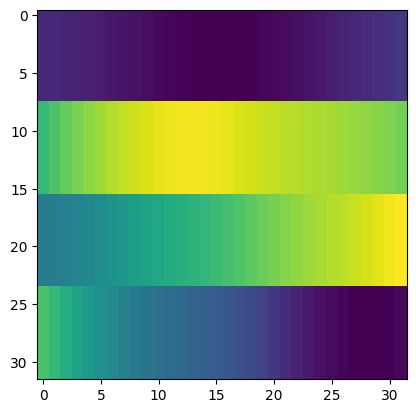

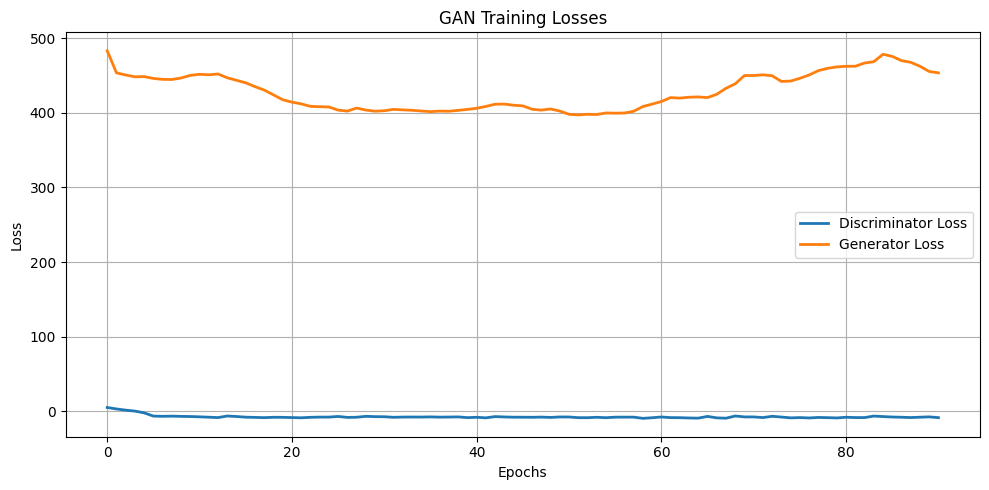

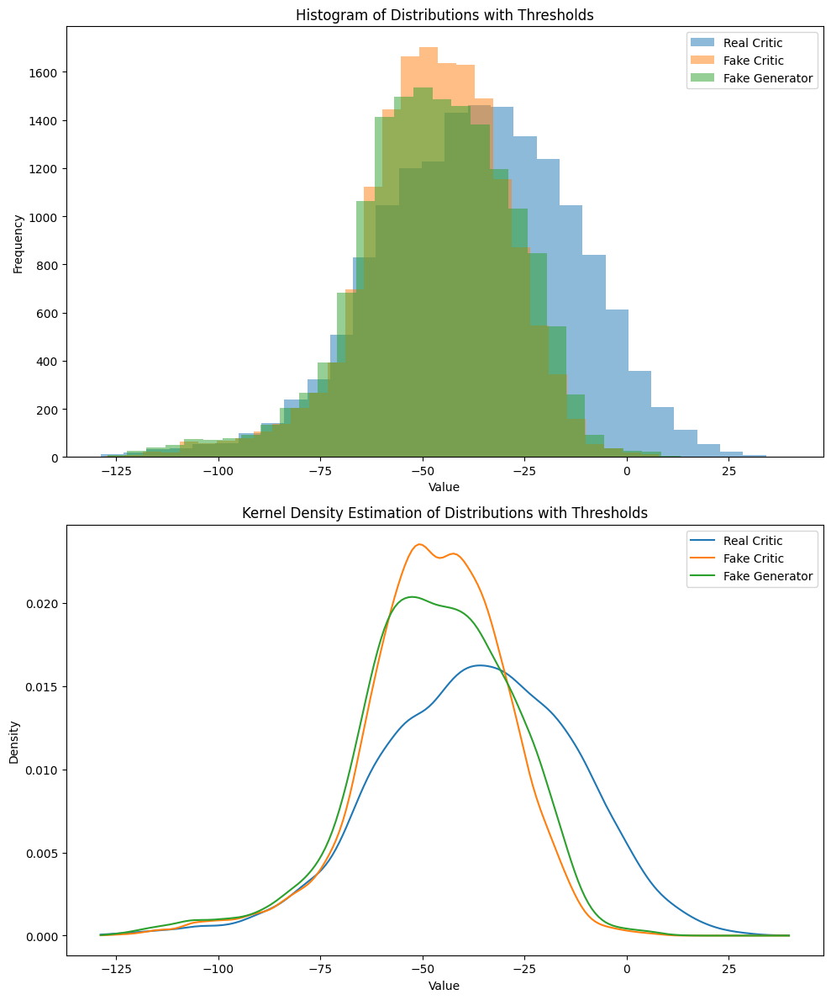

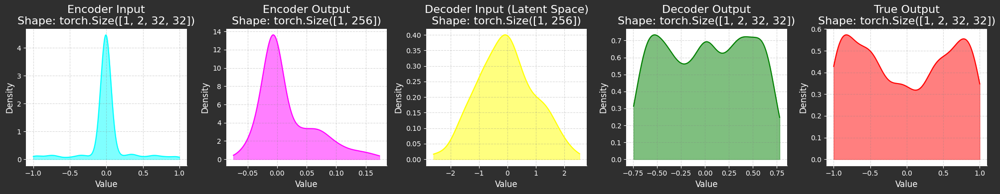

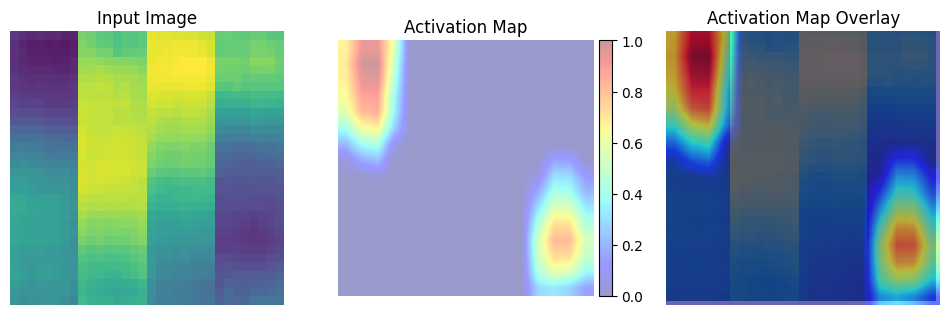

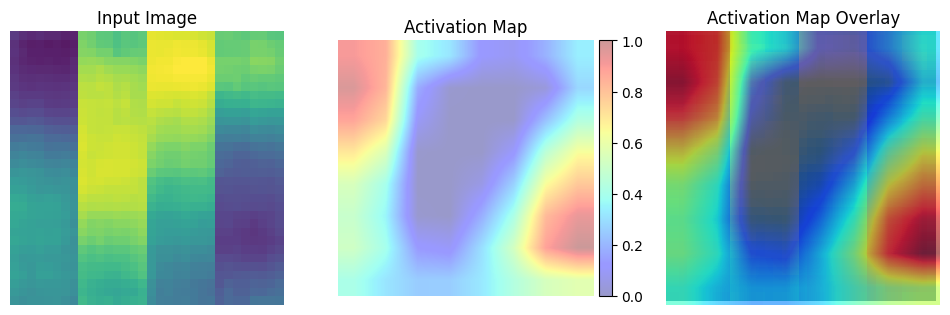

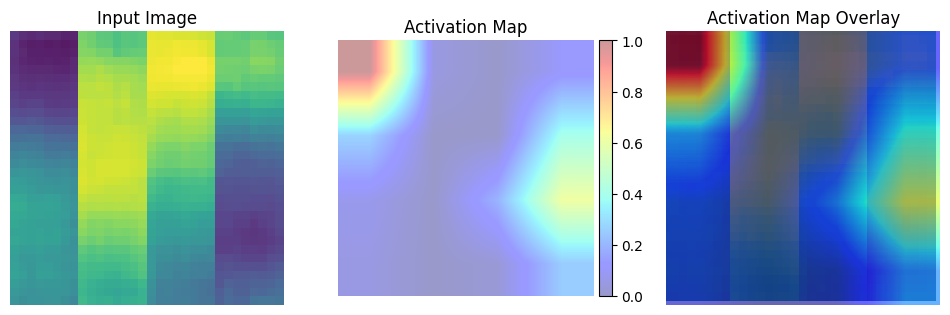

	MNSE Score: 0.39712142707809567
Batch [0/63] -  Critic loss:  -4.877187569936116 - generator loss:  439.39678955078125
Batch [21/63] -  Critic loss:  -8.900904409813158 - generator loss:  451.5898146195845
Batch [42/63] -  Critic loss:  -8.903811800387482 - generator loss:  452.1725925179415
	Epoch 91 - critic loss: -8.812250296274824 - generator loss: 450.1174950978113
	MNSE Score: 0.39565231355409775
Batch [0/63] -  Critic loss:  -4.930843512217204 - generator loss:  441.881591796875
Batch [21/63] -  Critic loss:  -7.720878904516047 - generator loss:  452.0374839089134
Batch [42/63] -  Critic loss:  -7.351177906805231 - generator loss:  449.95281911450763
	Epoch 92 - critic loss: -7.004504604945109 - generator loss: 447.48128691173736
Batch [0/63] -  Critic loss:  -5.8169403076171875 - generator loss:  455.5220642089844
Batch [21/63] -  Critic loss:  -6.597536914276353 - generator loss:  449.6081751043146
Batch [42/63] -  Critic loss:  -6.858932009038998 - generator loss:  449.60199

In [37]:
channel_est_wgan_gp_vae_threwness()

### Inference

#### Test set

In [38]:
def plot_vae_results(labels, reals, fakes, mses, num_samples=8):
    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 4*num_samples))
    fig.suptitle("VAE Results: Label, Real, and Fake", fontsize=16)

    for i in range(num_samples):
        for j, (title, img) in enumerate(zip(['Label', 'Real', 'Fake'], [labels[i], reals[i], fakes[i]])):
            axes[i, j].imshow(img.squeeze().detach().cpu().numpy(), cmap='viridis')
            axes[i, j].set_title(f"{title} (Sample {i+1})")
            axes[i, j].axis('off')

        # Add MSE text to the right of the fake image
        axes[i, 2].text(1.05, 0.5, f'MSE: {mses[i]:.4f}',
                        transform=axes[i, 2].transAxes,
                        verticalalignment='center')

<ipython-input-39-b03b6cefc975>:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(


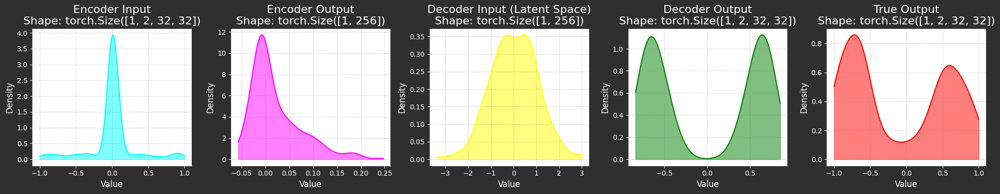

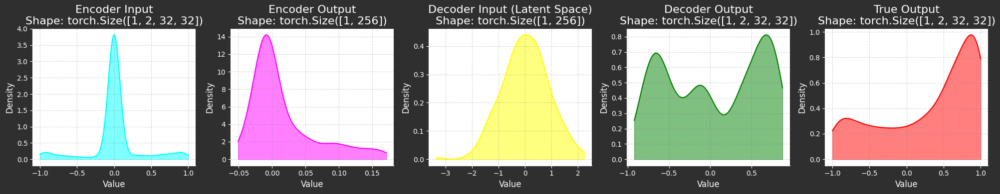

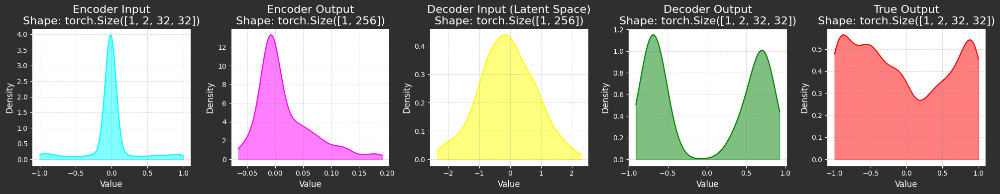

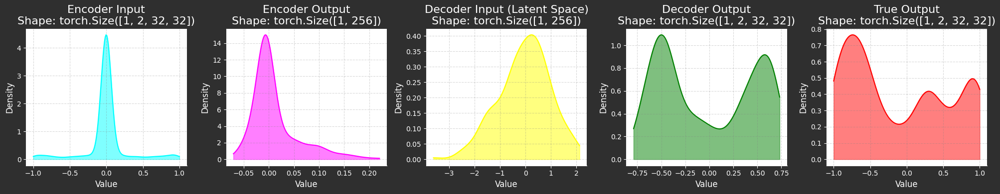

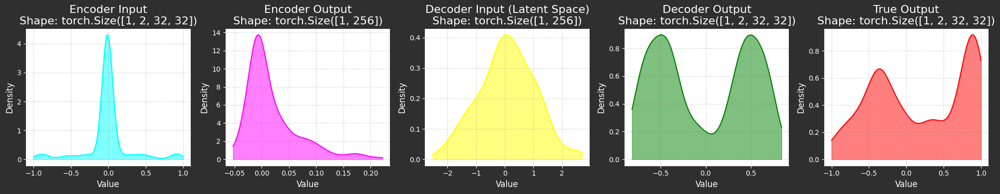

...

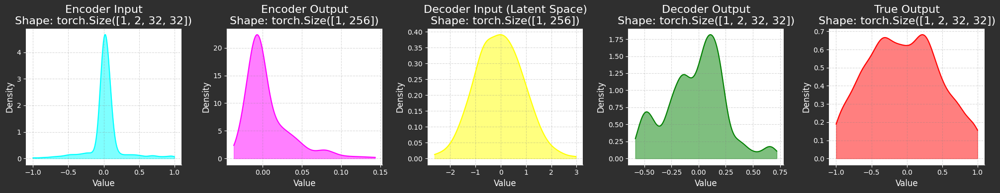

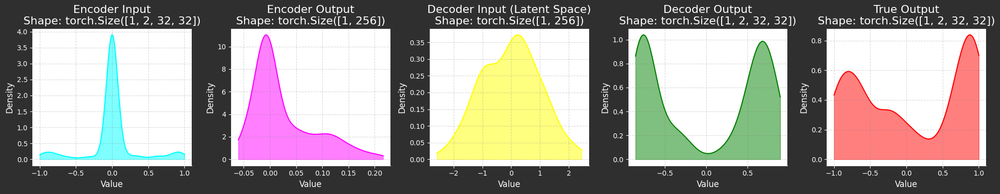

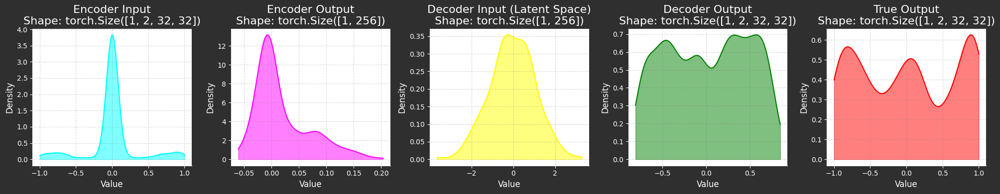

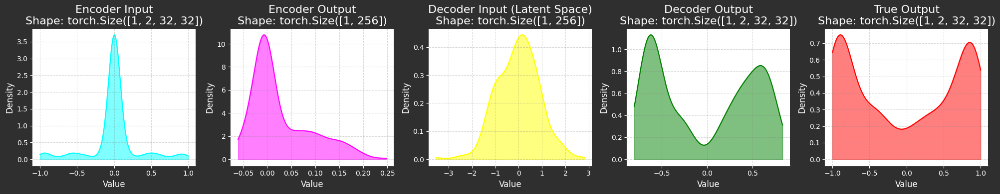

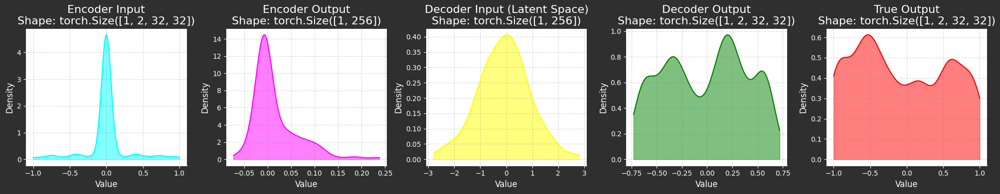

0.4234527110820636


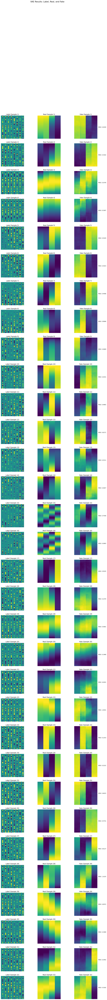

In [39]:
num_samples = 32
labels, reals, fakes, nmses = [], [], [], []

vae = VAE(z_dim=z_dim).to(device)
checkpoint = torch.load(
    f"/content/results/checkpoint/{save_results}/g_model.pt",
    map_location=device,
)
vae.load_state_dict(checkpoint["state_dict"])

vae = vae.to(device)
vae.eval()

dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=1
)
test_dataset = dataloader.test_dataloader()

for i, (real, label) in enumerate(test_dataset):
    real = real.to(device)
    label = label.to(device)
    fake, *values = vae(label)
    _, _, (input_decoder, output_encoder) = values

    if i >= num_samples:
        break

    labels.append(label[0])
    reals.append(real[0])
    fakes.append(fake[0])
    nmses.append(nmse_func(fake, real))

    plot_vae_in_out(label, fake, input_decoder, output_encoder, real)


# Convert lists to tensors
labels = torch.cat(labels, dim=0)
reals = torch.cat(reals, dim=0)
fakes = torch.cat(fakes, dim=0)

print(np.mean(nmses))
plot_vae_results(labels, reals, fakes, nmses, num_samples)



#### Training sets

<ipython-input-40-136a2bebcb14>:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(


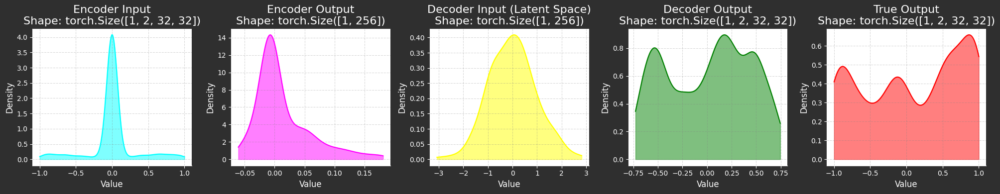

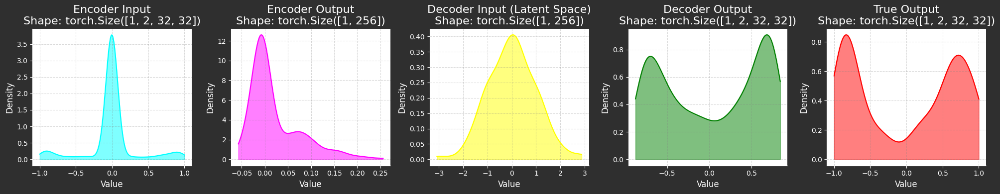

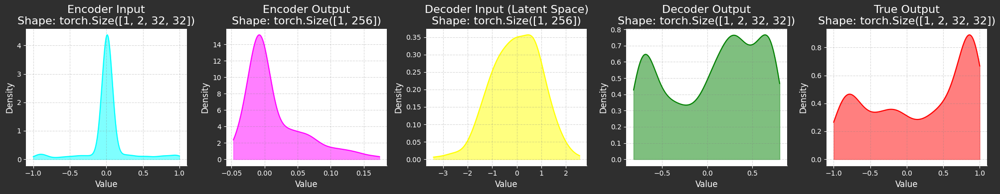

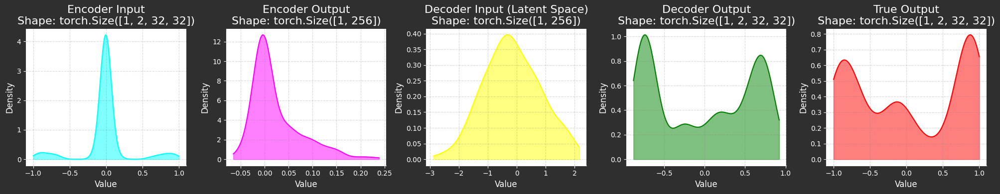

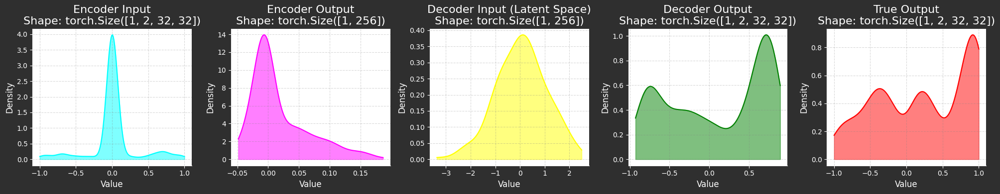

...

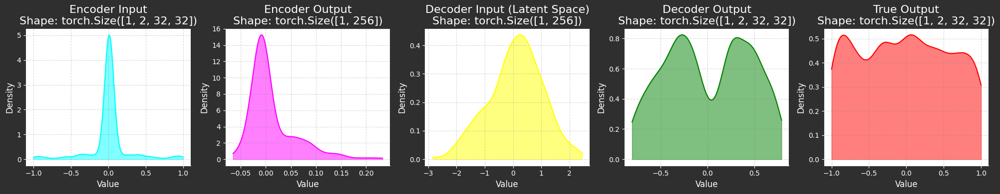

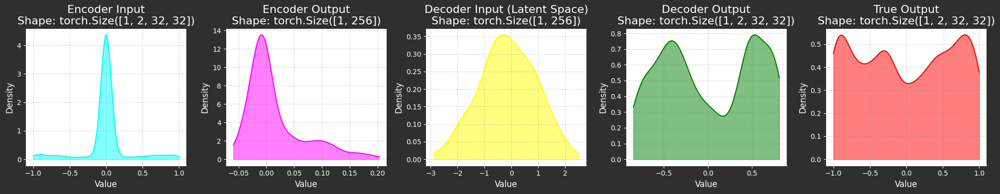

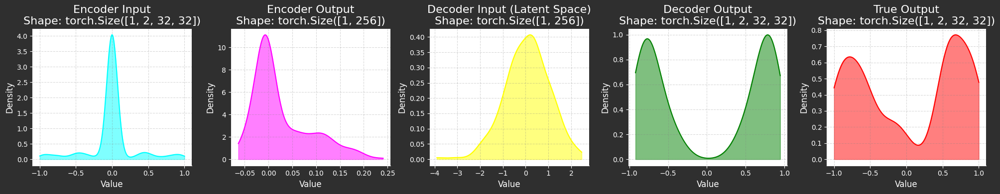

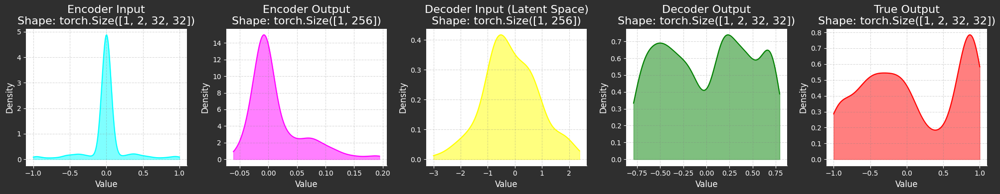

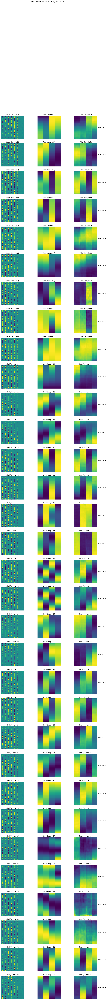

In [40]:
num_samples = 32
labels, reals, fakes, nmses = [], [], [], []

vae = VAE(z_dim=z_dim).to(device)
checkpoint = torch.load(
    f"/content/results/checkpoint/{save_results}/g_model.pt",
    map_location=device,
)
vae.load_state_dict(checkpoint["state_dict"])

vae = vae.to(device)
vae.eval()

dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=1
)
train_dataset = dataloader.train_dataloader()

for i, (real, label) in enumerate(train_dataset):
    real = real.to(device)
    label = label.to(device)
    fake, *values = vae(label)
    _, _, (input_decoder, output_encoder) = values

    if i >= num_samples:
        break

    labels.append(label[0])
    reals.append(real[0])
    fakes.append(fake[0])
    nmses.append(nmse_func(fake, real))

    plot_vae_in_out(label, fake, input_decoder, output_encoder, real)

# Convert lists to tensors
labels = torch.cat(labels, dim=0)
reals = torch.cat(reals, dim=0)
fakes = torch.cat(fakes, dim=0)

plot_vae_results(labels, reals, fakes, nmses, num_samples)
